# Importing Libraries and datasets

Importing all necessary libraries that we are going to use during the "store" data analysis and forecasting. Also setting the parameters related to quality of graph display.

In [89]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import seaborn as sns
#import plotly.express as px
from math import sqrt
from sklearn.metrics import mean_squared_error
from fbprophet import Prophet
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
from fbprophet.diagnostics import performance_metrics
from fbprophet.diagnostics import cross_validation

sns.set(rc={"figure.dpi":300, 'savefig.dpi':300})
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
pd.set_option('display.max_columns',15)

- Pandas, numpy, datetime will be used to analyse our dataset. We are importing pandas as pd, and numpy as np.

- Matplotlib.pyplot, ploty.express, and seaborn will be used to plot graph. We are importing matplotlib.pyplot as plt and seaborn as sns.

- Math, sqrt metrics, and mean_squared_error will be use in evaluation of our model.

- Seasonal decompose will be used to observe seasonality and SARIMAX will be used to forecast future sales.

- pd.set_option('display.max_columns',15) : It is used to set maximum number of column to display.

- sns.set(rc={"figure.dpi":300, 'savefig.dpi':300}) : It is used to display seaborn graph with resolution of 300 dpi.

- plt.rcParams['figure.dpi'] = 300 : It is used to display matplotlib graph with resolution of 300 dpi.

- plt.rcParams['savefig.dpi'] = 300 : It is used to save matplotlib graph with resolution of 300 dpi.


In [4]:
df = pd.read_excel("store.xlsx")

We are assigning our dataset a variable with name ‘df’. As our ‘store’ dataset is in ‘.xlsx’, we are using read_excel.

# Exploratory analysis

## Data cleaning and arranging data properly

In [5]:
df.head()

,Store,Product,Date,Is_Holiday,Base Price,Price,Weekly_Units_Sold
0,1,1,2010-05-02 00:00:00,False,9.99,7.99,245
1,1,1,2010-12-02 00:00:00,True,9.99,7.99,453
2,1,1,2/19/2010,False,9.99,7.99,409
3,1,1,2/26/2010,False,9.99,7.99,191
4,1,1,2010-05-03 00:00:00,False,9.99,9.99,145


In [6]:
print("Checking dtype and number of non-null values\n")
print(df.info())
print("\n\nChecking that dataset contains any null value by using 'isnull' function")
print(df.isnull().sum())

Checking dtype and number of non-null values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3861 entries, 0 to 3860
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Store              3861 non-null   int64  
 1   Product            3861 non-null   int64  
 2   Date               3861 non-null   object 
 3   Is_Holiday         3861 non-null   bool   
 4   Base Price         3861 non-null   float64
 5   Price              3861 non-null   float64
 6   Weekly_Units_Sold  3861 non-null   int64  
dtypes: bool(1), float64(2), int64(3), object(1)
memory usage: 184.9+ KB
None


Checking that dataset contains any null value by using 'isnull' function
Store                0
Product              0
Date                 0
Is_Holiday           0
Base Price           0
Price                0
Weekly_Units_Sold    0
dtype: int64


- df.head() : It shows first five rows of df.
    
- df.info() : It shows number of non-null elements of each column. Also showing data types of each column. ‘Date’ column is of object dtype. We should convert it into datetime dtype. We will do this in next code.

- df.isnull() : It shows number of null values in each column.

**There was no null values in our dataset**

In [7]:
df['Sales'] = df['Price']*df['Weekly_Units_Sold']   #Adding Weekly sales column

df['Date'] = pd.to_datetime(df['Date'])                    #Changing dtype of 'Date' from object to datetime
df.set_index('Date', inplace=True)                         #Setting index as Date column

df['year'] = df.index.year                                 #Adding year column
df['month'] = df.index.month                               #Adding month column
df['day'] = df.index.day                                   #Adding day column
df['week_of_year'] = df.index.weekofyear                   #Adding week column

df.head()

C:\Users\Anuj\AppData\Local\Temp/ipykernel_12664/1519536339.py:9: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  df['week_of_year'] = df.index.weekofyear                   #Adding week column


,Store,Product,Is_Holiday,Base Price,Price,Weekly_Units_Sold,Sales,year,month,day,week_of_year
Date,,,,,,,,,,,
2010-05-02,1,1,False,9.99,7.99,245,1957.55,2010,5,2,17
2010-12-02,1,1,True,9.99,7.99,453,3619.47,2010,12,2,48
2010-02-19,1,1,False,9.99,7.99,409,3267.91,2010,2,19,7
2010-02-26,1,1,False,9.99,7.99,191,1526.09,2010,2,26,8
2010-05-03,1,1,False,9.99,9.99,145,1448.55,2010,5,3,18


- df['Sales'] = df['Price']*df['Weekly_Units_Sold'] : Adding a new column with name ‘Sales’. It is creating by multiplying ‘Price’ column with ‘Weekly_Units_Sold’.
    
- df['Date'] = pd.to_datetime(df['Date']) : As ‘Date’ column has object dtype as observed in last code so we are converting it in datetime dtype here.
    
- df.set_index('Date', inplace=True) : Making ‘Date’ column as index column.
    
- df['year'] = df.index.year : Creating a new column with name ‘year’. It consist of year of each row.
    
- df['month'] = df.index.month : Creating a new column with name ‘month’. It consist of month of each row.
    
- df['day'] = df.index.day : Creating a new column with name ‘day’. It consist of day of each row.
    
- df['week_of_year'] = df.index.weekofyear : Creating a new column with name ‘week_of_year’. It consist of week number of each row.
    
- After doing all this, we are print first five rows of our updated dataset.

- We are seperating day, month, year, and week. We made different column for each.

In [8]:
def f(d):
    if d['Base Price'] == d['Price']:
        x = 0
    elif d['Base Price'] > d['Price']:
        x = 1
    else:
        x = -1
    return x

df['promotion'] = df.apply(f, axis=1)

df.head()

,Store,Product,Is_Holiday,Base Price,Price,Weekly_Units_Sold,Sales,year,month,day,week_of_year,promotion
Date,,,,,,,,,,,,
2010-05-02,1,1,False,9.99,7.99,245,1957.55,2010,5,2,17,1
2010-12-02,1,1,True,9.99,7.99,453,3619.47,2010,12,2,48,1
2010-02-19,1,1,False,9.99,7.99,409,3267.91,2010,2,19,7,1
2010-02-26,1,1,False,9.99,7.99,191,1526.09,2010,2,26,8,1
2010-05-03,1,1,False,9.99,9.99,145,1448.55,2010,5,3,18,0


- We are making a new column with name ‘promotion’. We are making this column by using def in python where we are defining a new function in which if base price is equal to price (selling price) then we allot ‘0’ in promotion column’s row. If base price is less than price (selling price) then we allotting ‘1’. In any other case, we are allotting ‘-1’.

- I made a new column name "promotion". 1 indicates that product was sold by applying promotion while 0 indicates no promotion.

In [9]:
df.reset_index(inplace=True)
print(df.columns)

Index(['Date', 'Store', 'Product', 'Is_Holiday', 'Base Price', 'Price',
       'Weekly_Units_Sold', 'Sales', 'year', 'month', 'day', 'week_of_year',
       'promotion'],
      dtype='object')


- We are resetting index here, and then checking the name of all column.

- The reason for resetting index is that I want to add "Date" column in df.

# Exploring data

In [10]:
x=list(df.week_of_year.unique())
x.sort()
print("Weeks in datasets",x, "\n\n")
print("Total number of weeks:", len(x), "\n\n")

print(df.week_of_year.value_counts())        #Checking number of occurance

Weeks in datasets [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52] 


Total number of weeks: 52 


17    108
41    108
19    108
37    108
28    108
1     108
15    108
42     81
38     81
43     81
50     81
40     81
13     81
10     81
33     81
32     81
23     81
30     81
29     81
34     81
36     81
7      81
24     81
44     81
21     81
8      81
20     81
16     81
25     81
5      81
12     81
11     81
3      54
4      54
22     54
31     54
26     54
9      54
6      54
39     54
2      54
46     54
52     54
51     54
47     54
49     54
18     54
35     54
27     54
48     54
14     54
45     54
Name: week_of_year, dtype: int64


- Total number of weeks is 52

• Here, we are checking that week number occurs how many times. As we can observe that, each week number has different number of occurrence in dataset which means that our dataset has data of more than one year and starting date (first date in our dataset) is inbetween of a year.

In [11]:
print(df.Store.value_counts(), "\n\n")                  #Checking whether all store occurance number is same
print(df.groupby(['Store','Product']).size())           #Checking the number of store and product occurance

1     429
2     429
3     429
4     429
5     429
6     429
7     429
8     429
10    429
Name: Store, dtype: int64 


Store  Product
1      1          143
       2          143
       3          143
2      1          143
       2          143
       3          143
3      1          143
       2          143
       3          143
4      1          143
       2          143
       3          143
5      1          143
       2          143
       3          143
6      1          143
       2          143
       3          143
7      1          143
       2          143
       3          143
8      1          143
       2          143
       3          143
10     1          143
       2          143
       3          143
dtype: int64


• Here, we are checking number of occurrence of each store in our dataset. Also checking same thing as product wise (product wise of each store). We can observe that all occur same number of times in our dataset.

In [15]:
df.head()

,Date,Store,Product,Is_Holiday,Base Price,Price,Weekly_Units_Sold,Sales,year,month,day,week_of_year,promotion
0,2010-05-02,1,1,False,9.99,7.99,245,1957.55,2010,5,2,17,1
1,2010-12-02,1,1,True,9.99,7.99,453,3619.47,2010,12,2,48,1
2,2010-02-19,1,1,False,9.99,7.99,409,3267.91,2010,2,19,7,1
3,2010-02-26,1,1,False,9.99,7.99,191,1526.09,2010,2,26,8,1
4,2010-05-03,1,1,False,9.99,9.99,145,1448.55,2010,5,3,18,0


<AxesSubplot:>

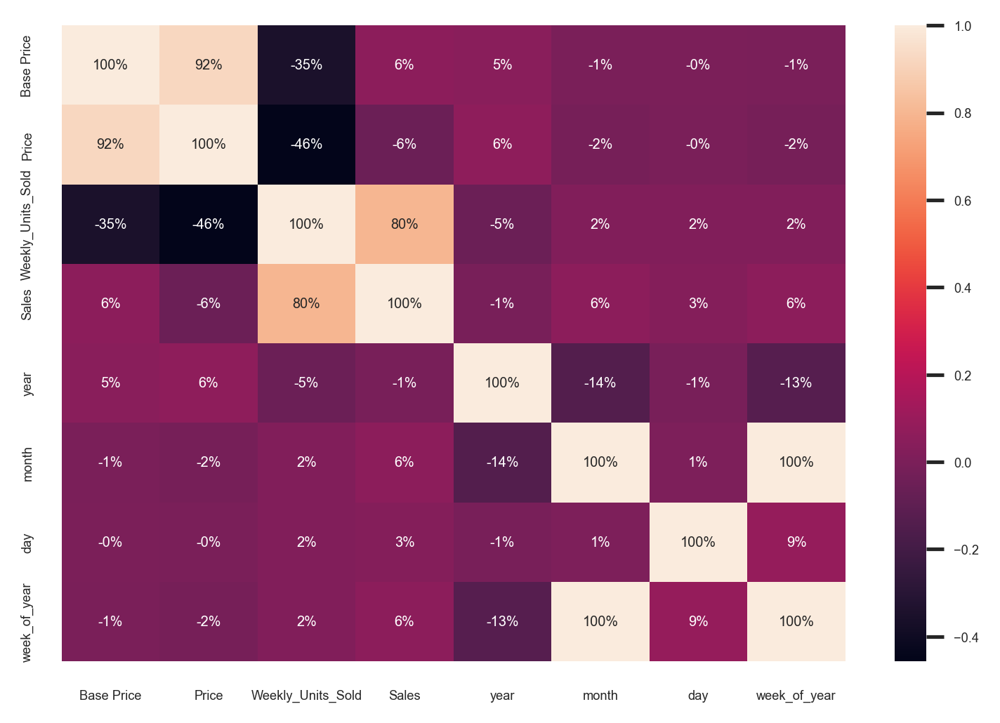

In [17]:
sns.set(font_scale=0.4)
sns.heatmap(df.drop(["Date","Store","Product","Is_Holiday","promotion"], axis=1).corr(), annot=True, fmt = '.0%')

**Observations:**
Base Price and Price are highly correlated. Similarly Weekly Unit Sold and Weekly Sales (i.e. "Sales") are also correlated highly. These correlation are obvious.

In [18]:
df.columns

Index(['Date', 'Store', 'Product', 'Is_Holiday', 'Base Price', 'Price',
       'Weekly_Units_Sold', 'Sales', 'year', 'month', 'day', 'week_of_year',
       'promotion'],
      dtype='object')

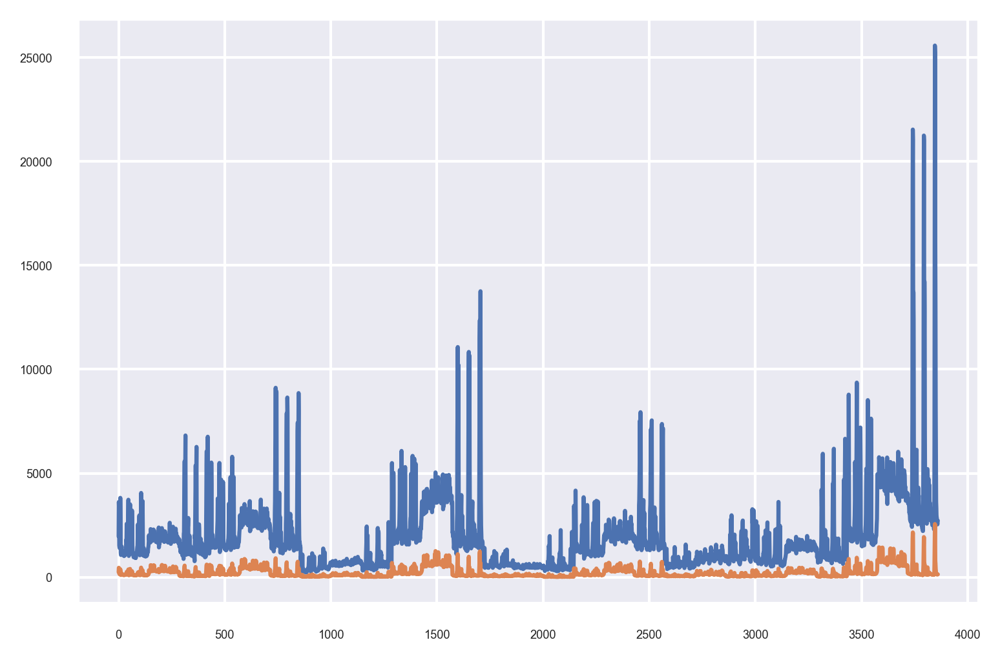

In [19]:
plt.plot(df["Sales"])
plt.plot(df["Weekly_Units_Sold"])
plt.show()

**Observations:**
We can conclude that Weekly_units_sold is highly correlated with weekly_sales

# Monthly Sales and Unit Sold (Store and Product wise, seperately + combinely) in 2010, 2011, and 2012

## Monthly Sales (Store wise) in 2010, 2011, and 2012

In [11]:
df1 = df.groupby(['year','Store','month']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
df1.year.value_counts()

2010    108
2011    108
2012    108
Name: year, dtype: int64

In [12]:
df1

,year,Store,month,Sales
0,2010,1,1,4464.96
1,2010,1,2,24592.18
2,2010,1,3,19516.98
3,2010,1,4,17760.34
4,2010,1,5,29941.12
...,...,...,...,...
319,2012,10,8,42843.65
320,2012,10,9,35662.82
321,2012,10,10,50585.54
322,2012,10,11,8709.73


### Monthly Sales (Store wise) in 2010

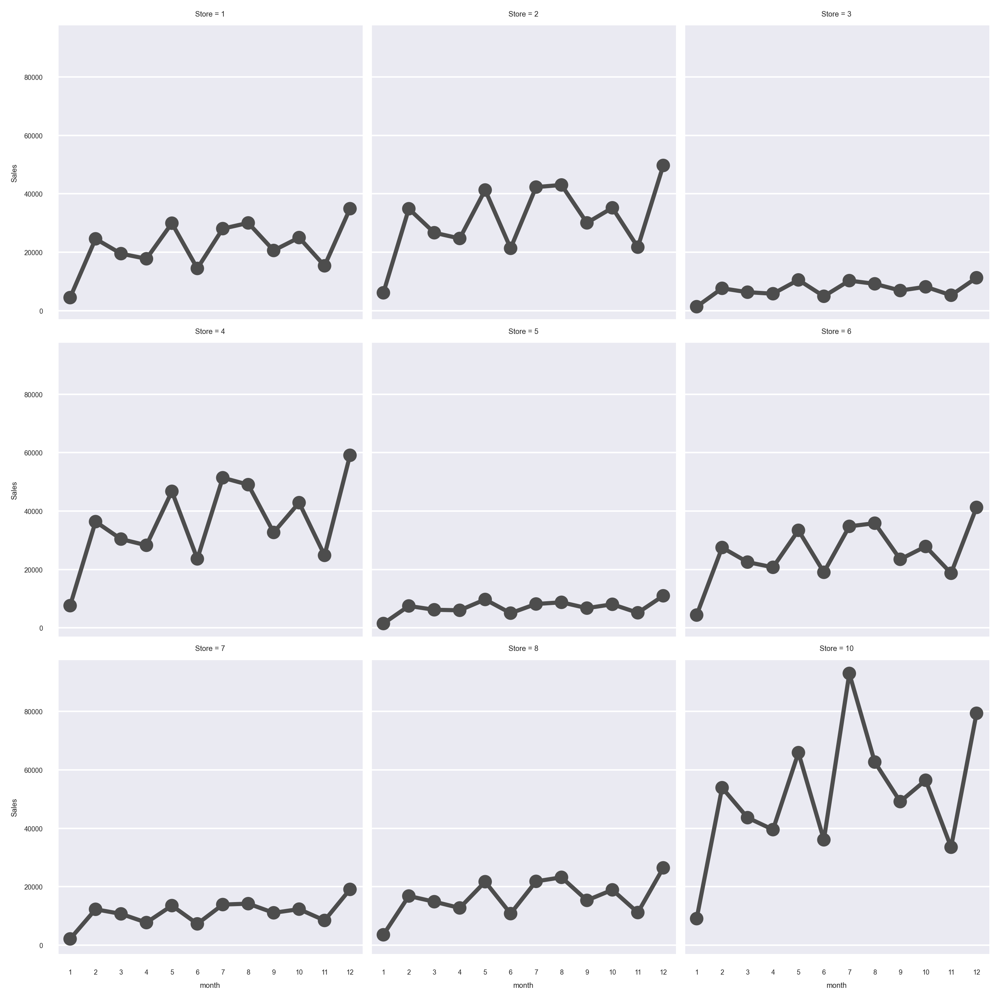

In [13]:
g = sns.FacetGrid(df1.iloc[0:108], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
Monthly Sales of store 3,5, and 7 are quite low than others. While Monthly Sales of Store 10 is higher than others especially in month 7. In 2010, highest sales is from store 10 in 7th month.

### Monthly Sales (Store wise) in 2011

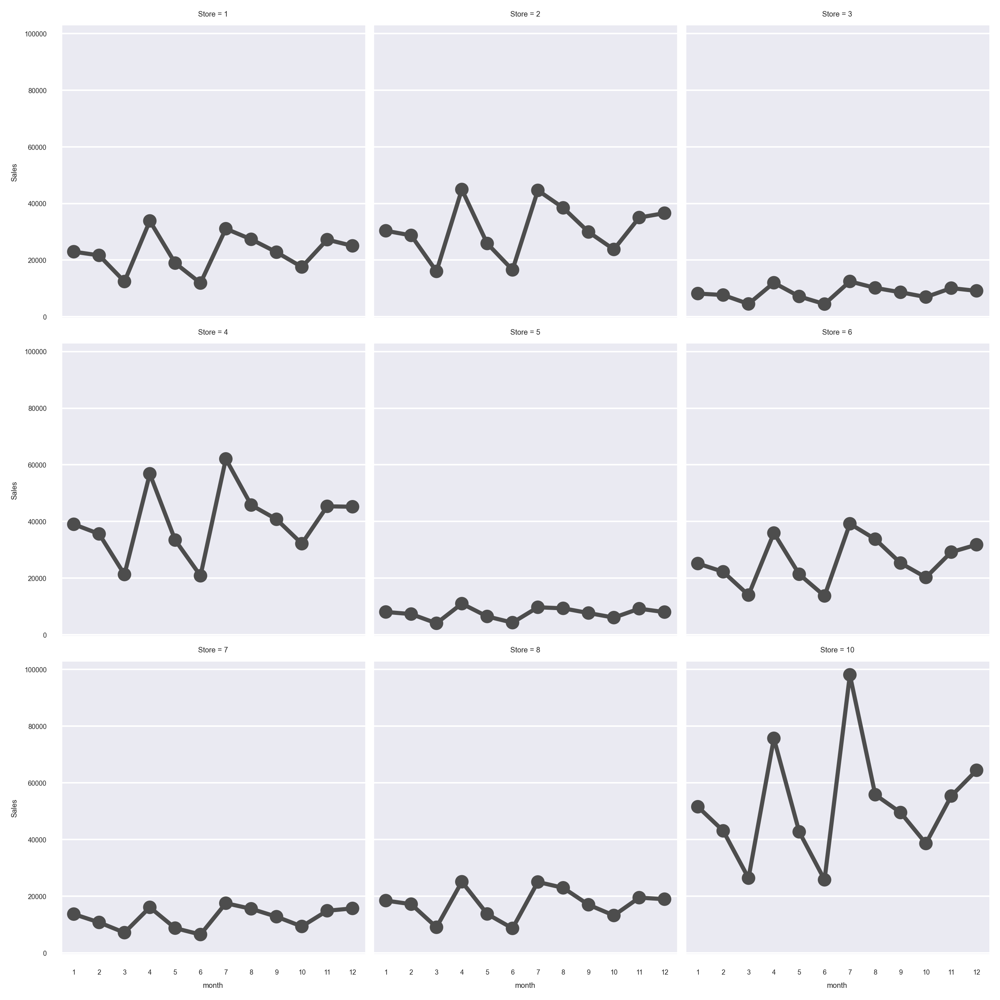

In [14]:
g = sns.FacetGrid(df1.iloc[108:108*2], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
In 2011, all store monthly sales is almost similar to that of 2010. But it seems store 4 monthly sales improve than previous year, this year store 4 crosses monthly sales of 60000 in 7th month. 
As last year, store 10 maintained his dominance in market and store 10 monthly sales remains higher than others in 2011 also especially in 7th month of 2011.

### Monthly Sales (Store wise) in 2012

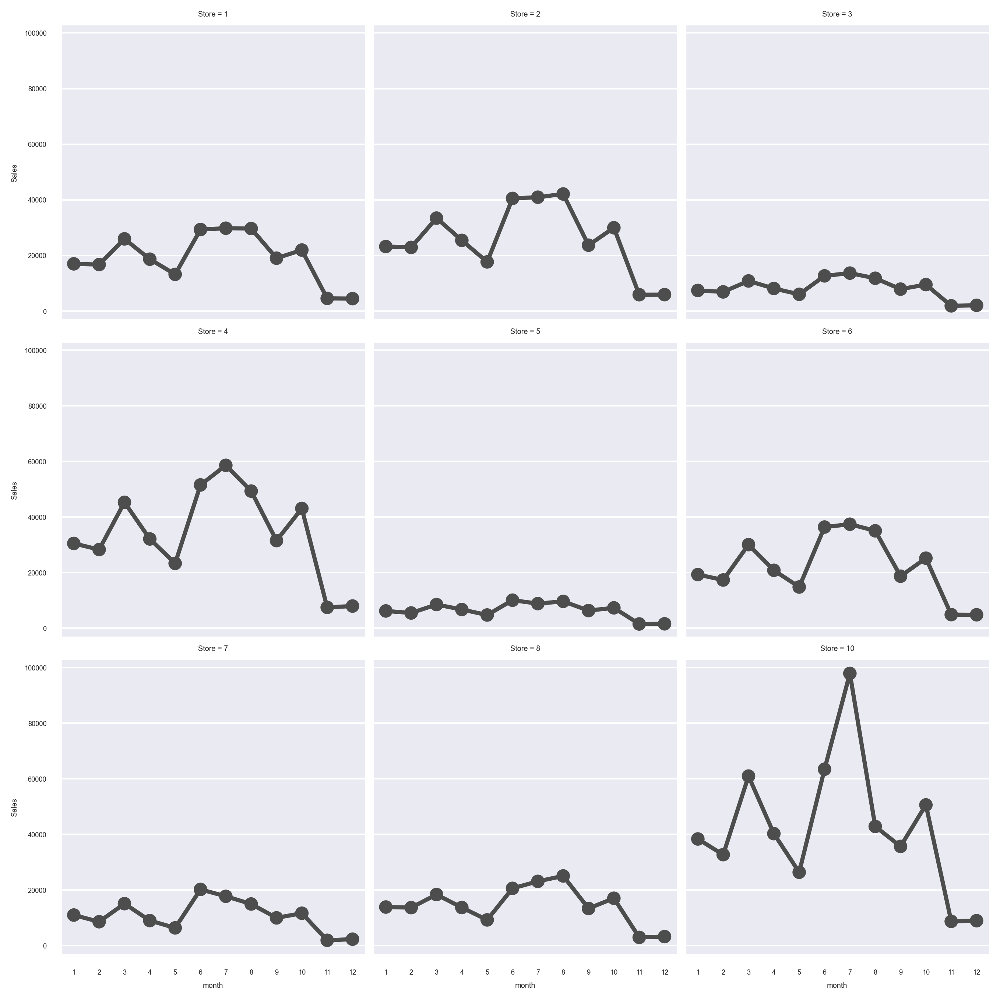

In [15]:
g = sns.FacetGrid(df1.iloc[108*2:108*3], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
In 2012 also all store monthly sales remain similar to as in previous two years. Like previous two years, Store 10 monthly sales is higher in 2012 also and especially in 7th month like other years.

## Monthly Unit Sold (Store wise) in 2010, 2011, and 2012

In [16]:
df1 = df.groupby(['year','Store','month']).agg({'Weekly_Units_Sold':'sum'})
df1.reset_index(inplace=True)
print(df1.year.value_counts())
df1.head()

2010    108
2011    108
2012    108
Name: year, dtype: int64


,year,Store,month,Weekly_Units_Sold
0,2010,1,1,504
1,2010,1,2,3289
2,2010,1,3,2102
3,2010,1,4,2658
4,2010,1,5,3550


### Monthly Unit Sold (Store wise) in 2010

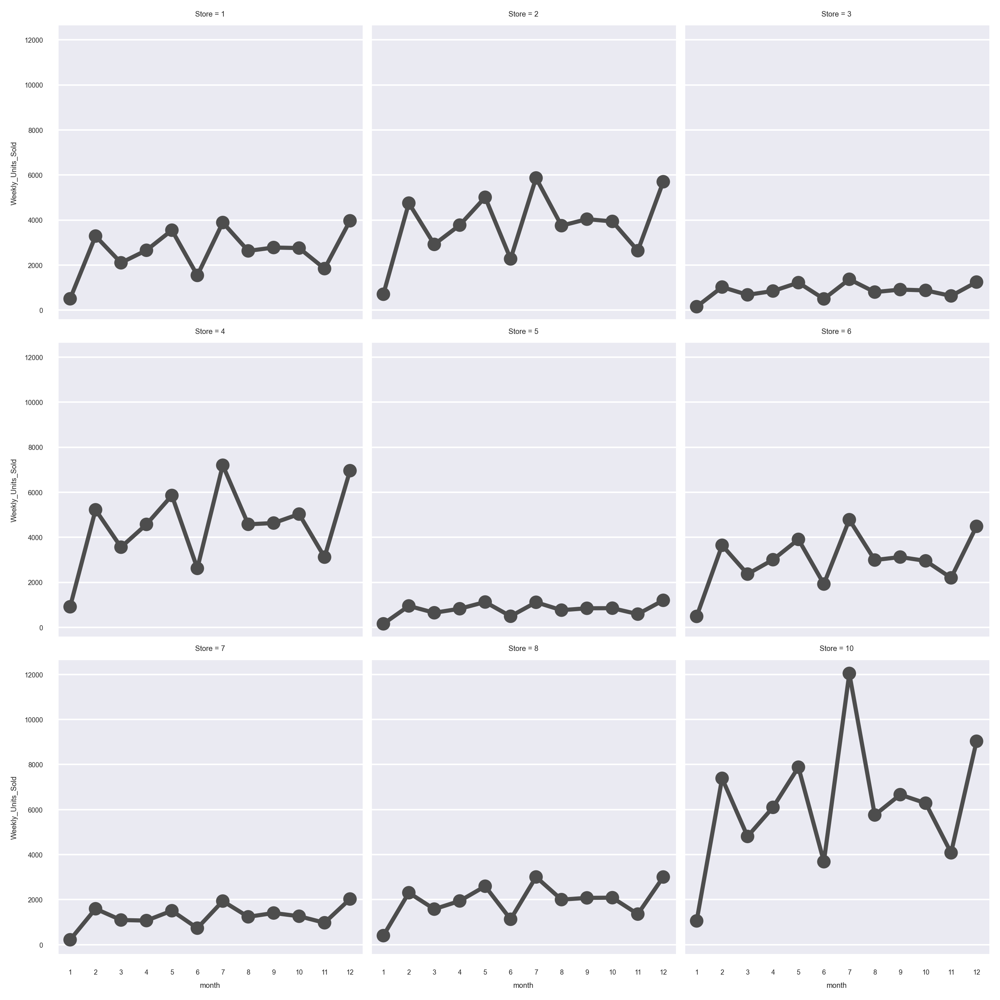

In [17]:
g = sns.FacetGrid(df1.iloc[0:108], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

### Monthly Unit Sold (Store wise) in 2011

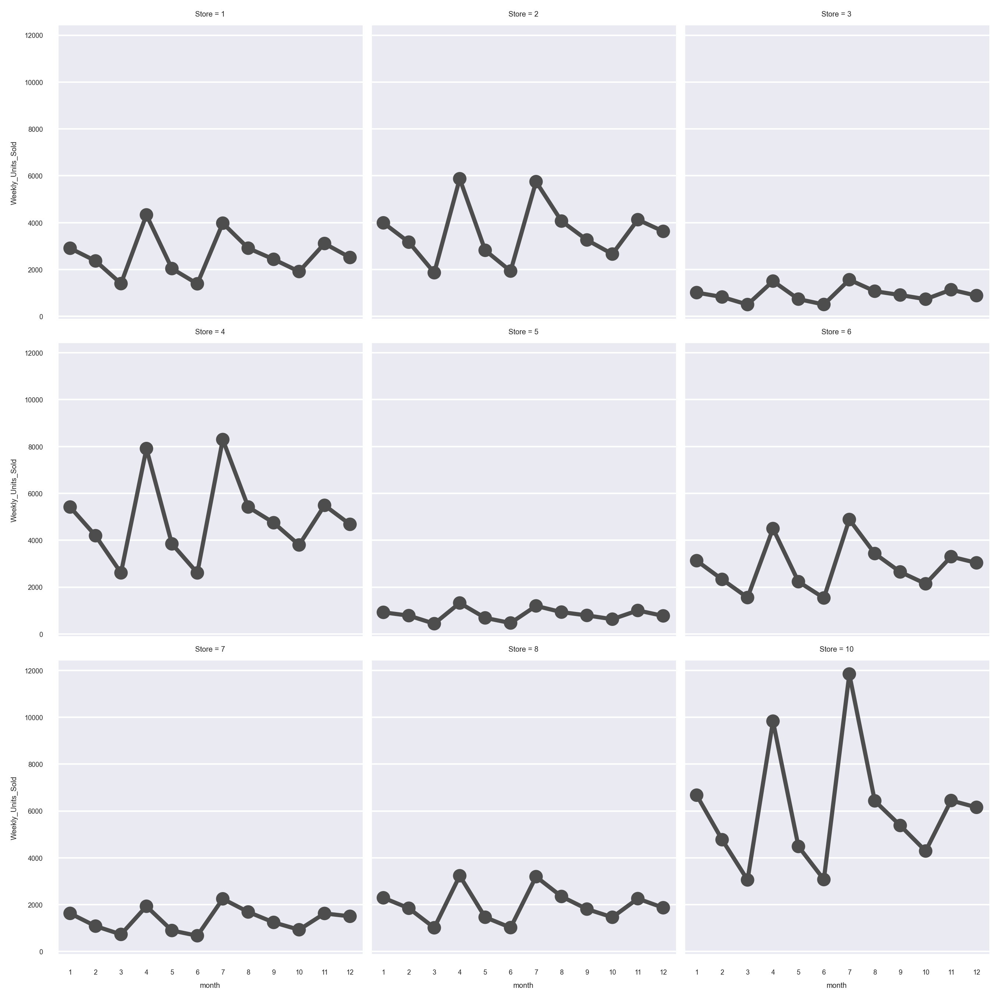

In [18]:
g = sns.FacetGrid(df1.iloc[108:108*2], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

### Monthly Unit Sold (Store wise) in 2012

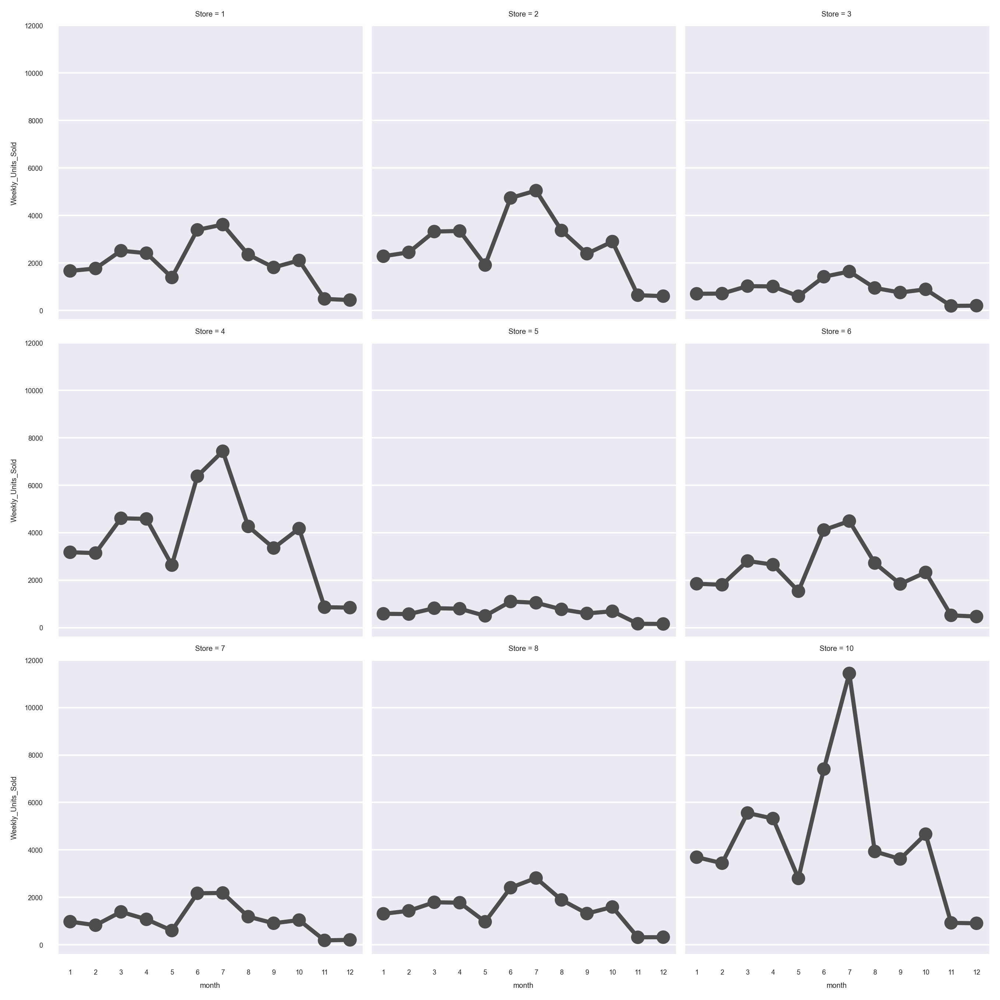

In [19]:
g = sns.FacetGrid(df1.iloc[108*2:108*3], col="Store", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
As "Sales" are 80% correlated with "Weekly_unit_sold", Monthly Unit Sold of each store in three years are almost similar with Monthly Sales.

## Monthly Sales (Product wise) in 2010, 2011, and 2012

In [20]:
df1 = df.groupby(['year','Product','month']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
print(df1.year.value_counts())
df1.head()

2010    36
2011    36
2012    36
Name: year, dtype: int64


,year,Product,month,Sales
0,2010,1,1,11598.39
1,2010,1,2,78952.10
2,2010,1,3,50998.95
3,2010,1,4,37762.20
4,2010,1,5,81907.34


### Monthly Sales (Product wise) in 2010

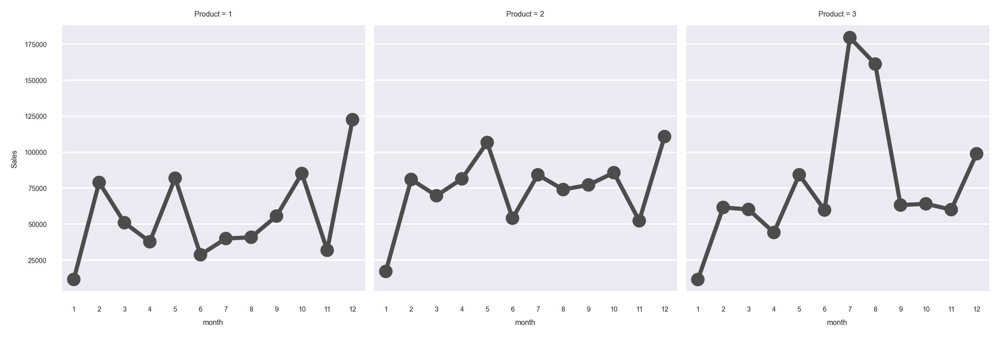

In [21]:
g = sns.FacetGrid(df1.iloc[0:36], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
Except 7th and 8th month of 2010, all product sales are almost similar. But in 7th and 8th month, Prodcut 3 sales is much higher than other products.

### Monthly Sales (Product wise) in 2011

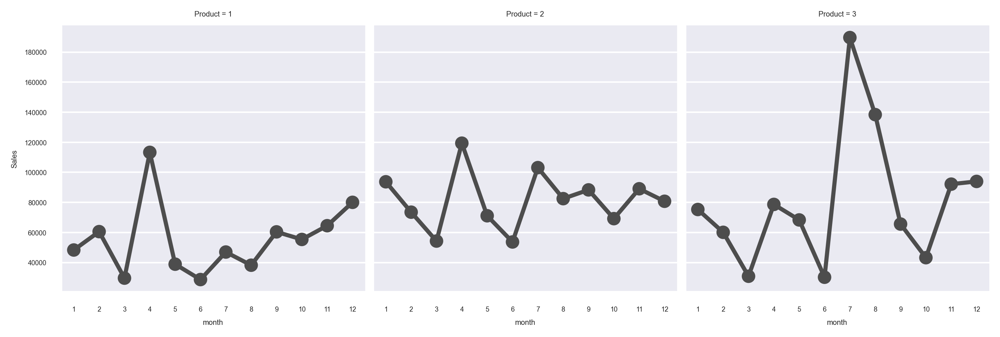

In [22]:
g = sns.FacetGrid(df1.iloc[36:36*2], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
Product 1 sales increases in 4th month but after that it decreased. Similar to last year, Product 3 dominates in 7th month of 2011 also.

### Monthly Sales (Product wise) in 2012

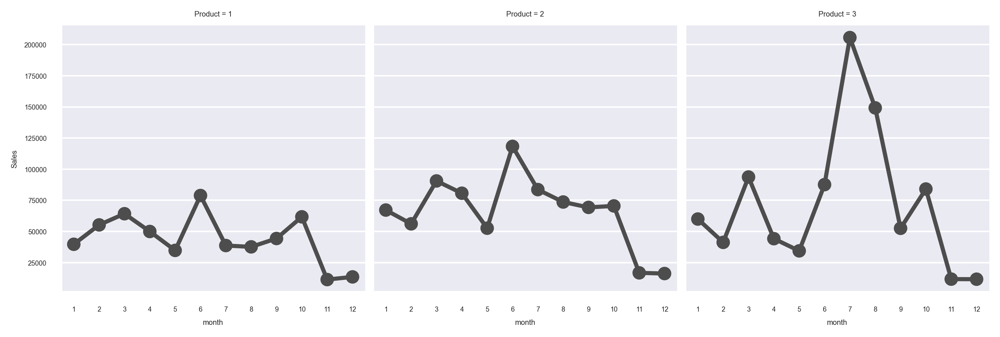

In [23]:
g = sns.FacetGrid(df1.iloc[36*2:36*3], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Sales", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
Like previous two years, this year also product 3 sales is much higher in 7th and 8th month. In 11th and 12th month, all product sales was much lower.

## Monthly Unit Sold (Product wise) in 2010, 2011, and 2012

In [24]:
df1 = df.groupby(['year','Product','month']).agg({'Weekly_Units_Sold':'sum'})
df1.reset_index(inplace=True)
print(df1.year.value_counts())
df1.head()

2010    36
2011    36
2012    36
Name: year, dtype: int64


,year,Product,month,Weekly_Units_Sold
0,2010,1,1,1161
1,2010,1,2,8790
2,2010,1,3,5105
3,2010,1,4,3780
4,2010,1,5,9466


### Monthly Unit Sold (Product wise) in 2010

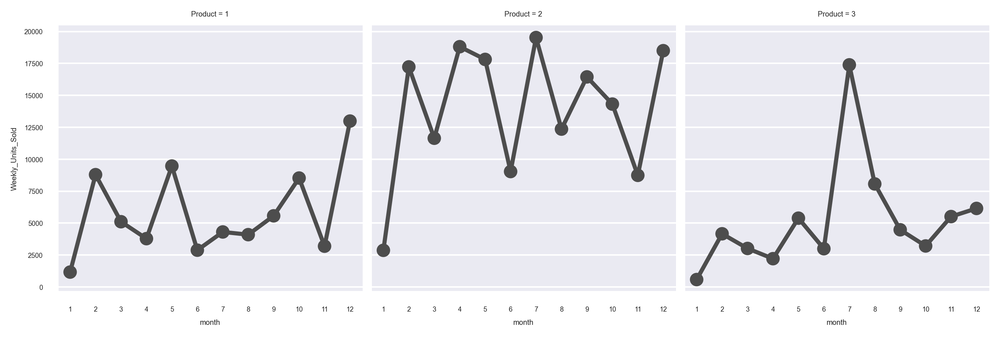

In [25]:
g = sns.FacetGrid(df1.iloc[0:36], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

### Monthly Unit Sold (Store wise) in 2011

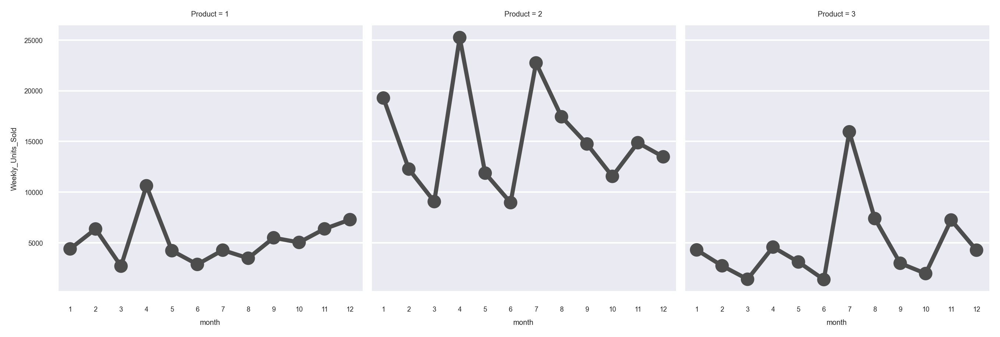

In [26]:
g = sns.FacetGrid(df1.iloc[36:36*2], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

### Monthly Unit Sold (Store wise) in 2012

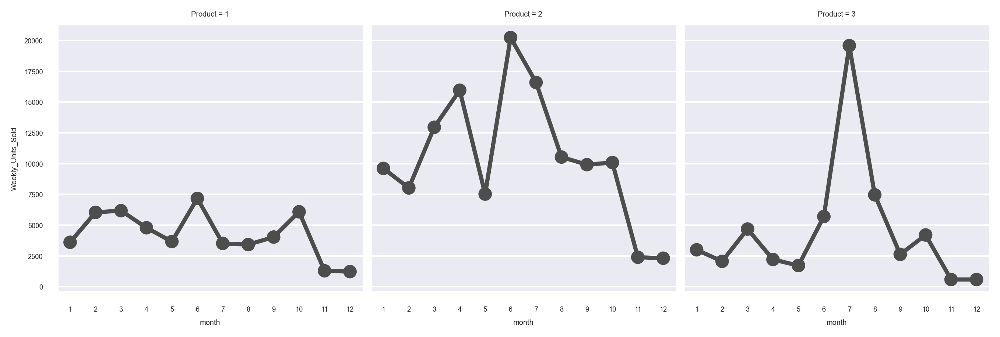

In [27]:
g = sns.FacetGrid(df1.iloc[36*2:36*3], col="Product", col_wrap=3, height=3)
g.map(sns.pointplot, "month", "Weekly_Units_Sold", color=".3", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12])

**Observations:**
Product 2 unit sold is much higher but its sales is not so high as product 3. That means Price of product 2 is much lesser and selling price of product 3 is much higher. 

## Monthly Sales (Store + Product wise, combinely) in 2010, 2011, and 2012

In [28]:
df1 = df.groupby(['year', 'month', 'Store', 'Product']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
print(df1.year.value_counts())
df1.head()

2010    324
2011    324
2012    324
Name: year, dtype: int64


,year,month,Store,Product,Sales
0,2010,1,1,1,1338.66
1,2010,1,1,2,1826.95
2,2010,1,1,3,1299.35
3,2010,1,2,1,1798.20
4,2010,1,2,2,2653.57


### Monthly Sales (Store + Product wise, combinely) in 2010

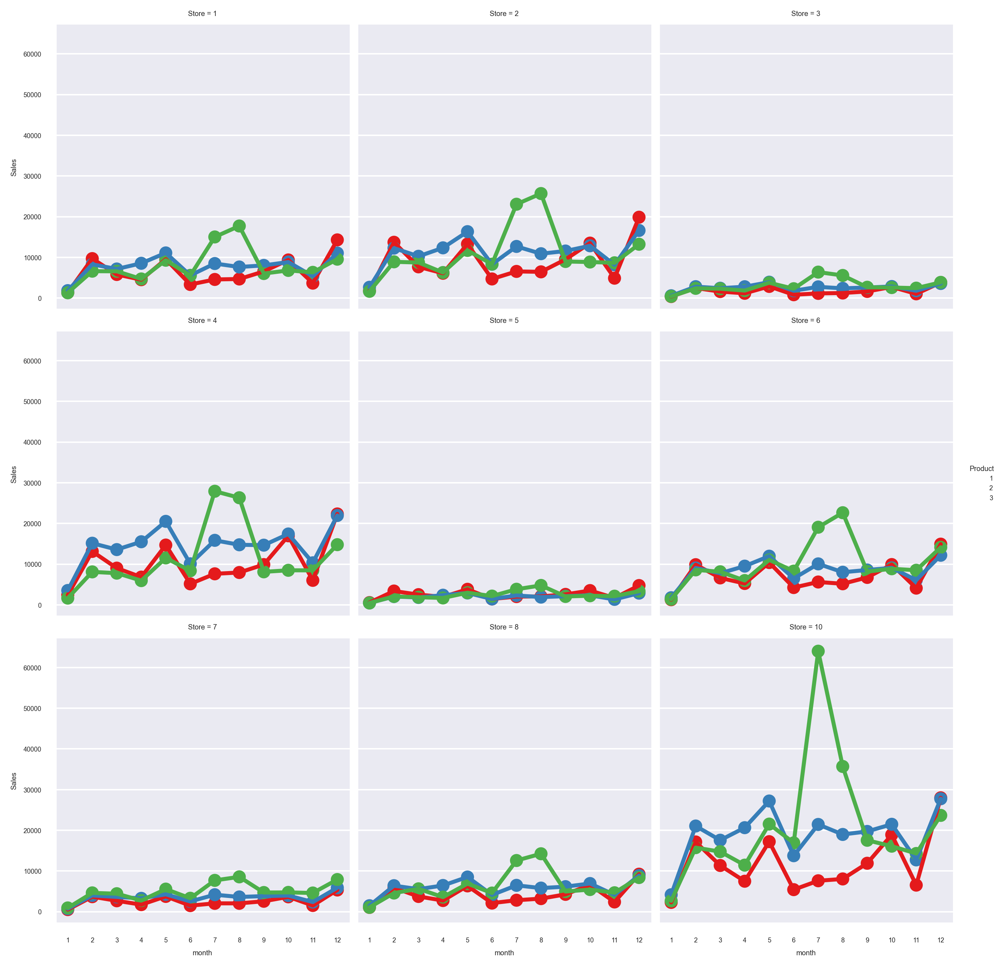

In [29]:
g = sns.FacetGrid(df1.iloc[:324], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Sales", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

### Monthly Sales (Store + Product wise, combinely) in 2011

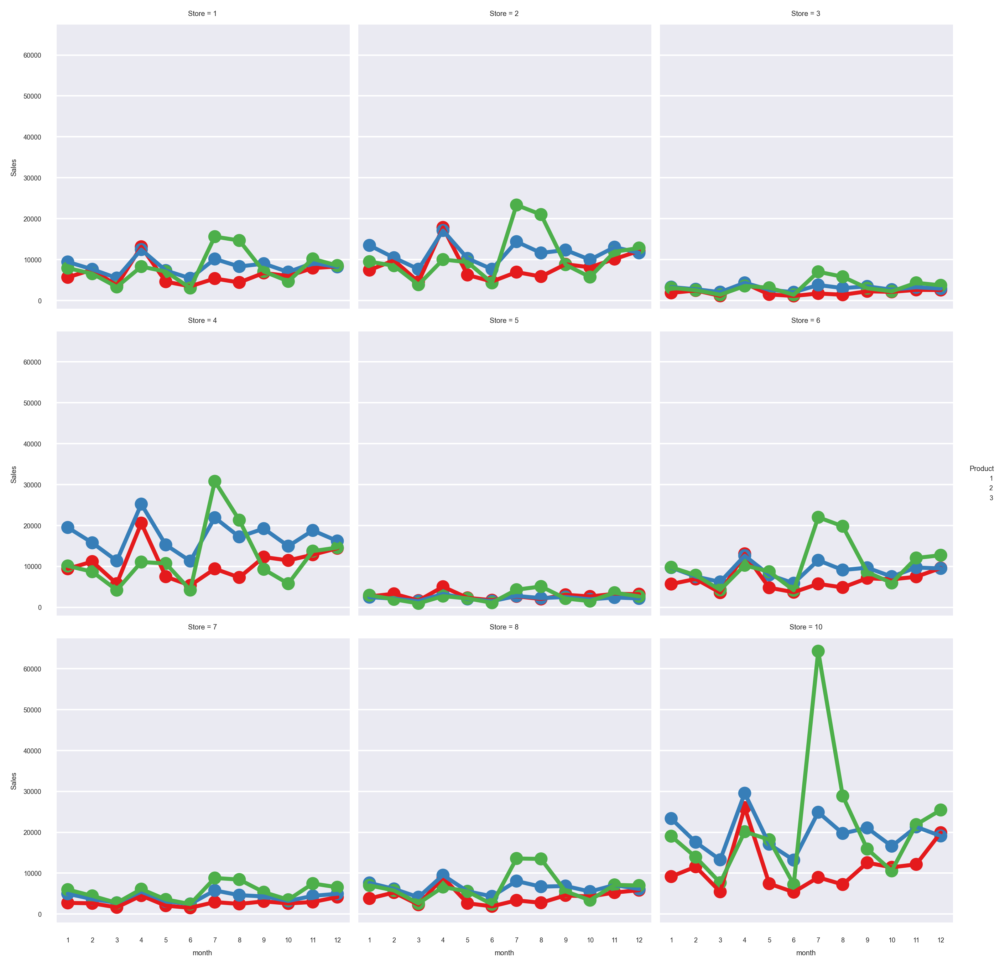

In [30]:
g = sns.FacetGrid(df1.iloc[324:324*2], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Sales", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

### Monthly Sales (Store + Product wise, combinely) in 2012

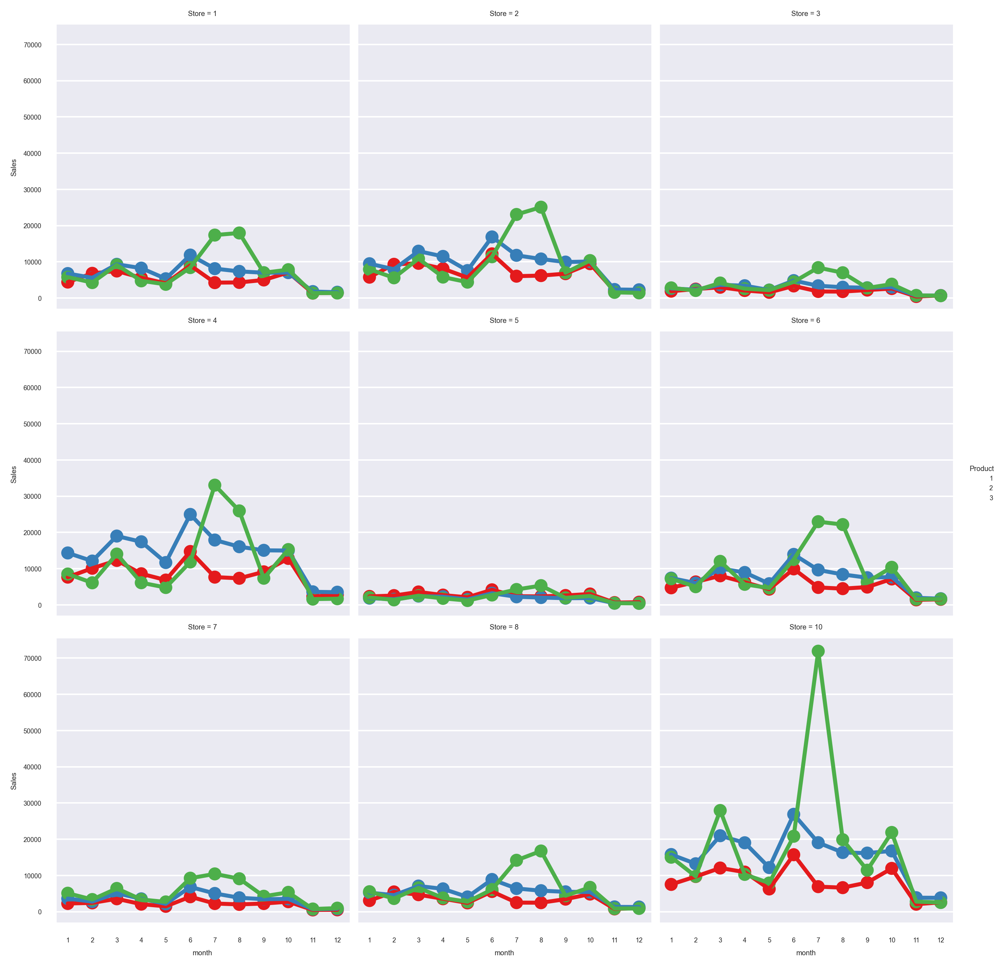

In [31]:
g = sns.FacetGrid(df1.iloc[324*2:324*3], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Sales", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

**Observations:**
Its seems that Product 3 is more popular in between the 6th month and 8th month. Store 10 has more sales of product 3 in 7th month. Other than 6th to 8th month, Product 2 sales is higher but not so high as product 3 in 7th month.

## Monthly Unit Sold (Store + Product wise, combinely) in 2010, 2011, and 2012

In [32]:
df1 = df.groupby(['year', 'month', 'Store', 'Product']).agg({'Weekly_Units_Sold':'sum'})
df1.reset_index(inplace=True)
print(df1.year.value_counts())
df1.head()

2010    324
2011    324
2012    324
Name: year, dtype: int64


,year,month,Store,Product,Weekly_Units_Sold
0,2010,1,1,1,134
1,2010,1,1,2,305
2,2010,1,1,3,65
3,2010,1,2,1,180
4,2010,1,2,2,443


### Monthly Unit Sold (Store + Product wise, combinely) in 2010

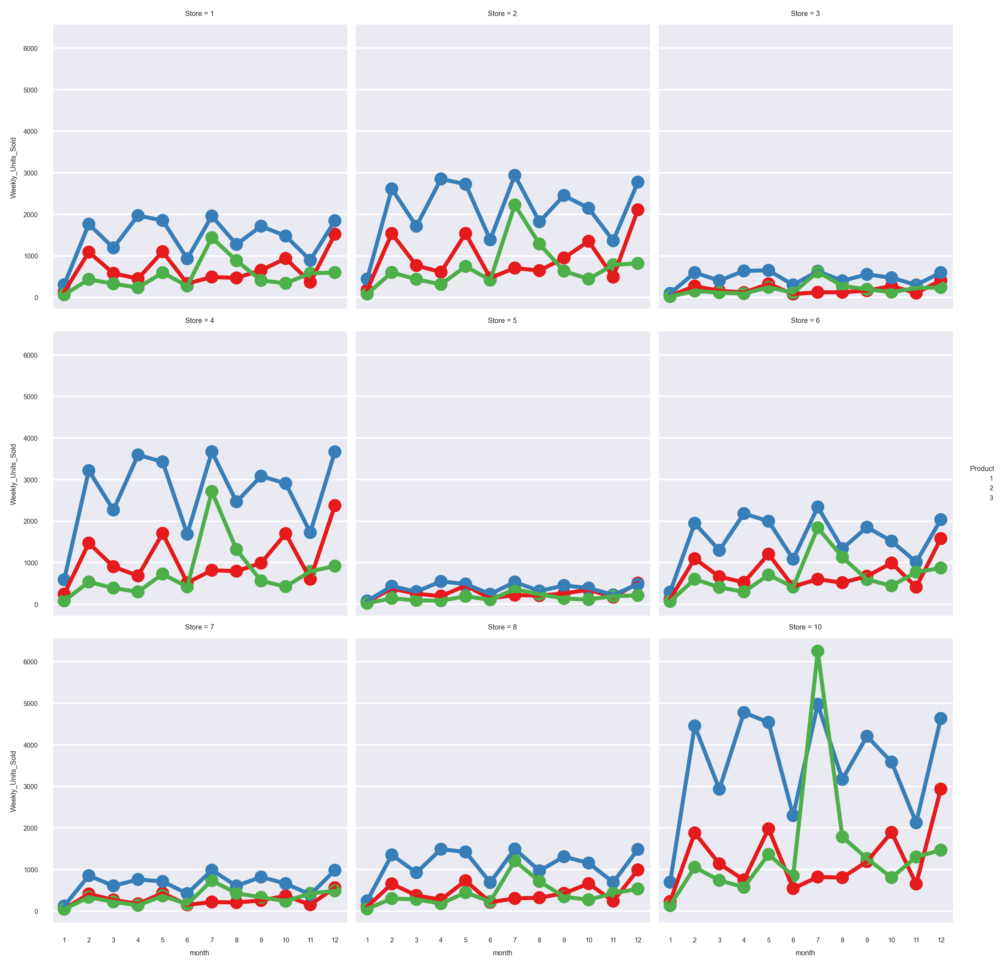

In [33]:
#2010
g = sns.FacetGrid(df1.iloc[:324], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Weekly_Units_Sold", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

### Monthly Unit Sold (Store + Product wise, combinely) in 2011

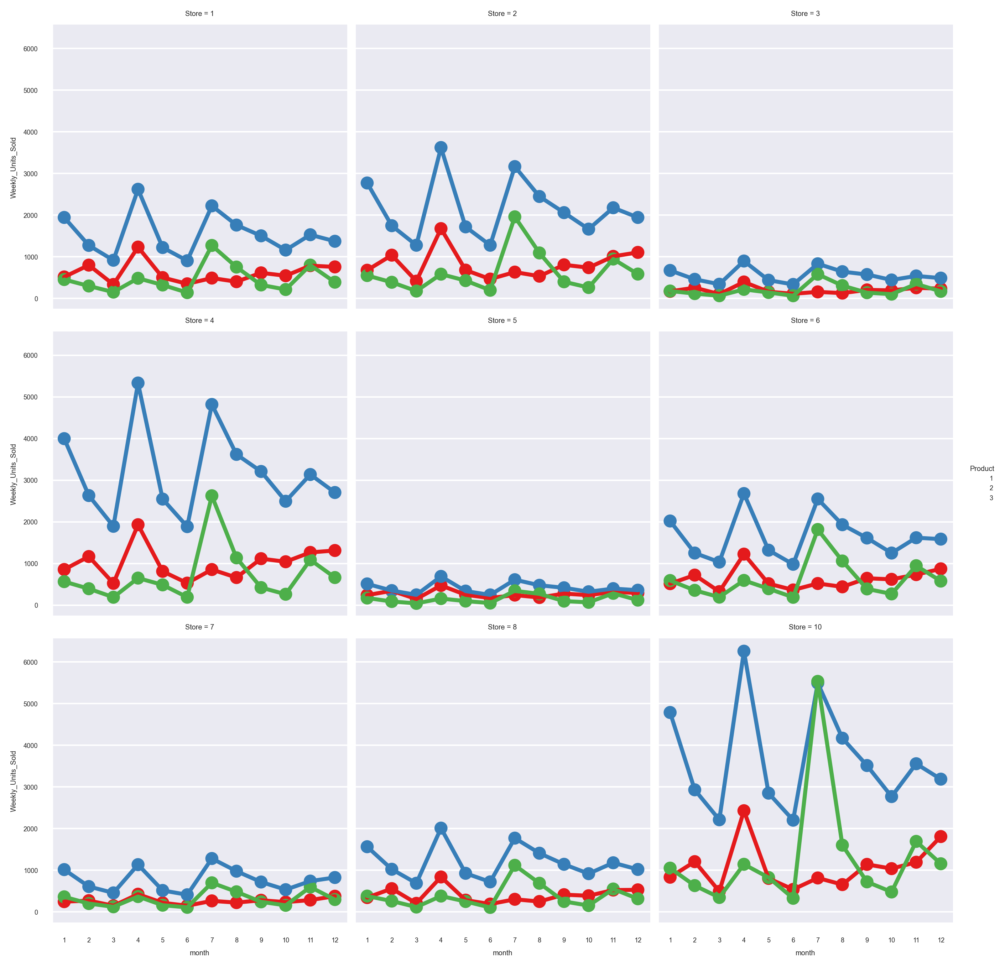

In [34]:
#2011
g = sns.FacetGrid(df1.iloc[324*1:324*2], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Weekly_Units_Sold", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

### Monthly Unit Sold (Store + Product wise, combinely) in 2012

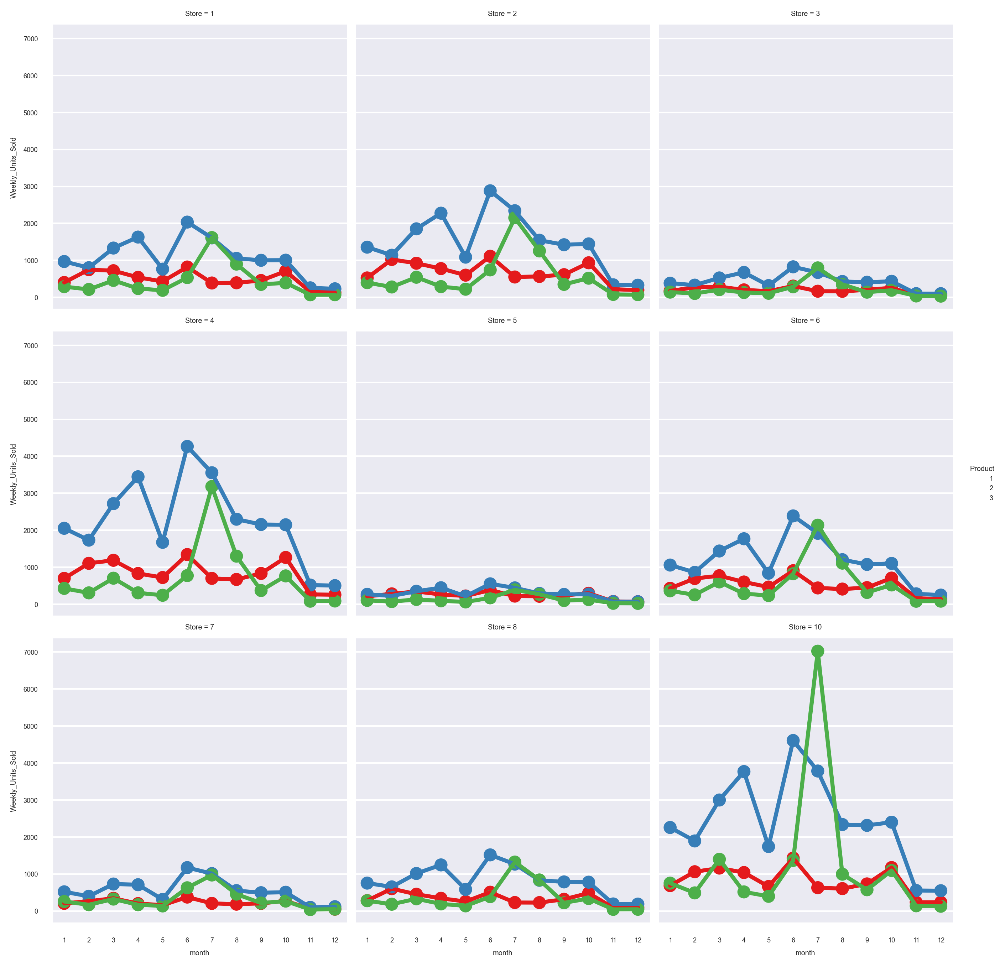

In [35]:
#2012
g = sns.FacetGrid(df1.iloc[324*2:324*3], col="Store", col_wrap=3, height=3, hue='Product', palette="Set1")
g.map(sns.pointplot, "month", "Weekly_Units_Sold", ci=None, order = [1,2,3,4,5,6,7,8,9,10,11,12], alpha=.7)
g.add_legend()

**Observation**:

• Product 2 unit selling is more in every store.

• In 7th month, Store 10 has more sold product 3 in 2010 and 2012. In 2011, Store 10 has sold equal units of product 3 and 2 in 7th month.

• We can conculde that although product 2 unit sold is much higher, its selling price is not so high. Hence its Sales remains low.

# Weekly Sales and Unit Sold (Store and Product wise) in 2010, 2011, and 2012

## Weekly Sales (Store wise) in 2010, 2011, and 2012

In [36]:
df1 = df.groupby(['year', 'Store', 'week_of_year']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)

print(df1.year.value_counts())
print(df1.iloc[:369].Store.value_counts())                     #2010
print(df1.iloc[369:369+405].Store.value_counts())              #2011
print(df1.iloc[405+369:369+369+405].Store.value_counts())      #2012

2011    405
2010    369
2012    369
Name: year, dtype: int64
1     41
2     41
3     41
4     41
5     41
6     41
7     41
8     41
10    41
Name: Store, dtype: int64
1     45
2     45
3     45
4     45
5     45
6     45
7     45
8     45
10    45
Name: Store, dtype: int64
1     41
2     41
3     41
4     41
5     41
6     41
7     41
8     41
10    41
Name: Store, dtype: int64


• Here, we are seperating year, store, and week_of_year column and also seperating ‘sales’ coulmn from df and creating a new variable ‘df1’.

• .agg({‘Sales’:’sum’}) : This will do sum of Sales row wise as per our requirement. Means, it will add all values in sales fall under Store 1 and week 1 for first row in df1. Similarly for all rows, it will do.
    
• Then we are checking number of times each years occurs in df1.

• Then we are checking number of times each store occurs in df1 year wise. In 2010, Store 1 occurs 41 times means we have data of store 1 for 41 weeks in 2010. Similarly for others.

• df1.iloc[x:y] function take out values of each column from x number row to y-1 number row of df1.

### Weekly Sales of each store in 2010

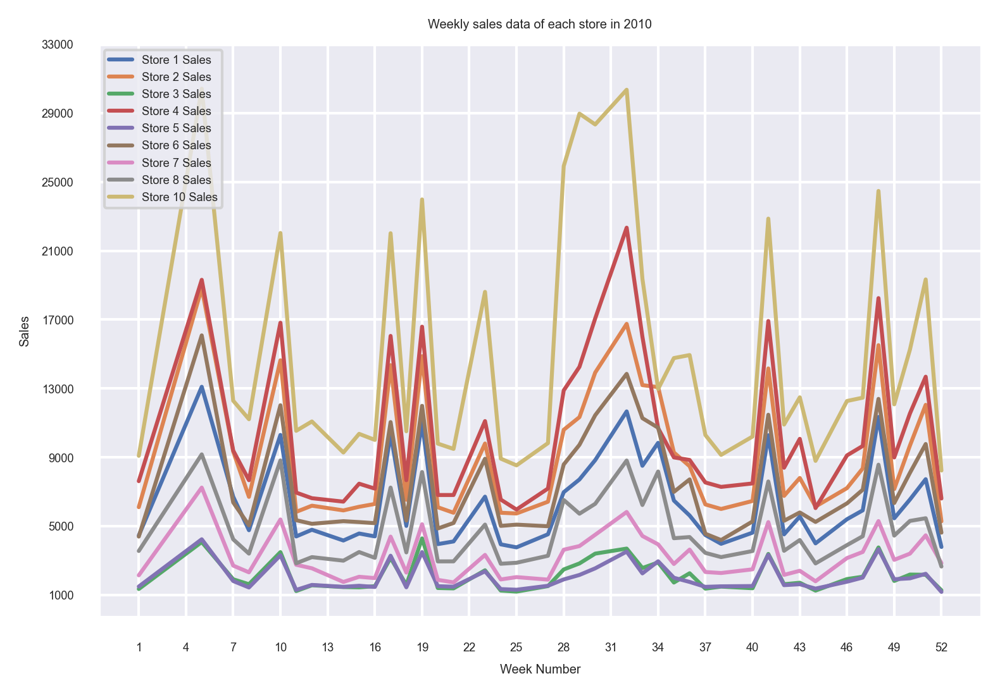

In [37]:
#Weekly Sales of each store in 2010

Week1  = df1['week_of_year'].iloc[0:41].tolist()
Week2  = df1['week_of_year'].iloc[41*1:41*2].tolist()
Week3  = df1['week_of_year'].iloc[41*2:41*3].tolist()
Week4  = df1['week_of_year'].iloc[41*3:41*4].tolist()
Week5  = df1['week_of_year'].iloc[41*4:41*5].tolist()
Week6  = df1['week_of_year'].iloc[41*5:41*6].tolist()
Week7  = df1['week_of_year'].iloc[41*6:41*7].tolist()
Week8  = df1['week_of_year'].iloc[41*7:41*8].tolist()
Week9  = df1['week_of_year'].iloc[41*8:41*9].tolist()

Sales1   = df1['Sales'].iloc[0:41].tolist()
Sales2   = df1['Sales'].iloc[41*1:41*2].tolist()
Sales3   = df1['Sales'].iloc[41*2:41*3].tolist()
Sales4   = df1['Sales'].iloc[41*3:41*4].tolist()
Sales5   = df1['Sales'].iloc[41*4:41*5].tolist()
Sales6   = df1['Sales'].iloc[41*5:41*6].tolist()
Sales7   = df1['Sales'].iloc[41*6:41*7].tolist()
Sales8   = df1['Sales'].iloc[41*7:41*8].tolist()
Sales9   = df1['Sales'].iloc[41*8:41*9].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(1000,34000,4000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each store in 2010')
plt.show()

• Week1 = df1['week_of_year'].iloc[0:41].tolist() : As store 1 contains 41 weeks in total in 2010, we are taking 0 to 41 for store 1. Then we are converting it into list.

• Sales1 = df1['Sales'].iloc[0:41].tolist() : Sales1 taking out row from 0 to 41 of ‘Sales’ column. Then we are converting it into list form.

• This will plot Weekly sales for Store 1. We will do similarly for others. Then we will draw plot graph of each store in one figure.

• We are creating y which contain week number to represent on X-axis in list form.

• We are also creating z which contains values in range of 1000 and 34000. We will use to represent values on Y-axis.

• plt.plot(Week1, Sales1, label = 'Store 1 Sales') : This will plot for store 1 only. We will execute combinely so all plotting will be on same figure.

• plt.xlabel('Week Number') : Let’s give X-axis name as ‘Week Number’ as it contain week number.

• plt.ylabel('Sales') : Let’s give Y-axis name as ‘Sales’ as it represents sales.

• plt.legend(loc='upper left') : It will show legends on left side of graph.

• plt.xticks(y), plt.yticks(z) : This are alloting values of y and z that we created earlier to x and y axis respectively.

• plt.title('Weekly sales data of each store in 2010') : It is used to show title of graph.

**Observation**:

• In 2010, Weekly sales of Store 10 is more than others throughout the year.

• While, Store 5 has lowest sales than others throughout the year.

• In 2010, order of each store sales is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• In week 5 and week 32, sales of store 10 is highest in 2010.

**Similarly, we will plot for each year**

### Weekly sales of each store in 2011

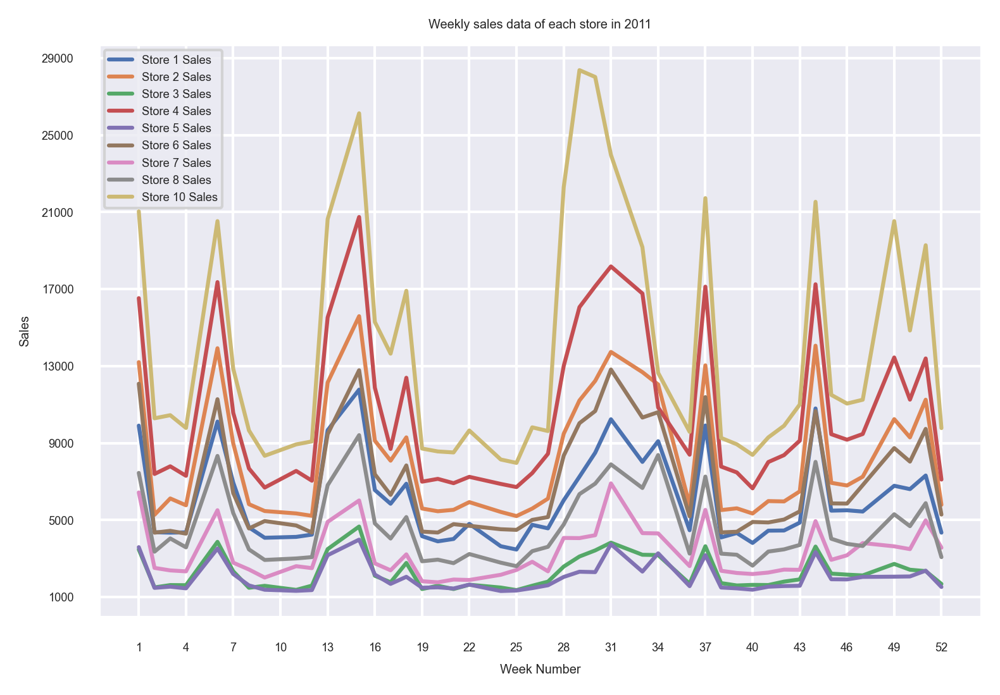

In [38]:
# Weekly sales of each store in 2011

Week1  = df1['week_of_year'].iloc[41*9:369+(45*1)].tolist()
Week2  = df1['week_of_year'].iloc[369+(45*1):369+(45*2)].tolist()
Week3  = df1['week_of_year'].iloc[369+(45*2):369+(45*3)].tolist()
Week4  = df1['week_of_year'].iloc[369+(45*3):369+(45*4)].tolist()
Week5  = df1['week_of_year'].iloc[369+(45*4):369+(45*5)].tolist()
Week6  = df1['week_of_year'].iloc[369+(45*5):369+(45*6)].tolist()
Week7  = df1['week_of_year'].iloc[369+(45*6):369+(45*7)].tolist()
Week8  = df1['week_of_year'].iloc[369+(45*7):369+(45*8)].tolist()
Week9  = df1['week_of_year'].iloc[369+(45*8):369+(45*9)].tolist()

Sales1   = df1['Sales'].iloc[41*9:369+(45*1)].tolist()
Sales2   = df1['Sales'].iloc[369+(45*1):369+(45*2)].tolist()
Sales3   = df1['Sales'].iloc[369+(45*2):369+(45*3)].tolist()
Sales4   = df1['Sales'].iloc[369+(45*3):369+(45*4)].tolist()
Sales5   = df1['Sales'].iloc[369+(45*4):369+(45*5)].tolist()
Sales6   = df1['Sales'].iloc[369+(45*5):369+(45*6)].tolist()
Sales7   = df1['Sales'].iloc[369+(45*6):369+(45*7)].tolist()
Sales8   = df1['Sales'].iloc[369+(45*7):369+(45*8)].tolist()
Sales9   = df1['Sales'].iloc[369+(45*8):369+(45*9)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(1000,30000,4000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each store in 2011')
plt.show()

**Observations**:

• In 2011, Weekly sales of Store 10 is more than others throughout the year.

• While, Store 5 has lowest sales than others throughout the year.

• In 2011, order of each store sales is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• Between week 28 and 31, sales of store 10 is highest in year 2011.

### Weekly sales of each store in 2012

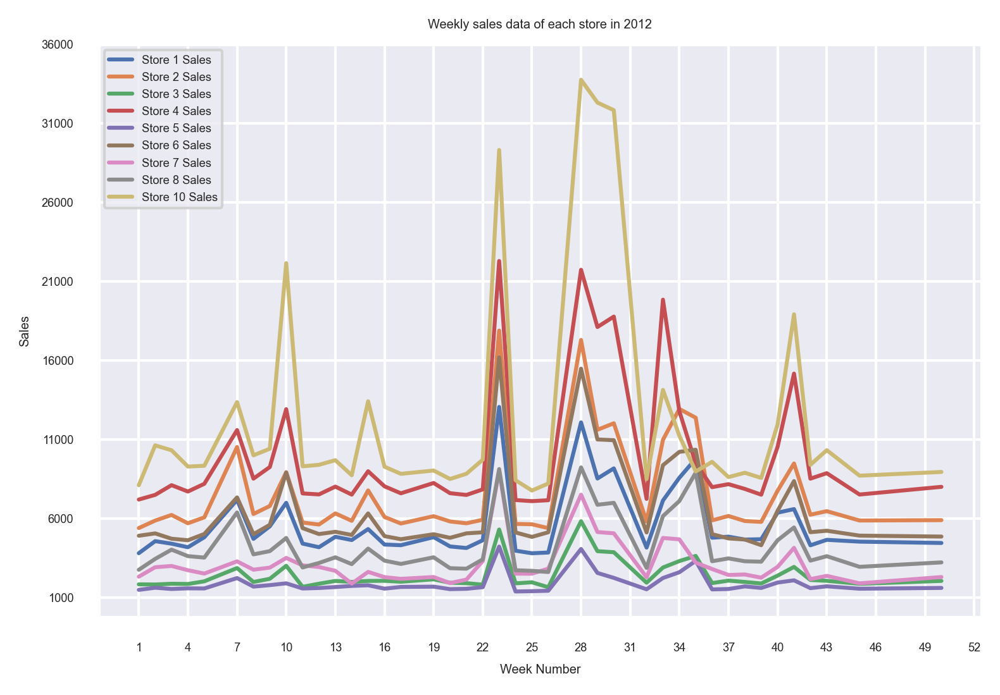

In [39]:
# Weekly sale of each store in 2012

Week1  = df1['week_of_year'].iloc[369+(45*9) : 369+(45*9)+(41*1)].tolist()
Week2  = df1['week_of_year'].iloc[369+(45*9)+(41*1) : 369+(45*9)+(41*2)].tolist()
Week3  = df1['week_of_year'].iloc[369+(45*9)+(41*2) : 369+(45*9)+(41*3)].tolist()
Week4  = df1['week_of_year'].iloc[369+(45*9)+(41*3) : 369+(45*9)+(41*4)].tolist()
Week5  = df1['week_of_year'].iloc[369+(45*9)+(41*4) : 369+(45*9)+(41*5)].tolist()
Week6  = df1['week_of_year'].iloc[369+(45*9)+(41*5) : 369+(45*9)+(41*6)].tolist()
Week7  = df1['week_of_year'].iloc[369+(45*9)+(41*6) : 369+(45*9)+(41*7)].tolist()
Week8  = df1['week_of_year'].iloc[369+(45*9)+(41*7) : 369+(45*9)+(41*8)].tolist()
Week9  = df1['week_of_year'].iloc[369+(45*9)+(41*8) : 369+(45*9)+(41*9)].tolist()

Sales1   = df1['Sales'].iloc[369+(45*9) : 369+(45*9)+(41*1)].tolist()
Sales2   = df1['Sales'].iloc[369+(45*9)+(41*1) : 369+(45*9)+(41*2)].tolist()
Sales3   = df1['Sales'].iloc[369+(45*9)+(41*2) : 369+(45*9)+(41*3)].tolist()
Sales4   = df1['Sales'].iloc[369+(45*9)+(41*3) : 369+(45*9)+(41*4)].tolist()
Sales5   = df1['Sales'].iloc[369+(45*9)+(41*4) : 369+(45*9)+(41*5)].tolist()
Sales6   = df1['Sales'].iloc[369+(45*9)+(41*5) : 369+(45*9)+(41*6)].tolist()
Sales7   = df1['Sales'].iloc[369+(45*9)+(41*6) : 369+(45*9)+(41*7)].tolist()
Sales8   = df1['Sales'].iloc[369+(45*9)+(41*7) : 369+(45*9)+(41*8)].tolist()
Sales9   = df1['Sales'].iloc[369+(45*9)+(41*8) : 369+(45*9)+(41*9)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(1000,38000,5000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each store in 2012')
plt.show()

**Observations**:

• In 2012, Weekly sales of Store 10 is more than others upto week 33. From week 33 to week 36, we can observe that sales of store 4 goes above than sales of store 10.

• While, Store 5 has lowest sales than others throughout the year.

• In 2012, order of each store sales is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• In week 28, sales of store 10 is highest in year 2012.

• In 2010, 2011, and 2012, Store10’s sales remained higher than other stores. While store5’s sales remain lower than other stores.

## Weekly unit sold (Store wise) in 2010, 2011, and 2012

Now, we will plot weekly unit sold in store wise manner. We will plot in similar manner like before in weekly sales (store wise).

In [40]:
df1 = df.groupby(['year', 'Store', 'week_of_year']).agg({'Weekly_Units_Sold':'sum'})
df1.reset_index(inplace=True)

print(df1.year.value_counts())
print(df1.iloc[:369].Store.value_counts())                     #2010
print(df1.iloc[369:369+405].Store.value_counts())              #2011
print(df1.iloc[405+369:369+369+405].Store.value_counts())      #2012

2011    405
2010    369
2012    369
Name: year, dtype: int64
1     41
2     41
3     41
4     41
5     41
6     41
7     41
8     41
10    41
Name: Store, dtype: int64
1     45
2     45
3     45
4     45
5     45
6     45
7     45
8     45
10    45
Name: Store, dtype: int64
1     41
2     41
3     41
4     41
5     41
6     41
7     41
8     41
10    41
Name: Store, dtype: int64


• We will make df1 which contains columns like year, store, week_of_year, and weekly_unit_sold in similar method like we did before.

### Weekly unit sold in 2010

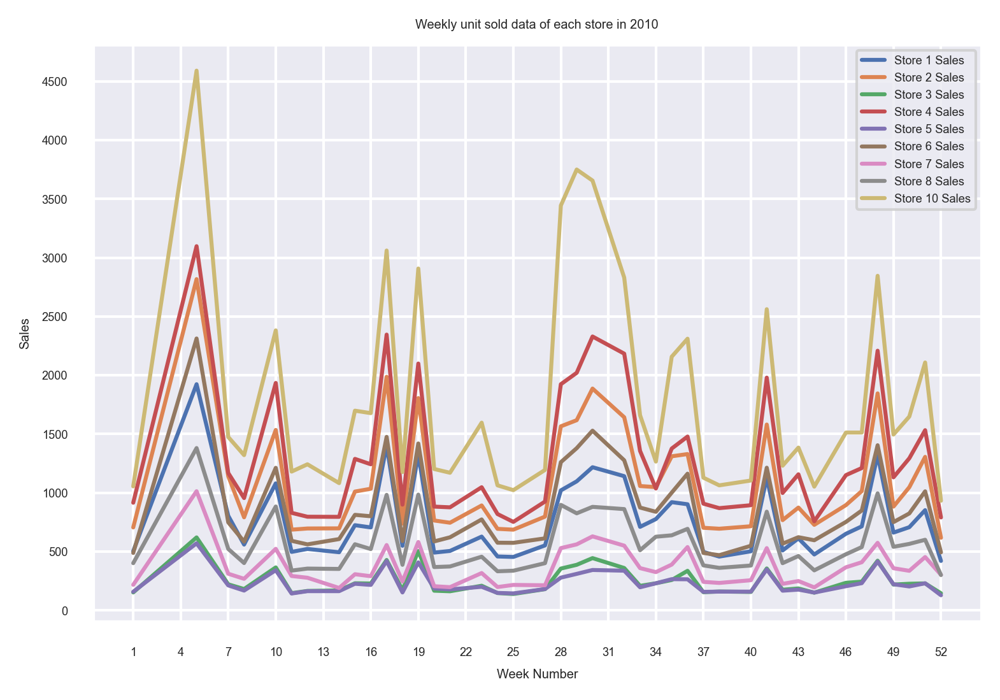

In [41]:
#Weekly unit sold store wise in 2010

Week1  = df1['week_of_year'].iloc[0:41].tolist()
Week2  = df1['week_of_year'].iloc[41*1:41*2].tolist()
Week3  = df1['week_of_year'].iloc[41*2:41*3].tolist()
Week4  = df1['week_of_year'].iloc[41*3:41*4].tolist()
Week5  = df1['week_of_year'].iloc[41*4:41*5].tolist()
Week6  = df1['week_of_year'].iloc[41*5:41*6].tolist()
Week7  = df1['week_of_year'].iloc[41*6:41*7].tolist()
Week8  = df1['week_of_year'].iloc[41*7:41*8].tolist()
Week9  = df1['week_of_year'].iloc[41*8:41*9].tolist()

Sales1   = df1['Weekly_Units_Sold'].iloc[0:41].tolist()
Sales2   = df1['Weekly_Units_Sold'].iloc[41*1:41*2].tolist()
Sales3   = df1['Weekly_Units_Sold'].iloc[41*2:41*3].tolist()
Sales4   = df1['Weekly_Units_Sold'].iloc[41*3:41*4].tolist()
Sales5   = df1['Weekly_Units_Sold'].iloc[41*4:41*5].tolist()
Sales6   = df1['Weekly_Units_Sold'].iloc[41*5:41*6].tolist()
Sales7   = df1['Weekly_Units_Sold'].iloc[41*6:41*7].tolist()
Sales8   = df1['Weekly_Units_Sold'].iloc[41*7:41*8].tolist()
Sales9   = df1['Weekly_Units_Sold'].iloc[41*8:41*9].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,5000,500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper right')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each store in 2010')
plt.show()

**Observations**:

• In 2010, Weekly unit sold of Store 10 is more than others throughout the year.

• While, Store 5 has lowest unit sold than others throughout the year.

• In 2010, order of each store’s unit sold is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• In week 5, sales of store 10 is highest in year 2010.

### Weekly unit sold in 2011

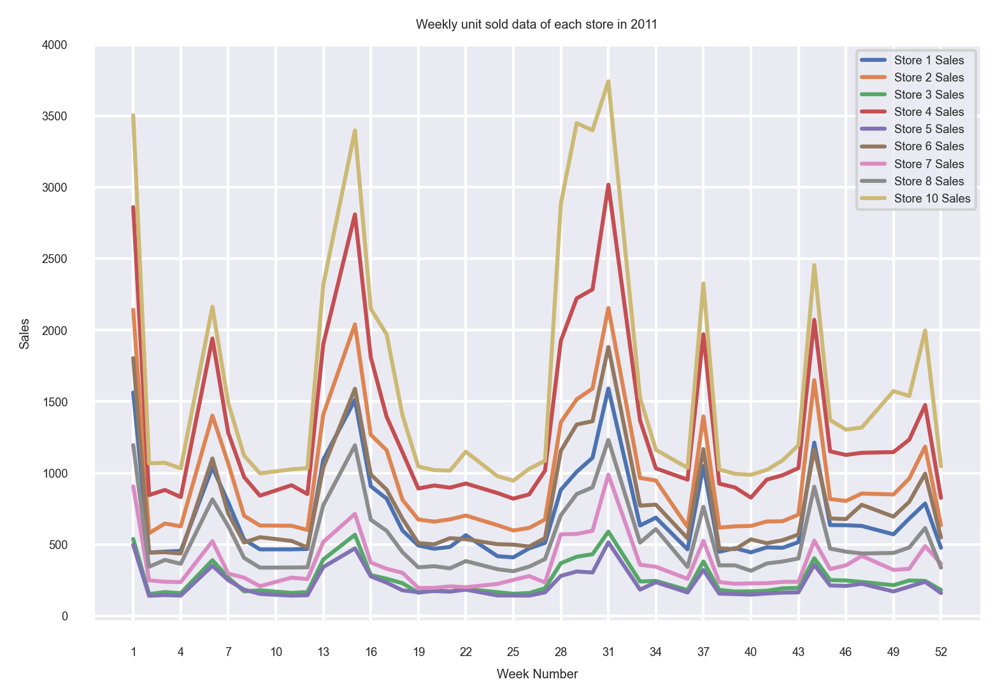

In [42]:
#Weekly unit sold store wise in 2011

Week1  = df1['week_of_year'].iloc[41*9:369+(45*1)].tolist()
Week2  = df1['week_of_year'].iloc[369+(45*1):369+(45*2)].tolist()
Week3  = df1['week_of_year'].iloc[369+(45*2):369+(45*3)].tolist()
Week4  = df1['week_of_year'].iloc[369+(45*3):369+(45*4)].tolist()
Week5  = df1['week_of_year'].iloc[369+(45*4):369+(45*5)].tolist()
Week6  = df1['week_of_year'].iloc[369+(45*5):369+(45*6)].tolist()
Week7  = df1['week_of_year'].iloc[369+(45*6):369+(45*7)].tolist()
Week8  = df1['week_of_year'].iloc[369+(45*7):369+(45*8)].tolist()
Week9  = df1['week_of_year'].iloc[369+(45*8):369+(45*9)].tolist()

Sales1   = df1['Weekly_Units_Sold'].iloc[41*9:369+(45*1)].tolist()
Sales2   = df1['Weekly_Units_Sold'].iloc[369+(45*1):369+(45*2)].tolist()
Sales3   = df1['Weekly_Units_Sold'].iloc[369+(45*2):369+(45*3)].tolist()
Sales4   = df1['Weekly_Units_Sold'].iloc[369+(45*3):369+(45*4)].tolist()
Sales5   = df1['Weekly_Units_Sold'].iloc[369+(45*4):369+(45*5)].tolist()
Sales6   = df1['Weekly_Units_Sold'].iloc[369+(45*5):369+(45*6)].tolist()
Sales7   = df1['Weekly_Units_Sold'].iloc[369+(45*6):369+(45*7)].tolist()
Sales8   = df1['Weekly_Units_Sold'].iloc[369+(45*7):369+(45*8)].tolist()
Sales9   = df1['Weekly_Units_Sold'].iloc[369+(45*8):369+(45*9)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,4100,500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper right')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each store in 2011')
plt.show()

**Observation**:
    
• In 2011, Weekly unit sold of Store 10 is more than others throughout the year.

• While, Store 5 has lowest sales than others throughout the year.

• In 2011, order of each store sales is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• In week 31, sales of store 10 is highest in year 2011.

### Weekly unit sold in 2012

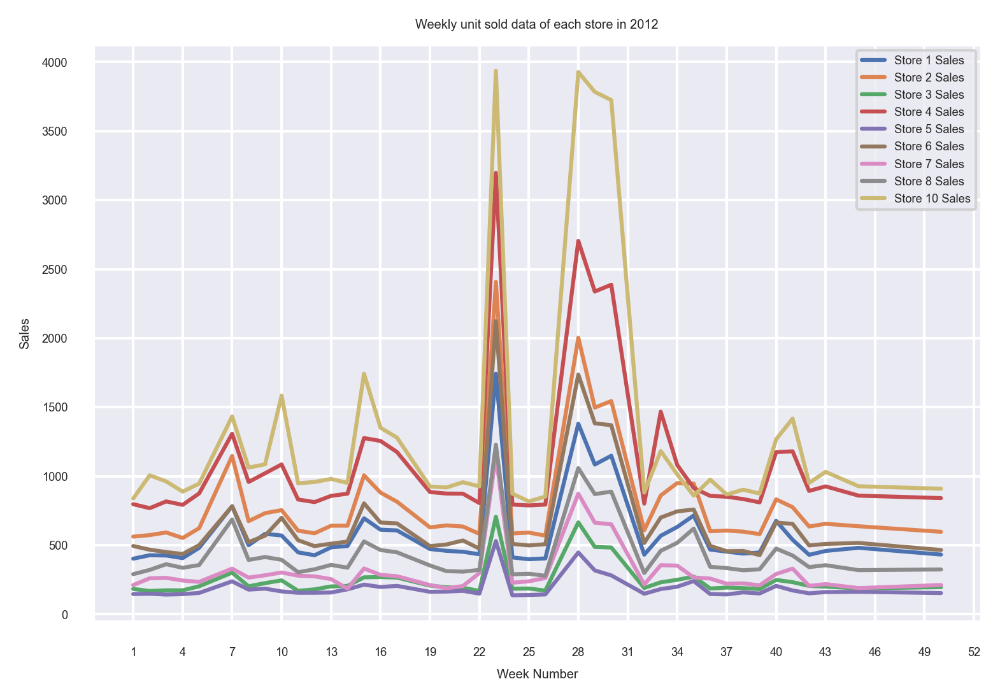

In [43]:
#Weekly unit sold store wise in 2012

Week1  = df1['week_of_year'].iloc[369+(45*9) : 369+(45*9)+(41*1)].tolist()
Week2  = df1['week_of_year'].iloc[369+(45*9)+(41*1) : 369+(45*9)+(41*2)].tolist()
Week3  = df1['week_of_year'].iloc[369+(45*9)+(41*2) : 369+(45*9)+(41*3)].tolist()
Week4  = df1['week_of_year'].iloc[369+(45*9)+(41*3) : 369+(45*9)+(41*4)].tolist()
Week5  = df1['week_of_year'].iloc[369+(45*9)+(41*4) : 369+(45*9)+(41*5)].tolist()
Week6  = df1['week_of_year'].iloc[369+(45*9)+(41*5) : 369+(45*9)+(41*6)].tolist()
Week7  = df1['week_of_year'].iloc[369+(45*9)+(41*6) : 369+(45*9)+(41*7)].tolist()
Week8  = df1['week_of_year'].iloc[369+(45*9)+(41*7) : 369+(45*9)+(41*8)].tolist()
Week9  = df1['week_of_year'].iloc[369+(45*9)+(41*8) : 369+(45*9)+(41*9)].tolist()

Sales1   = df1['Weekly_Units_Sold'].iloc[369+(45*9) : 369+(45*9)+(41*1)].tolist()
Sales2   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*1) : 369+(45*9)+(41*2)].tolist()
Sales3   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*2) : 369+(45*9)+(41*3)].tolist()
Sales4   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*3) : 369+(45*9)+(41*4)].tolist()
Sales5   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*4) : 369+(45*9)+(41*5)].tolist()
Sales6   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*5) : 369+(45*9)+(41*6)].tolist()
Sales7   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*6) : 369+(45*9)+(41*7)].tolist()
Sales8   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*7) : 369+(45*9)+(41*8)].tolist()
Sales9   = df1['Weekly_Units_Sold'].iloc[369+(45*9)+(41*8) : 369+(45*9)+(41*9)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,4100,500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Store 1 Sales')
plt.plot(Week2, Sales2, label = 'Store 2 Sales')
plt.plot(Week3, Sales3, label = 'Store 3 Sales')
plt.plot(Week4, Sales4, label = 'Store 4 Sales')
plt.plot(Week5, Sales5, label = 'Store 5 Sales')
plt.plot(Week6, Sales6, label = 'Store 6 Sales')
plt.plot(Week7, Sales7, label = 'Store 7 Sales')
plt.plot(Week8, Sales8, label = 'Store 8 Sales')
plt.plot(Week9, Sales9, label = 'Store 10 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper right')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each store in 2012')
plt.show()

**Observation**:

• In 2012, Weekly unit sold of Store 10 is more than others upto week 33. From week 33 to week 36, we can observe that unit sales of store 4 goes above than unit sales of store 10.

• While, Store 5 has lowest sales than others throughout the year.

• In 2012, order of each store sales is : Store5 < Store3 < Store7 < Store8 < Store1 < Store6 < Store2 < Store4 < Store10.

• In week 24 and week 28, sales of store 10 is highest in year 2012.

• In 2010, 2011, and 2012, Store10’s sales remain higher than other stores. While store5’s sales remain lower than other stores.

• In some weeks, unit sold is more and hence sales is more but in some weeks unit sold is less as compare to highest one but its sales is more(highest). This is because of promotion effect which we will review later in this sales forecasting and analysis.

## Weekly sales product wise in 2010, 2011, and 2012

Now, we will plot weekly sales in product wise manner. We will plot in similar manner like before we did in weekly sales (store wise).

In [44]:
df2 = df.groupby(['year', 'Product', 'week_of_year']).agg({'Sales':'sum'})
df2.reset_index(inplace=True)

In [45]:
print(df2.year.value_counts())
print(df2.iloc[:123].Product.value_counts())                    #2010
print(df2.iloc[123:123+135].Product.value_counts())             #2011
print(df2.iloc[123+135:123+135+123].Product.value_counts())     #2012

2011    135
2010    123
2012    123
Name: year, dtype: int64
1    41
2    41
3    41
Name: Product, dtype: int64
1    45
2    45
3    45
Name: Product, dtype: int64
1    41
2    41
3    41
Name: Product, dtype: int64


### Weekly sales in 2010 (Product wise)

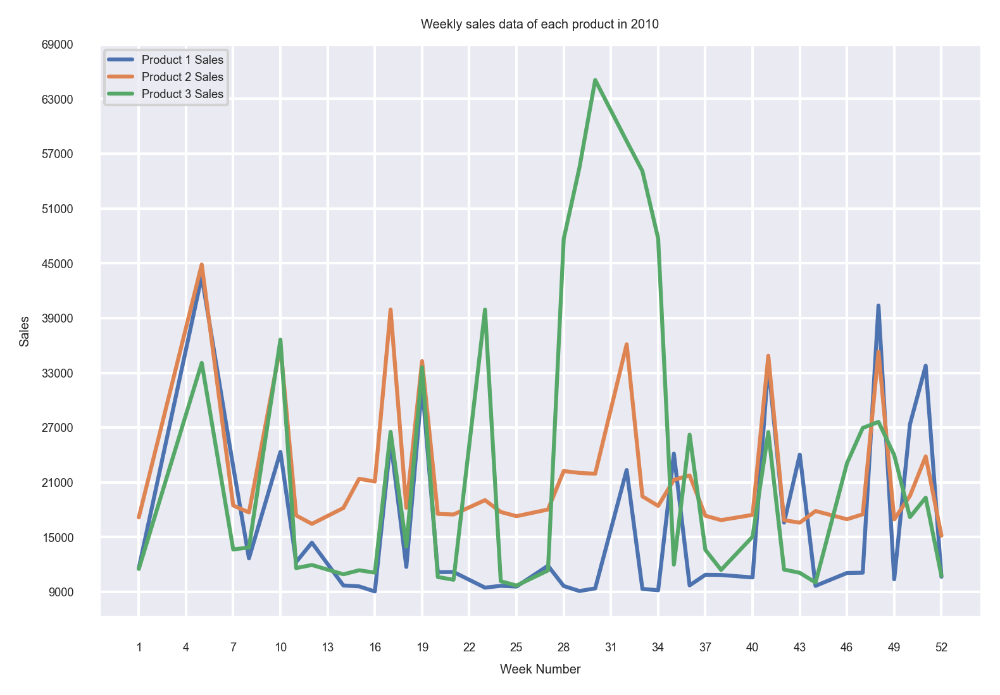

In [46]:
#Weekly sales product wise in 2010

Week1  = df2['week_of_year'].iloc[0 : 41].tolist()
Week2  = df2['week_of_year'].iloc[41 : 41*2].tolist()
Week3  = df2['week_of_year'].iloc[41*2 : 41*3].tolist()

Sales1   = df2['Sales'].iloc[0 : 41].tolist()
Sales2   = df2['Sales'].iloc[41 : 41*2].tolist()
Sales3   = df2['Sales'].iloc[41*2 :41*3].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(9000,70000,6000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each product in 2010')
plt.show()

**Observation**:

• In 2010, sometime product1’s sales get higher while sometimes product2’s sales get higher. Product3’s sales also getting higher in some weeks.

• In first week of 2010, product2 sales is higher than other products and also product1 and product3 sales is almost equal in first week. While in last week, product2 sales is higher than other products and also product1 and product3 sales is almost equal but lower than product2 sales in last week.

• Product3 sales reached to 64000 which is highest, no others product sales reached to 64000 in 2010.

• It seems there is ups and down for each product but product3 sales get much higher (i.e.64000) in week 30 of year 2010.

### Weekly sales in 2011 (Product wise)

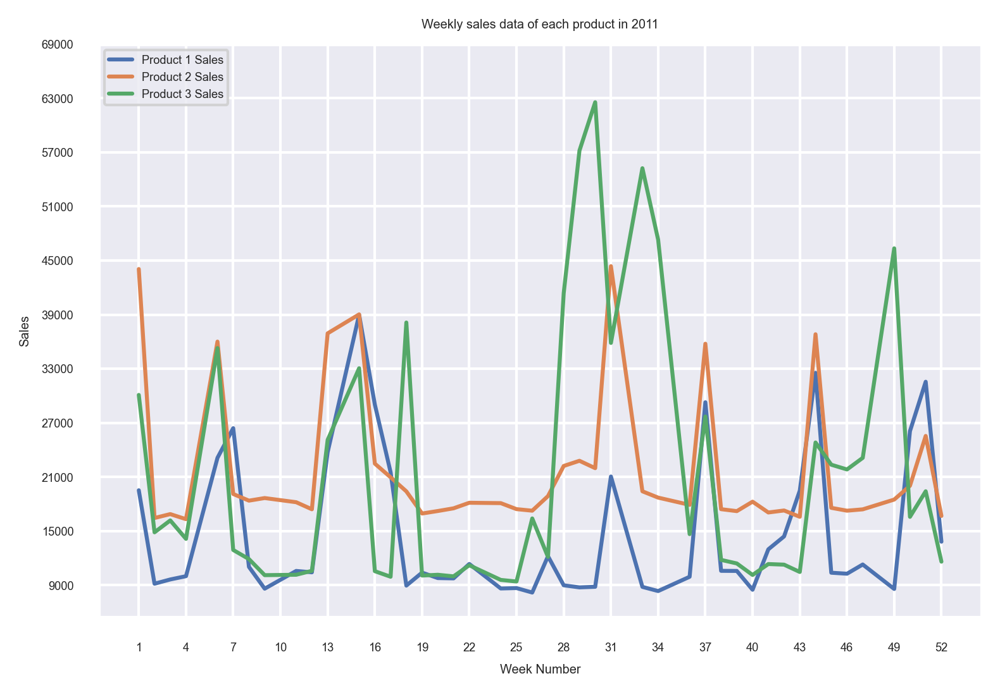

In [47]:
#Weekly sales product wise in 2011

Week1  = df2['week_of_year'].iloc[41*3 : 123+45].tolist()
Week2  = df2['week_of_year'].iloc[123+45 : 123+45+45].tolist()
Week3  = df2['week_of_year'].iloc[123+45+45 : 123+45+45+45].tolist()

Sales1   = df2['Sales'].iloc[41*3 : 123+45].tolist()
Sales2   = df2['Sales'].iloc[123+45 : 123+45+45].tolist()
Sales3   = df2['Sales'].iloc[123+45+45 : 123+45+45+45].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(9000,70000,6000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each product in 2011')
plt.show()

**Observation**:

• In 2011, sometime product1’s sales get higher while sometimes product2’s sales get higher. Product3’s sales also getting higher in some weeks.

• In first week of 2011, product2 sales is higher followed by product3 and product1. While in last week, product2 sales is higher followed by product1 and product3.

• Product3 sales reached to 63000 which is highest, no others product sales reached to 63000 in 2011.

• It seems there is ups and down for each product but product3 sales get much higher (i.e.63000) in week 30 of year 2011.

### Weekly sales in 2012 (Product wise)

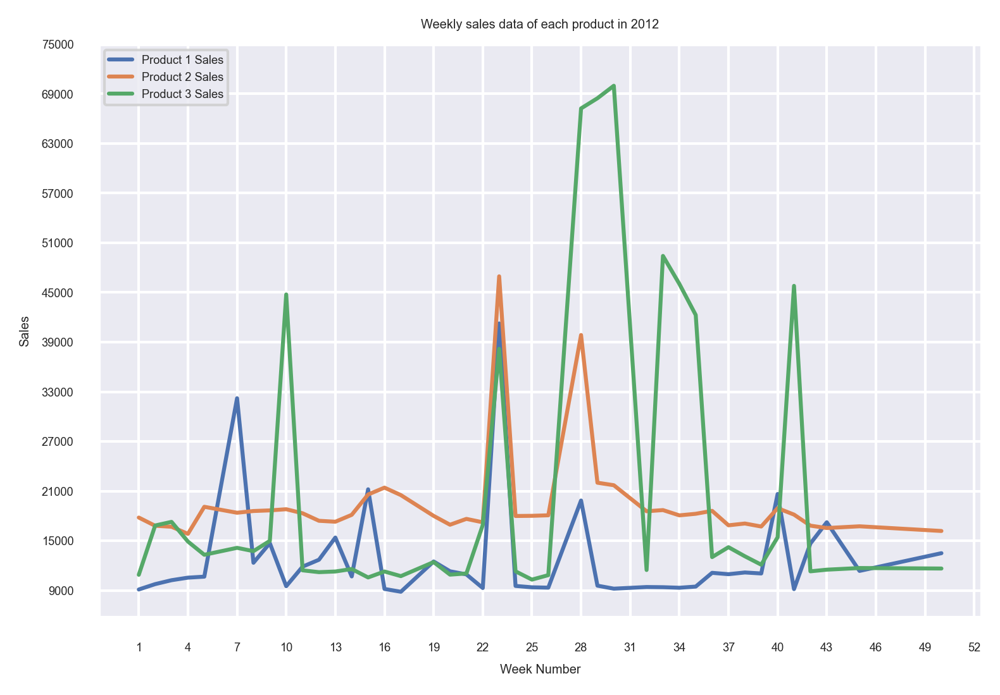

In [48]:
#Weekly sales product wise in 2012

Week1  = df2['week_of_year'].iloc[123+45+45+45 : 123+(45*3)+41].tolist()
Week2  = df2['week_of_year'].iloc[123+(45*3)+41 : 123+(45*3)+(41*2)].tolist()
Week3  = df2['week_of_year'].iloc[123+(45*3)+(41*2) : 123+(45*3)+(41*3)].tolist()

Sales1   = df2['Sales'].iloc[123+45+45+45 : 123+(45*3)+41].tolist()
Sales2   = df2['Sales'].iloc[123+(45*3)+41 : 123+(45*3)+(41*2)].tolist()
Sales3   = df2['Sales'].iloc[123+(45*3)+(41*2) : 123+(45*3)+(41*3)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(9000,76000,6000):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly sales data of each product in 2012')
plt.show()

**Observation**:

• In 2012, sometime product1’s sales get higher while sometimes product2’s sales get higher. Product3’s sales also getting higher in some weeks.

• In first week of 2012, product2 sales is higher followed by product3 and product1. While in last week, product2 sales is higher followed by product1 and product3.

• Product3 sales reached to 70000 which is highest, no others product sales reached to 70000 in 2012.

• It seems there is ups and down for each prQoduct but product3 sales get much higher (i.e.70000) in week 30 of year 2012.

• It seems that product3 sales getting much higher in week 30 of each year.

##### Week 30 means 7th month. We already seen that in 7th month, product 3 sold most and also product 3 sales is much higher in week 30 or 7th month. 

## Weekly unit sold in 2010, 2011, and 2012 (Product wise)

Now, we will plot weekly unit sold in product wise manner. We will plot in similar manner like before in weekly sales (store wise).

In [49]:
df2 = df.groupby(['year', 'Product', 'week_of_year']).agg({'Weekly_Units_Sold':'sum'})
df2.reset_index(inplace=True)

In [50]:
print(df2.year.value_counts())
print(df2.iloc[:123].Product.value_counts())                    #2010
print(df2.iloc[123:123+135].Product.value_counts())             #2011
print(df2.iloc[123+135:123+135+123].Product.value_counts())     #2012

2011    135
2010    123
2012    123
Name: year, dtype: int64
1    41
2    41
3    41
Name: Product, dtype: int64
1    45
2    45
3    45
Name: Product, dtype: int64
1    41
2    41
3    41
Name: Product, dtype: int64


### Weekly unit sold in 2010 (Product wise)

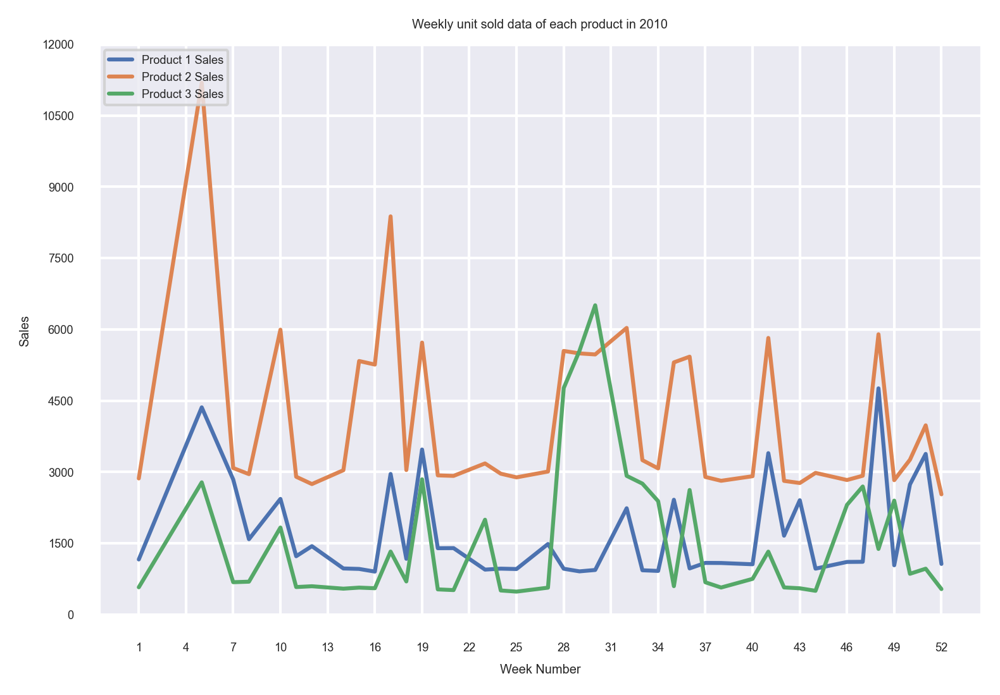

In [51]:
# Weekly Unit Sold, Product wise, in 2010

Week1  = df2['week_of_year'].iloc[0 : 41].tolist()
Week2  = df2['week_of_year'].iloc[41 : 41*2].tolist()
Week3  = df2['week_of_year'].iloc[41*2 : 41*3].tolist()

Sales1   = df2['Weekly_Units_Sold'].iloc[0 : 41].tolist()
Sales2   = df2['Weekly_Units_Sold'].iloc[41 : 41*2].tolist()
Sales3   = df2['Weekly_Units_Sold'].iloc[41*2 :41*3].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,12100,1500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each product in 2010')
plt.show()

**Observation**:

• In 2010, Product2 unit sold is higher than others product but in week 29 and 30, product 3 unit sold is more.

• In first week of 2010, product2 unit sold is higher followed by product1 and product3. While in last week, product2 unit sold is higher followed by product1 and product3.

• Product2 unit sold reached to around 11500 which is highest, no others product unit sold reached to 11500 in 2010.

• It seems there is ups and down for each product but product2 unit sold is much higher (i.e.11500) in week 5 of year 2010.

• Although product2 has more unit sold in most of the weeks in 2010, sales of each product getting ups and down because of promotion effect and different price in different weeks.

### Weekly unit sold in 2011 (Product wise)

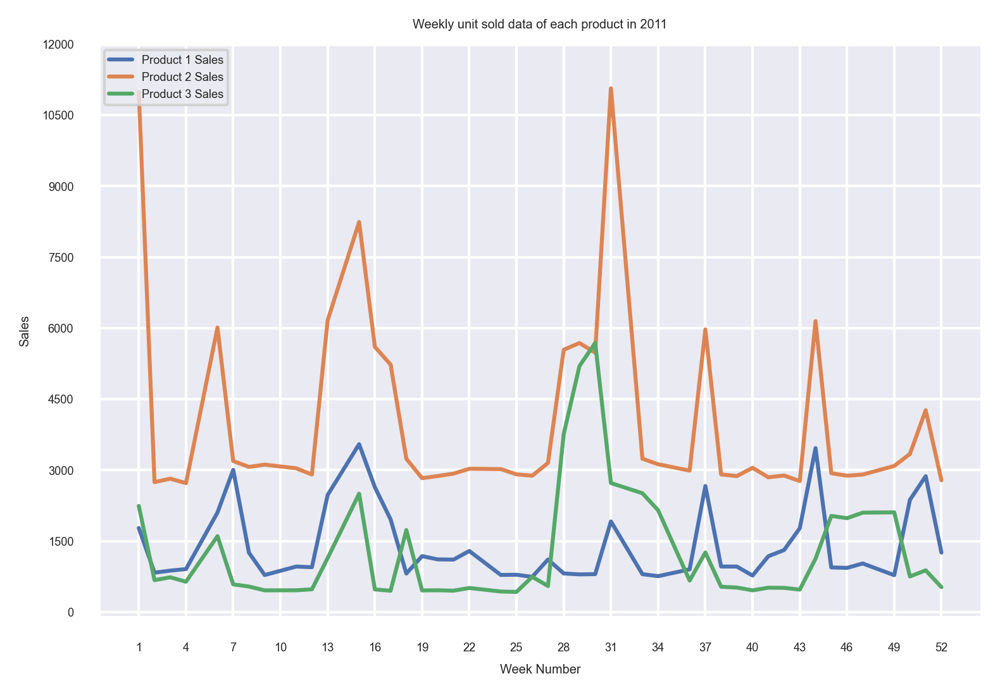

In [52]:
# Weekly Unit Sold, Product wise, in 2011

Week1  = df2['week_of_year'].iloc[41*3 : 123+45].tolist()
Week2  = df2['week_of_year'].iloc[123+45 : 123+45+45].tolist()
Week3  = df2['week_of_year'].iloc[123+45+45 : 123+45+45+45].tolist()

Sales1   = df2['Weekly_Units_Sold'].iloc[41*3 : 123+45].tolist()
Sales2   = df2['Weekly_Units_Sold'].iloc[123+45 : 123+45+45].tolist()
Sales3   = df2['Weekly_Units_Sold'].iloc[123+45+45 : 123+45+45+45].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,12100,1500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each product in 2011')
plt.show()

**Observation**:

• In 2011, Product2 unit sold is higher than others product but in week 29, product 3 unit sold is more.

• In first week of 2011, product2 unit sold is higher followed by product3 and product1. While in last week, product2 unit sold is higher followed by product1 and product3.

• Product2 unit sold reached to around 11500 which is highest, no others product unit sold reached to 11500 in 2011.

• It seems there is ups and down for each product but product2 unit sold is much higher (i.e.11500) in week 5 and week 1 of year 2011.

• Although product2 has more unit sold in most of the weeks in 2011, sales of each product getting ups and down because of promotion effect and different price in different weeks.

## Weekly unit sold in 2012 (Product wise)

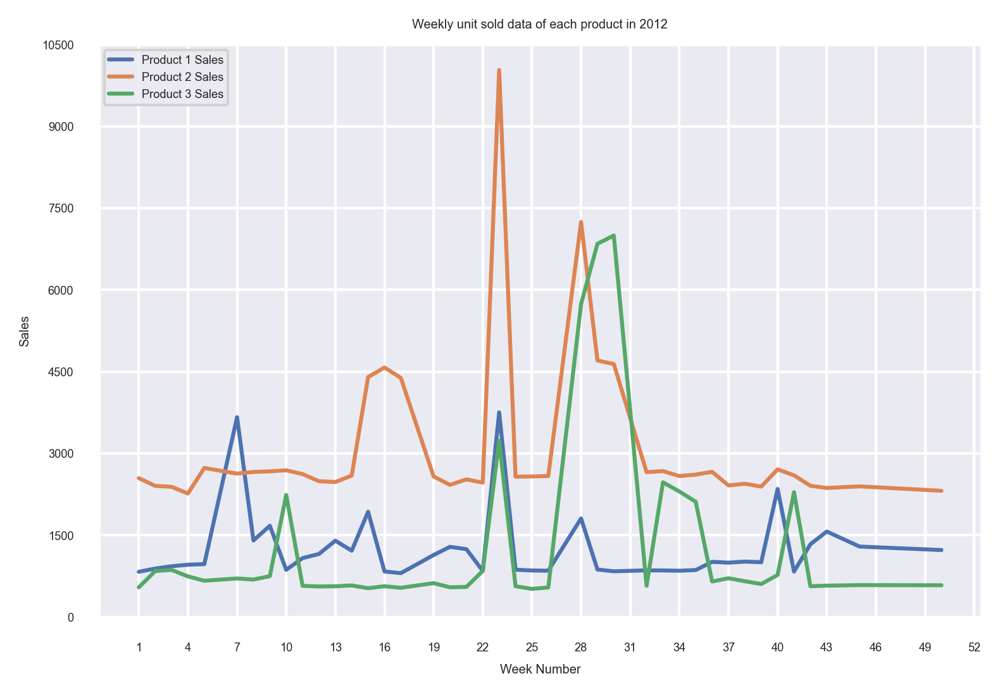

In [53]:
# Weekly Unit Sold, Product wise, in 2012

Week1  = df2['week_of_year'].iloc[123+45+45+45 : 123+(45*3)+41].tolist()
Week2  = df2['week_of_year'].iloc[123+(45*3)+41 : 123+(45*3)+(41*2)].tolist()
Week3  = df2['week_of_year'].iloc[123+(45*3)+(41*2) : 123+(45*3)+(41*3)].tolist()

Sales1   = df2['Weekly_Units_Sold'].iloc[123+45+45+45 : 123+(45*3)+41].tolist()
Sales2   = df2['Weekly_Units_Sold'].iloc[123+(45*3)+41 : 123+(45*3)+(41*2)].tolist()
Sales3   = df2['Weekly_Units_Sold'].iloc[123+(45*3)+(41*2) : 123+(45*3)+(41*3)].tolist()

y = []
z = []
for i in range(1,53,3):
    y.append(i)
for i in range(0,10600,1500):
    z.append(i)

plt.plot(Week1, Sales1, label = 'Product 1 Sales')
plt.plot(Week2, Sales2, label = 'Product 2 Sales')
plt.plot(Week3, Sales3, label = 'Product 3 Sales')
plt.xlabel('Week Number')
plt.ylabel('Sales')
plt.legend(loc='upper left')
plt.xticks(y)
plt.yticks(z)
plt.title('Weekly unit sold data of each product in 2012')
plt.show()

**Observation**:

• In 2012, Product2 unit sold is higher than others product but in week 6, 7, and 8 product 1 unit sold is more and in week 29, 30, and 31, product 3 unit sold is more.

• In first week of 2012, product2 unit sold is higher followed by product1 and product3. While in last week, product2 unit sold is higher followed by product1 and product3.

• Product2 unit sold reached to around 10000 which is highest, no others product unit sold reached to 10000 in 2012.

• It seems there is ups and down for each product but product2 unit sold is much higher (i.e.10000) in week 23 of year 2012.

• Although product2 has more unit sold in most of the weeks in 2012, sales of each product getting ups and down because of promotion effect and different price in different weeks.

# Analysing holidays

<Figure size 3600x2100 with 0 Axes>

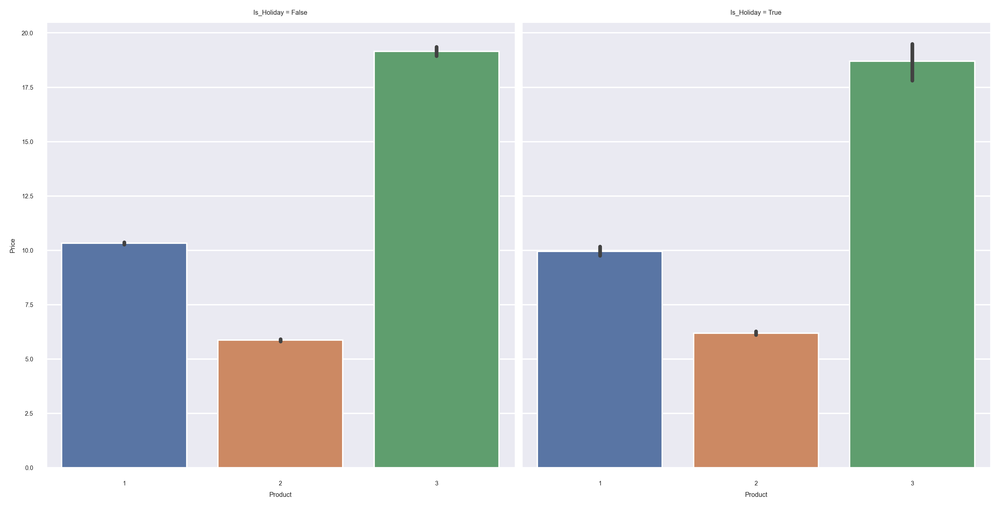

In [54]:
plt.figure(figsize=(12,7))
sns.catplot(x='Product', y='Price', col='Is_Holiday', kind="bar", data=df)

**Observations**:

• By using seaborn and catplot, we can observe that product3 is costly in holidays as well as in non-holidays.

• Product price is not affected so much in holidays. It means, price of all product remains almost same in holidays as compare to non holidays.

• Product3 is more costly than others while product 2 is of less price as compare to other products.

<Figure size 3600x2100 with 0 Axes>

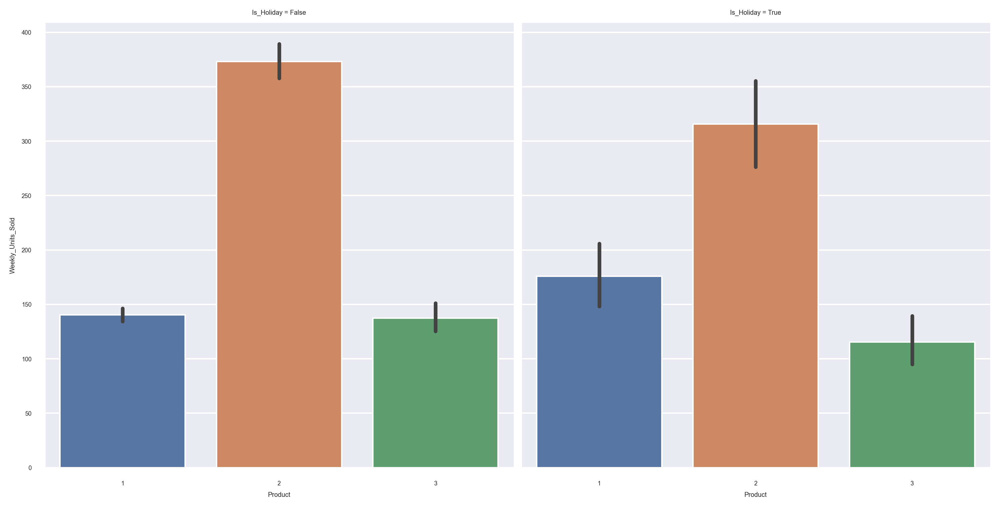

In [55]:
plt.figure(figsize=(12,7))
sns.catplot(x='Product', y='Weekly_Units_Sold', col='Is_Holiday', kind="bar", data=df)

**Observations**:

• Product 2 sold is highest in both holidays and non-holidays but product 2 sold more in non-holidays as compare to holidays.

• Product 1 sold slightly more in holidays (as compare to product 1 sold in non-holidays).

• Product 3 sold equally in holidays and non-holidays but product 3 sold much lower than other products.

<Figure size 3600x2100 with 0 Axes>

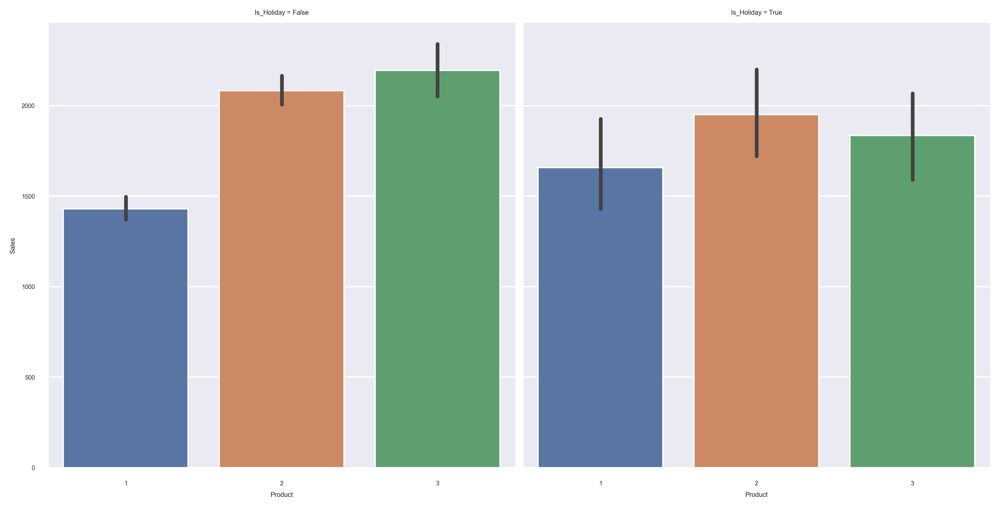

In [56]:
plt.figure(figsize=(12,7))
sns.catplot(x='Product', y='Sales', col='Is_Holiday', kind="bar", data=df)

**Observations**:

• Product 3 sales is more than any other products in non-holidays. While in holidays, product 2 sales is slightly more than product 3.

• Product 2 and 3 sales got lower in holidays. While product 1 sales increases (but not more than product 2 and product 3) in holidays. Product 3 sales is highest in non holidays while in holidays product 2 sales is highest.

• It can be observed that there is competition between product 2 and product 3.

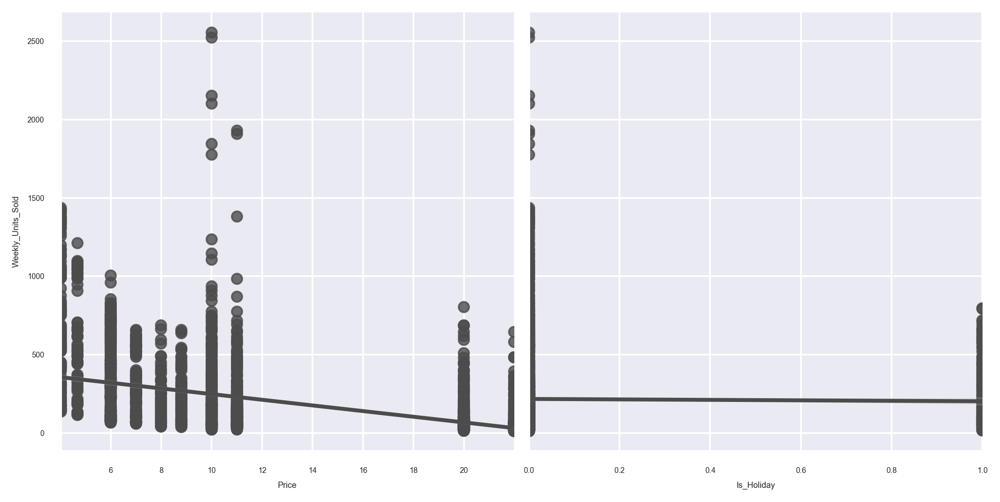

In [148]:
g = sns.PairGrid(df, y_vars=["Weekly_Units_Sold"], x_vars=["Price", "Is_Holiday"], height=4)
g.map(sns.regplot, color=".3")

**Observations**:

• From these graph, we can say that product is selling more in non-holidays.

• Product is selling more if price is lower. Especially, if price is 10 per unit, then it is selling more. Above 20 per unit price, sales becomes low.

D:\Anaconda\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Anaconda\lib\site-packages\seaborn\distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)
D:\Anaconda\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Anaconda\lib\site-packages\seaborn\distributions.py:2056: FutureWarning: The `axis` variable

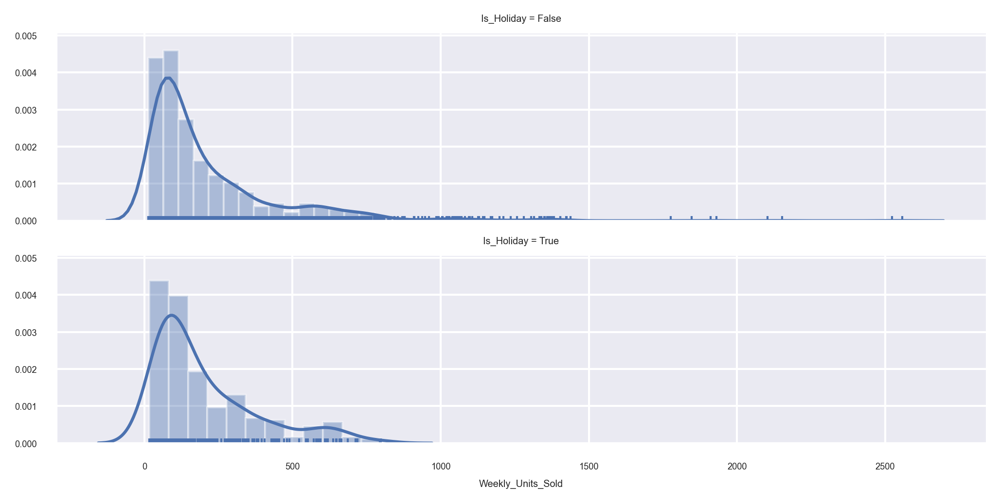

In [58]:
g = sns.FacetGrid(df, row="Is_Holiday", height=1.7, aspect=4)
g.map(sns.distplot, "Weekly_Units_Sold", rug=True)

D:\Anaconda\lib\site-packages\seaborn\categorical.py:3714: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


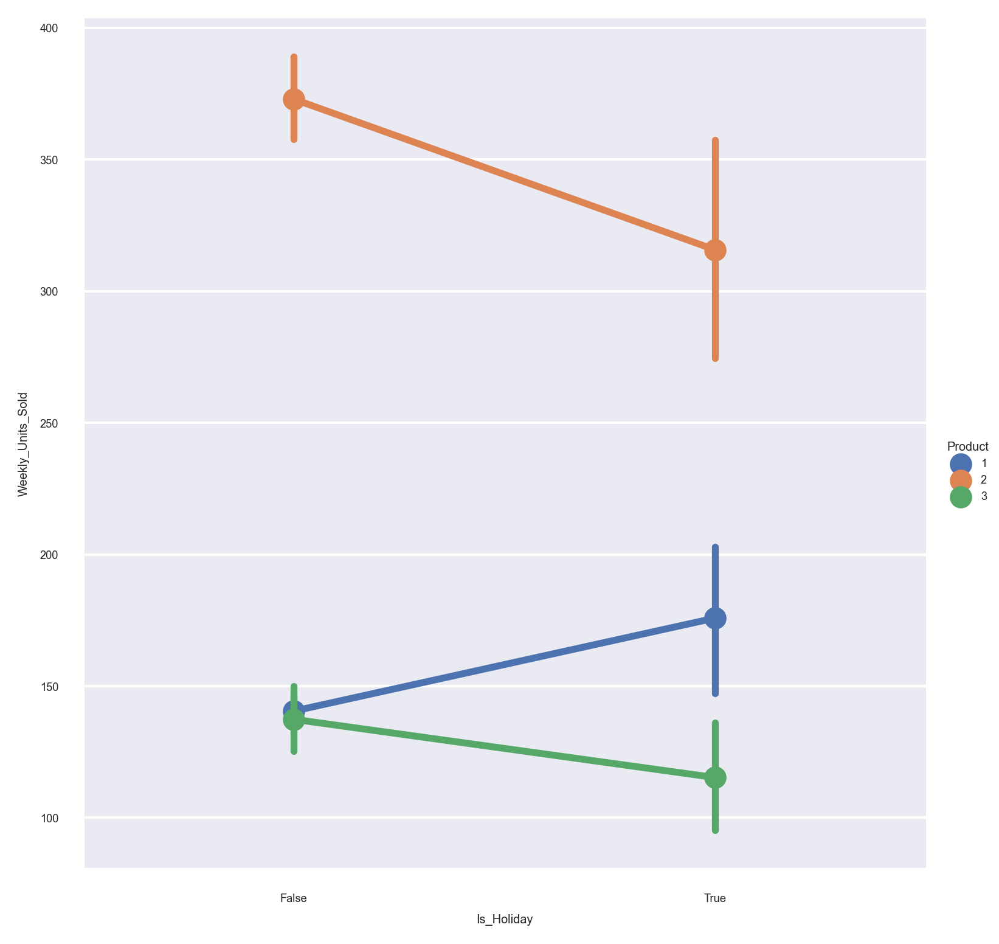

In [59]:
sns.factorplot(data= df,  x= 'Is_Holiday', y= 'Weekly_Units_Sold', hue= 'Product')

**Observations**:

• From this graph, we can clearly observe that Product 3 and 2 unit
sales getting low during holidays.

• Product 1 and product 3 unit sales is almost same in non-holidays
But in holidays, product 1 unit sales getting increase and product 3 unit
sales getting lower. Although product 1 sales increasing, it didn't cross product
2 unit sales.

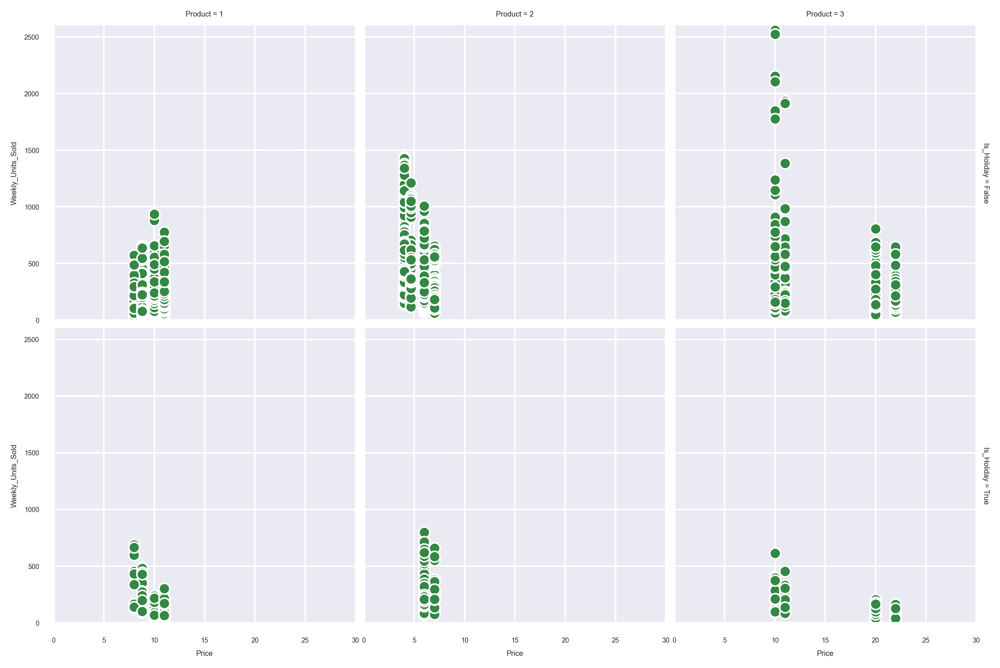

In [60]:
g = sns.FacetGrid(df, col="Product", row="Is_Holiday", margin_titles=True, height=3)
g.map(plt.scatter, "Price", "Weekly_Units_Sold", color="#338844", edgecolor="white", s=50, lw=1)
g.set(xlim=(0, 30), ylim=(0, 2600))

**Observations**:

• Product 3 is selling in two different price(gap between the price is quite high). Lower price one selling more.

• In holidays, each product unit selling decrease as compare to non-holidays.

• In non-holidays, product 3 is selling more than any other product.

D:\Anaconda\lib\site-packages\seaborn\categorical.py:3714: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


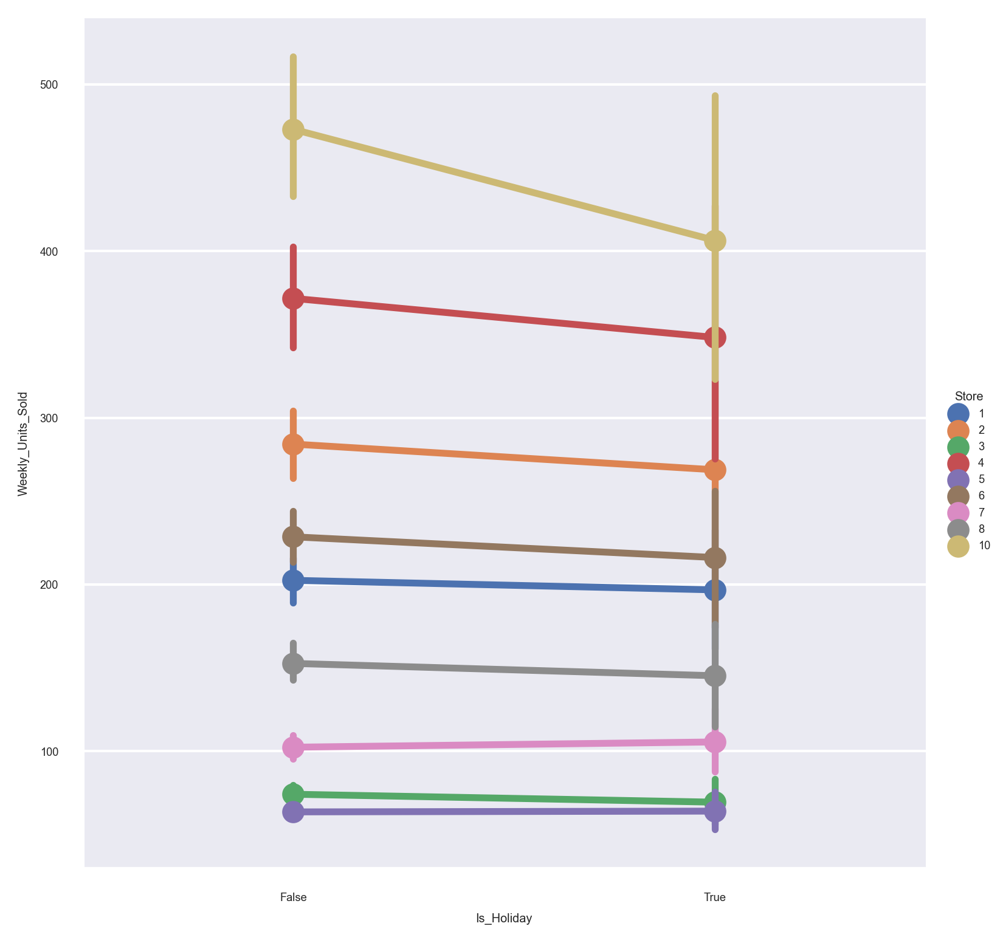

In [61]:
sns.factorplot(data= df, x= 'Is_Holiday', y= 'Weekly_Units_Sold', hue= 'Store')

**Observations**:

• Store 10 selling is more in both holidays and non-holidays.

• Store 10 unit selling decreasing in holidays.

• For other products, unit sell is either decreasing or remaining same.

• Store 10 has sold more units while unit selling of store 5 is least.

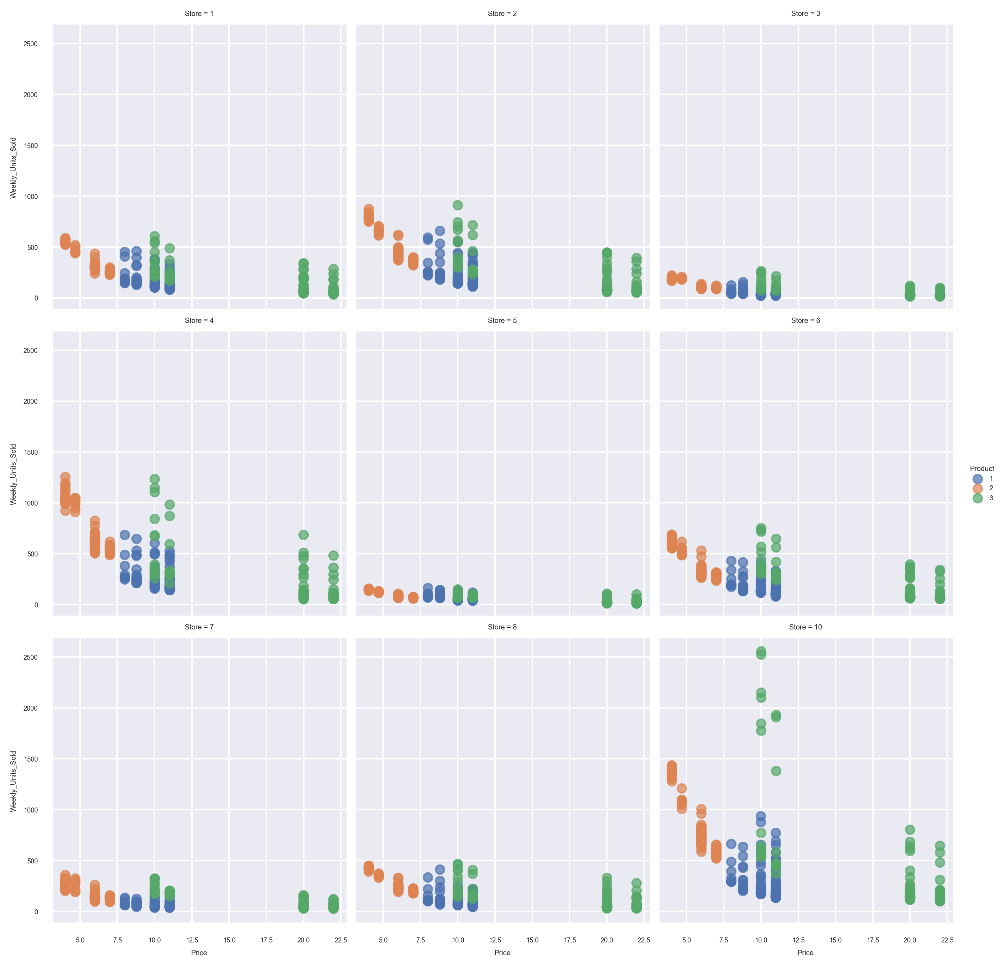

In [62]:
g = sns.FacetGrid(df, col="Store", hue="Product", margin_titles=True, col_wrap=3)
g.map(plt.scatter, 'Price', 'Weekly_Units_Sold', alpha=.7)
g.add_legend()

**Observations**:

• Product 3 unit is more selling in store 10.
In other store also, product 3 selling more than any
other product.

D:\Anaconda\lib\site-packages\seaborn\categorical.py:3714: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


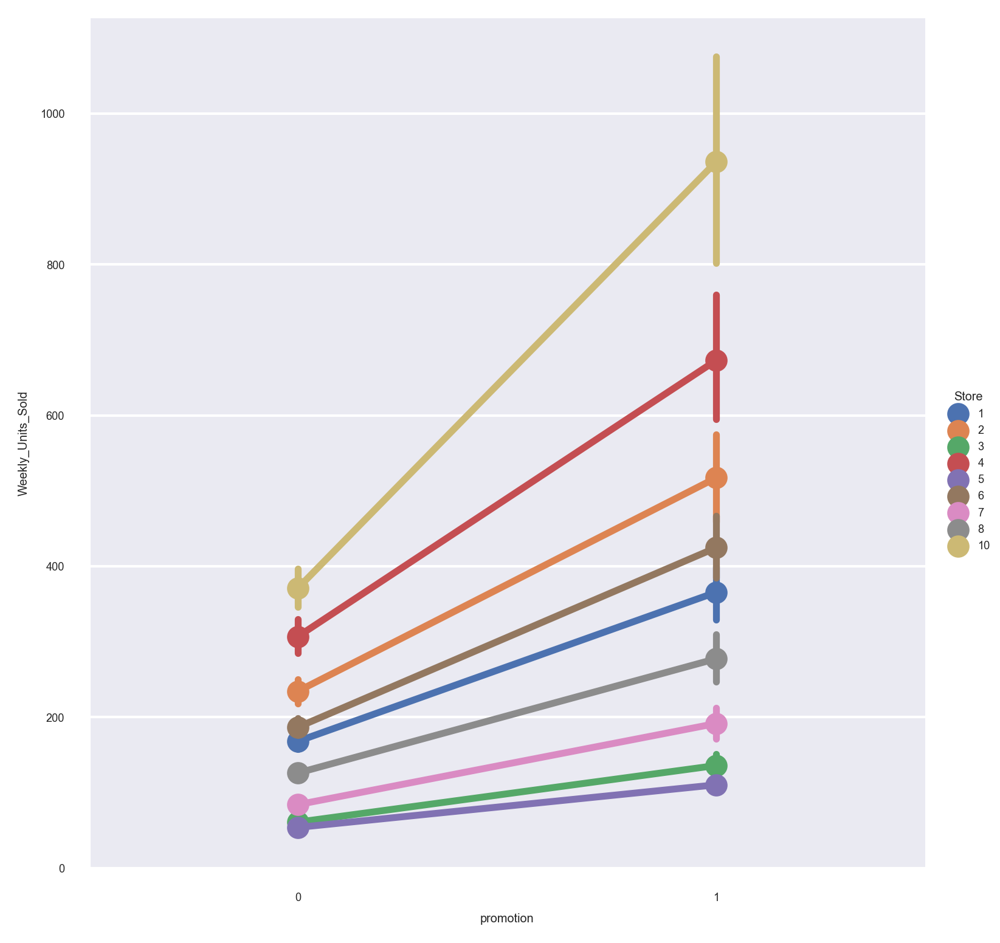

In [63]:
sns.factorplot(data= df, x= 'promotion', y= 'Weekly_Units_Sold', hue= 'Store')

**Observation**:

• Promotion increasing unit sales of each store.

• Store 10 unit sales increasing so much if they applied promotions.

D:\Anaconda\lib\site-packages\seaborn\categorical.py:3714: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


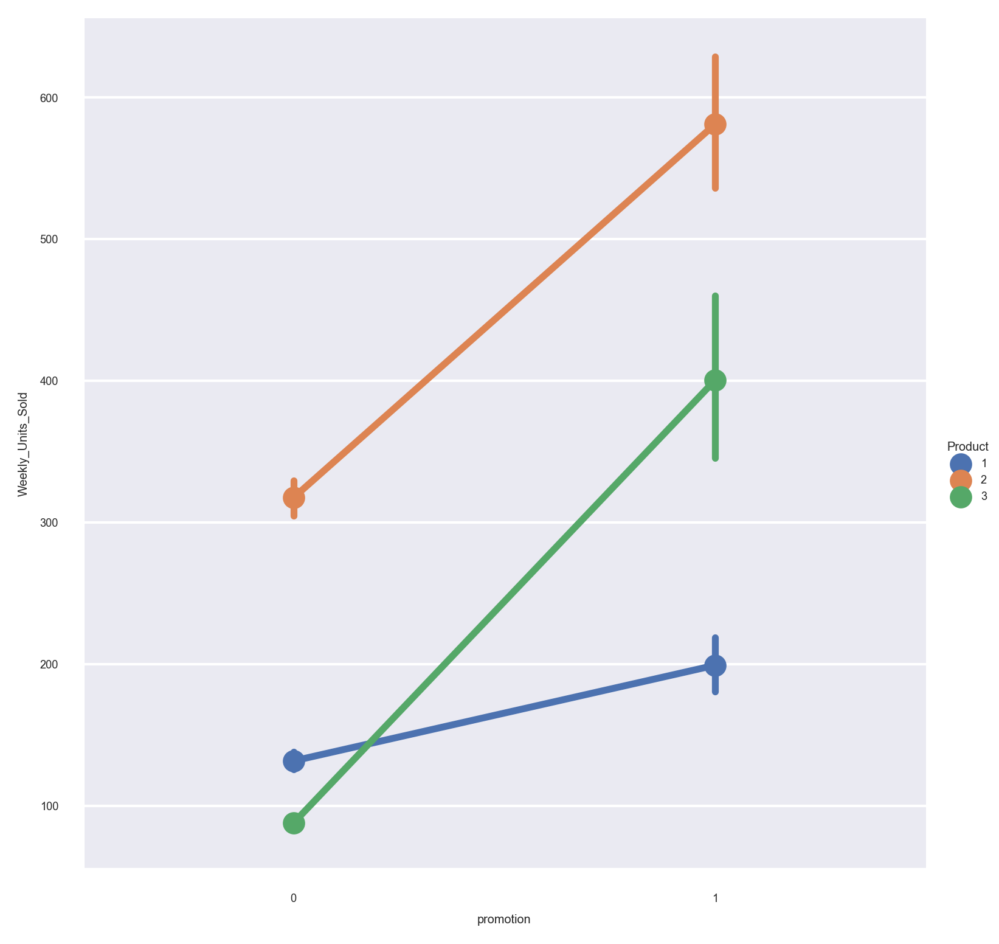

In [64]:
sns.factorplot(data= df, x= 'promotion', y= 'Weekly_Units_Sold', hue= 'Product')

**Observation**:

• Promotion increasing unit sales of each product.

• Due to promotion effect, product 3 sales goes up as compare to product 1.

• Product 2 unit sales always staying at top, promotion effect also increasing product 1 sales.

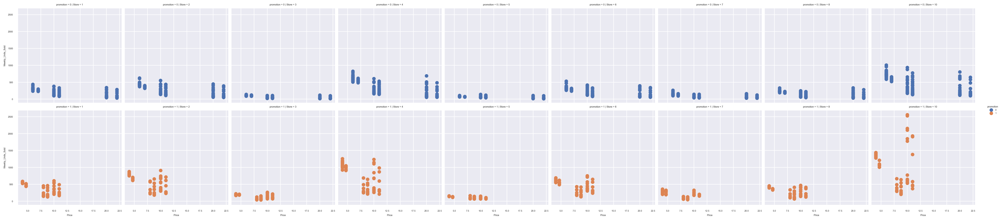

In [65]:
g = sns.FacetGrid(df, col="Store", hue="promotion", row='promotion')
g.map(plt.scatter, "Price", "Weekly_Units_Sold").add_legend()

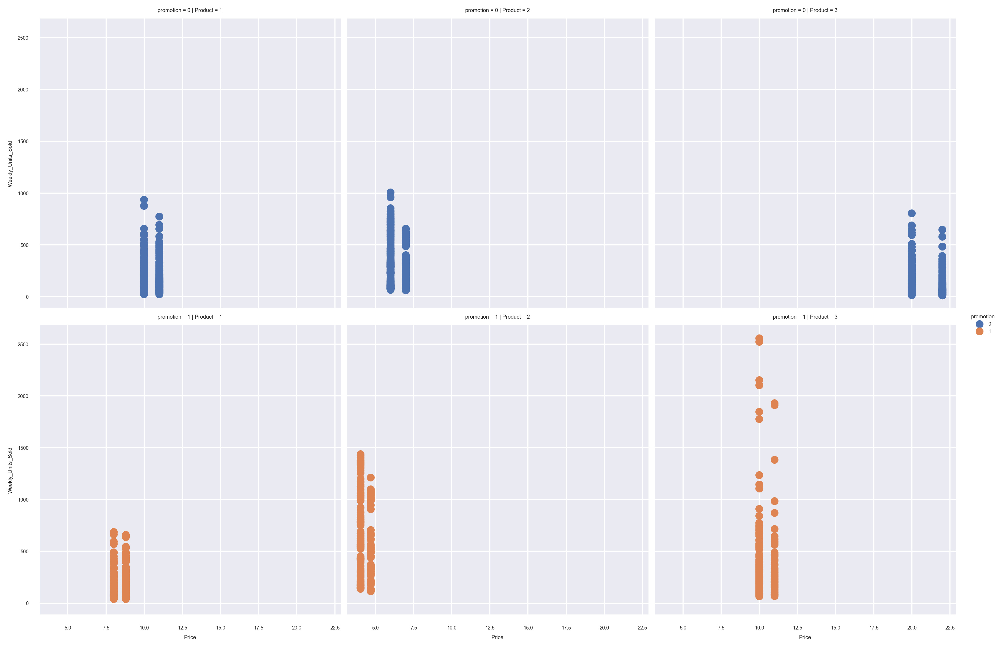

In [66]:
g = sns.FacetGrid(df, hue="promotion", col="Product", row='promotion', height=4)
g.map(plt.scatter, "Price", "Weekly_Units_Sold").add_legend()

# Seasonality

I will use seasonal_decompose method to check seasonality of each product and each store.

## Seasonality - Product wise

In [21]:
df1 = df.groupby(['Product', 'Date']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
df1['Date'] = pd.to_datetime(df1['Date'])
df1.set_index('Date', inplace=True)
print(df1.Product.value_counts())
df1.head()

1    143
2    143
3    143
Name: Product, dtype: int64


,Product,Sales
Date,,
2010-01-10,1,11598.39
2010-02-04,1,33636.33
2010-02-07,1,9920.07
2010-02-19,1,22715.57
2010-02-26,1,12680.13


The first 143 rows contain product 1 info. Next 143 rows contain product 2 info and 286 to 429 rows contains product 3 information

### Product 1 seasonality

Product 1 seasonality


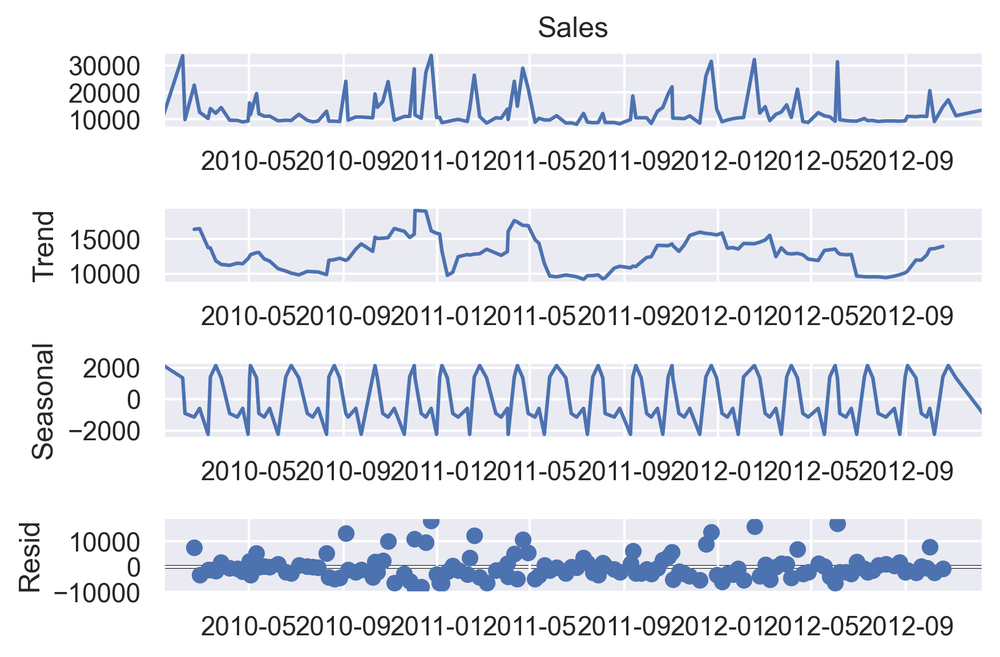

In [32]:
print("Product 1 seasonality")
result= seasonal_decompose(df1.iloc[143*0:143*1].Sales, period=7)
k = result.plot()

**Observation**:

• We can clearly observe that product 1 has seasonality.

### Product 2 seasonality

Product 2 seasonality


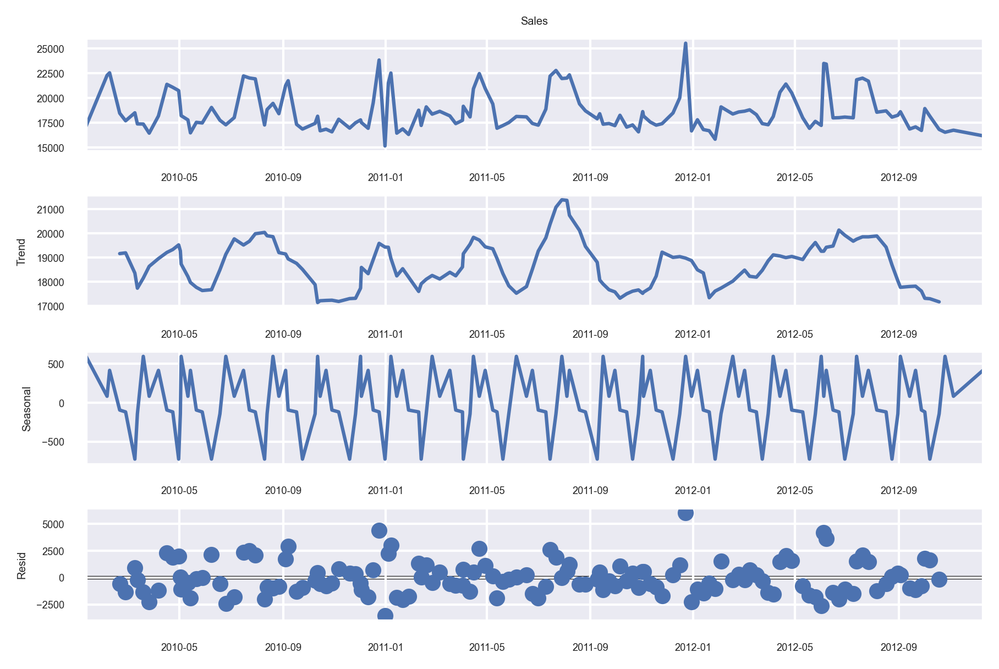

In [69]:
print("Product 2 seasonality")
result= seasonal_decompose(df1.iloc[143*1:143*2].Sales, period=7)
k = result.plot()

**Observation**:

• We can clearly observe that product 2 has seasonality.

### Product 3 seasonality

Product 3 seasonality


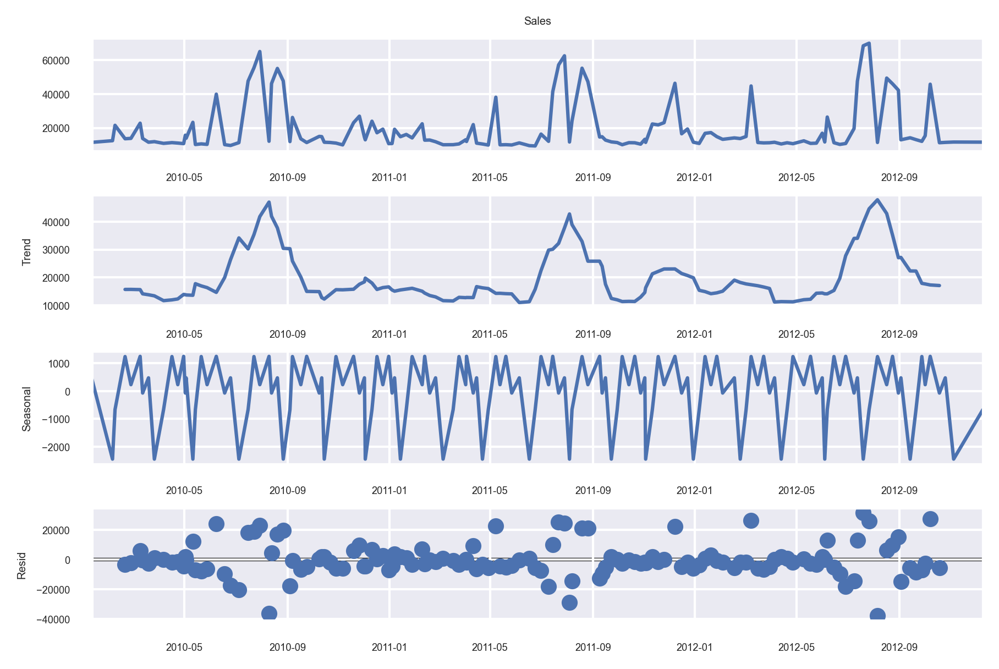

In [70]:
print("Product 3 seasonality")
result= seasonal_decompose(df1.iloc[143*2:143*3].Sales, period=7)
k = result.plot()

**Observation**:

• We can clearly observe that product 3 has seasonality.

## Seasonality - Store wise

In [71]:
df1 = df.groupby(['Store','Date']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
df1.set_index('Date',inplace=True)
print(df1.Store.value_counts())
df1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64


,Store,Sales
Date,,
2010-01-10,1,4464.96
2010-02-04,1,7629.20
2010-02-07,1,5472.63
2010-02-19,1,6717.95
2010-02-26,1,4772.40


### Store 1 seasonality

Store 1 seasonality


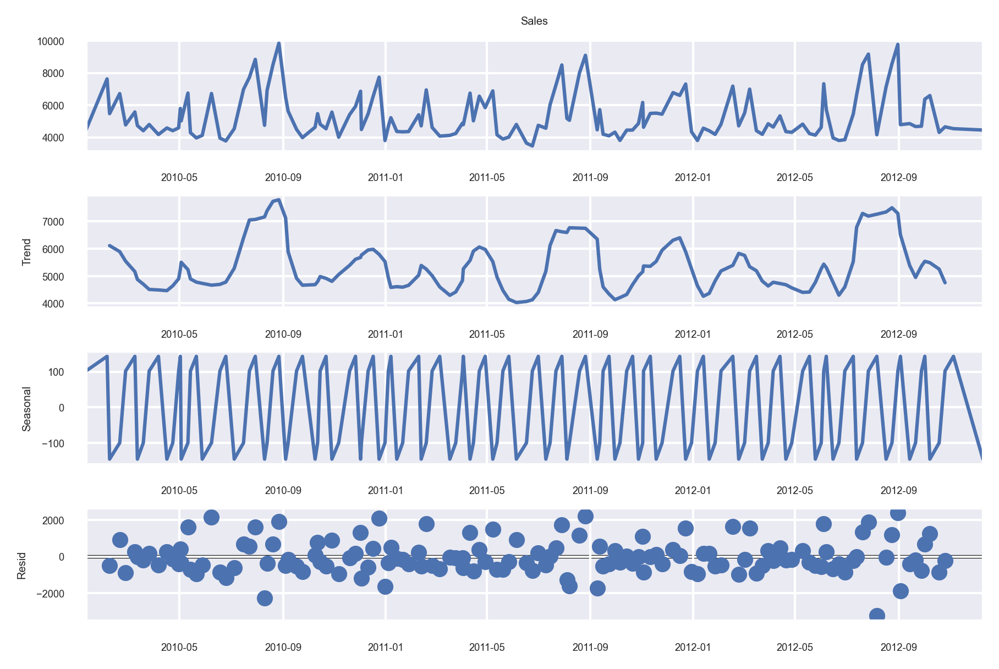

In [72]:
print("Store 1 seasonality")
result= seasonal_decompose(df1.iloc[0:143].Sales, period=4)
k = result.plot()

### Store 2 seasonality

Store 2 seasonality


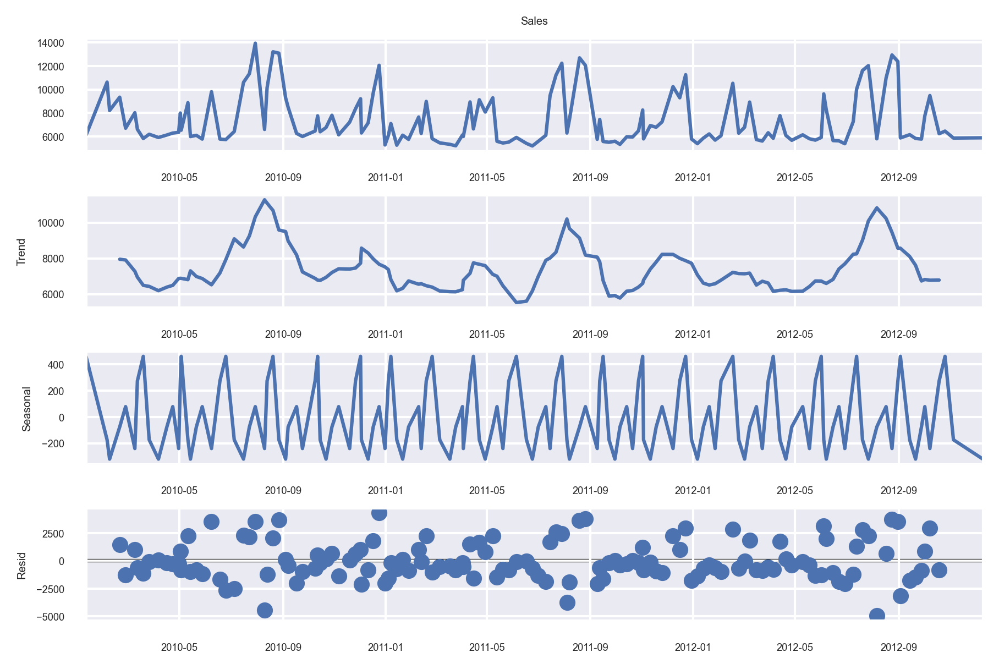

In [73]:
print("Store 2 seasonality")
result= seasonal_decompose(df1.iloc[143*1:143*2].Sales, period=7)
k = result.plot()

### Store 3 seasonality

Store 3 seasonality


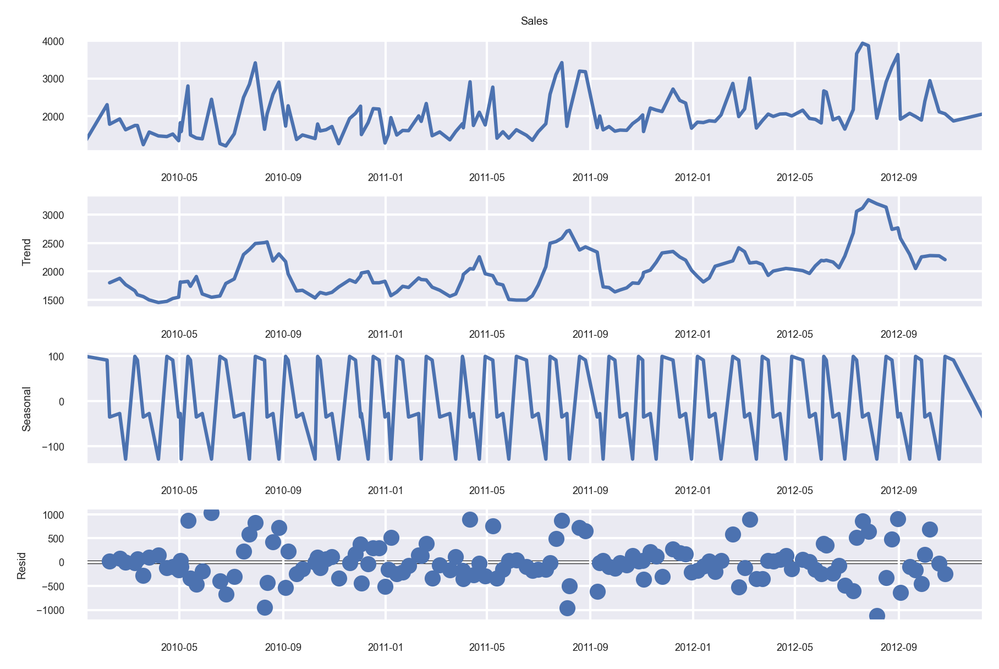

In [74]:
print("Store 3 seasonality")
result= seasonal_decompose(df1.iloc[143*2:143*3].Sales, period=5)
k = result.plot()

### Store 4 seasonality

Store 4 seasonality


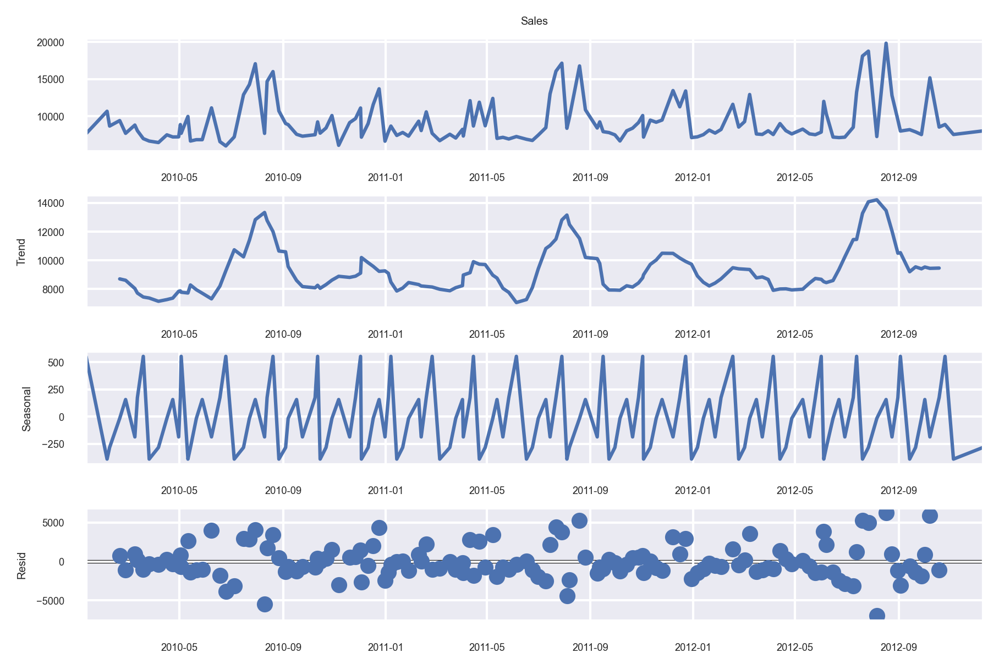

In [75]:
print("Store 4 seasonality")
result= seasonal_decompose(df1.iloc[143*3:143*4].Sales, period=7)
k = result.plot()

### Store 5 seasonality

Store 5 seasonality


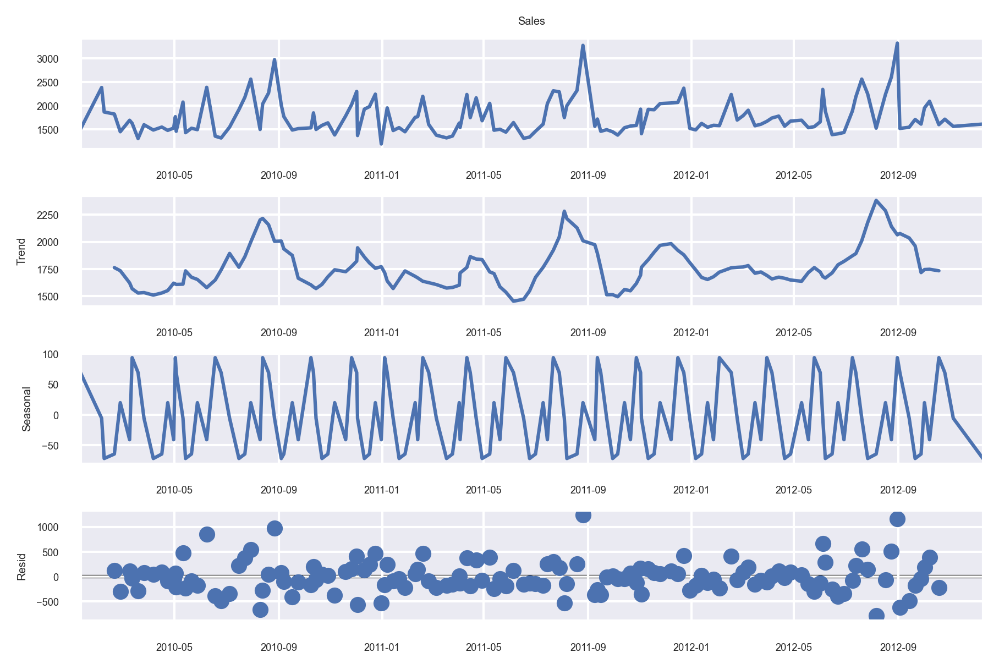

In [76]:
print("Store 5 seasonality")
result= seasonal_decompose(df1.iloc[143*4:143*5].Sales, period=7)
k = result.plot()

### Store 6 seasonality

Store 6 seasonality


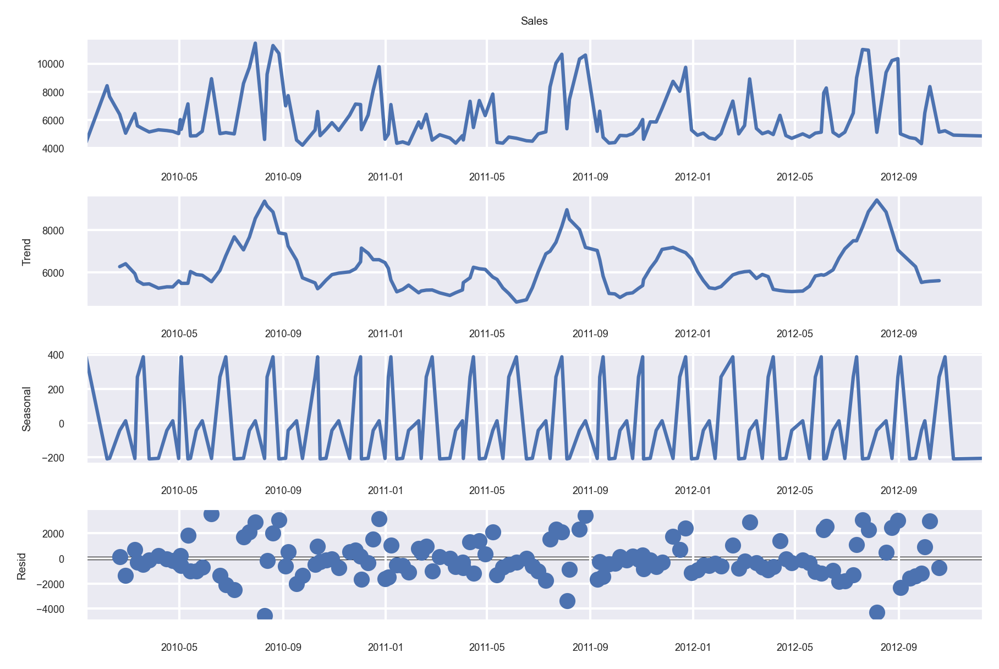

In [77]:
print("Store 6 seasonality")
result= seasonal_decompose(df1.iloc[143*5:143*6].Sales, period=7)
k = result.plot()

### Store 7 seasonality

Store 7 seasonality


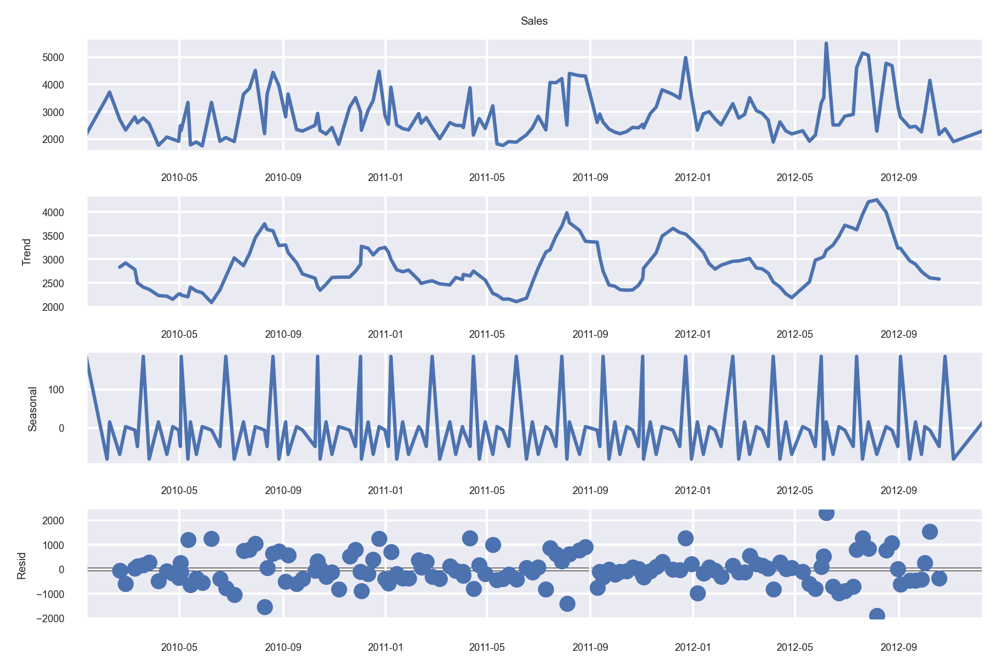

In [78]:
print("Store 7 seasonality")
result= seasonal_decompose(df1.iloc[143*6:143*7].Sales, period=7)
k = result.plot()

### Store 8 seasonality

Store 8 seasonality


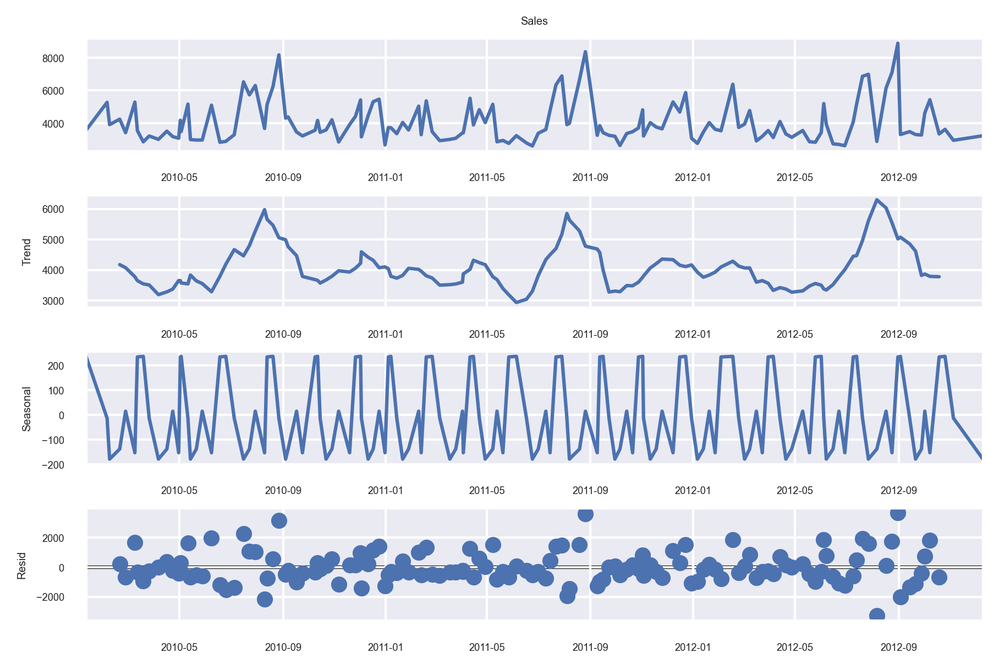

In [79]:
print("Store 8 seasonality")
result= seasonal_decompose(df1.iloc[143*7:143*8].Sales, period=7)
k = result.plot()

### Store 10 seasonality

Store 10 seasonality


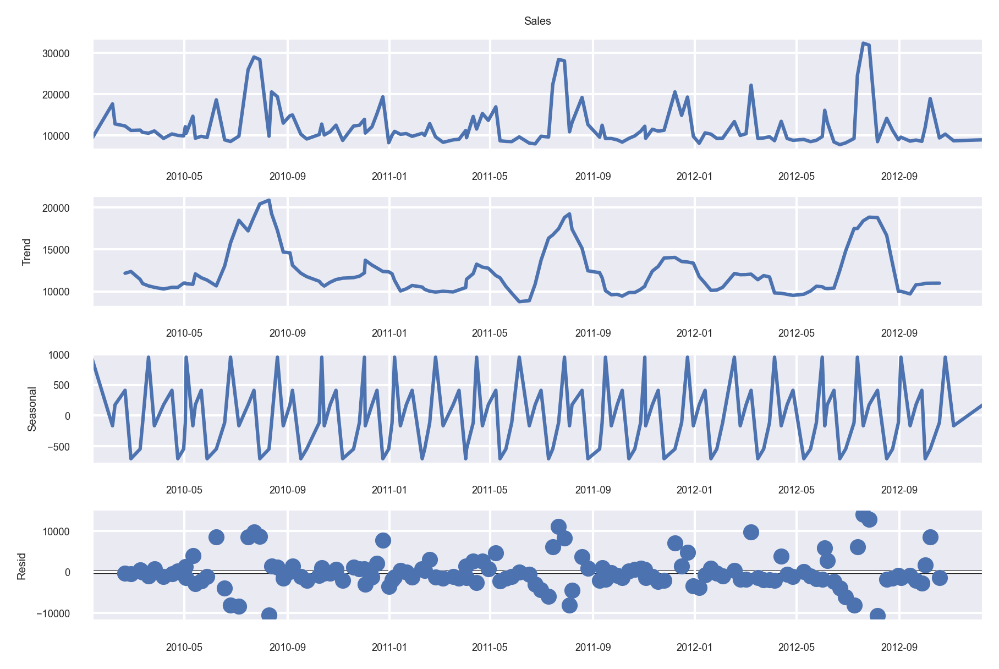

In [80]:
print("Store 10 seasonality")
result= seasonal_decompose(df1.iloc[143*8:143*9].Sales, period=7)
k = result.plot()

**Observations:**

• All stores has some kind of seasonality but don't have any trend.

In [81]:
df.columns

Index(['Date', 'Store', 'Product', 'Is_Holiday', 'Base Price', 'Price',
       'Weekly_Units_Sold', 'Sales', 'year', 'month', 'day', 'week_of_year',
       'promotion'],
      dtype='object')

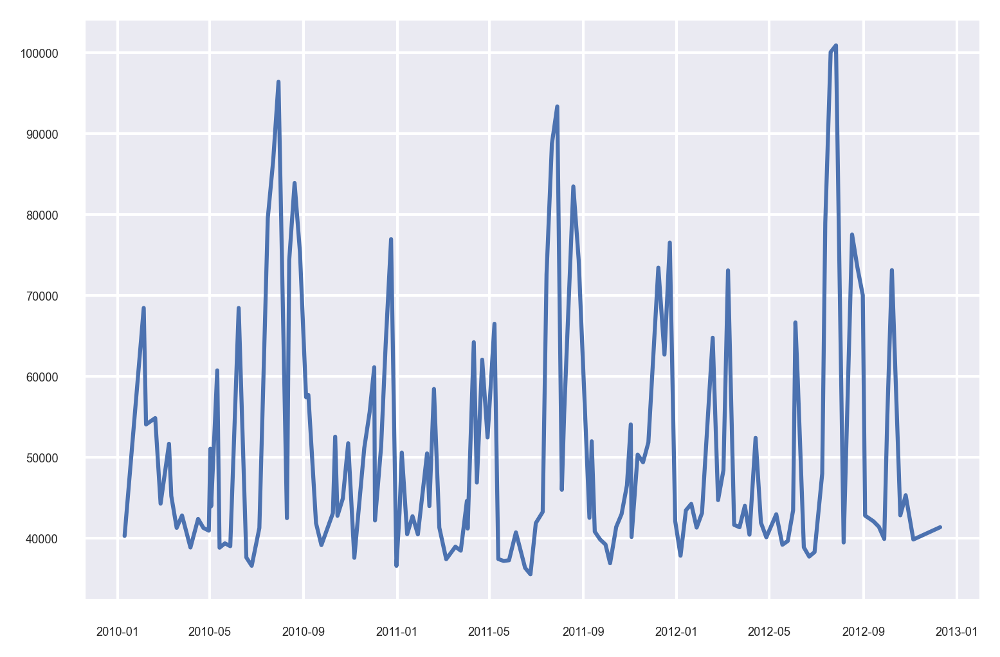

In [82]:
df1 = df.groupby(['Date']).agg({"Sales":"sum"})
plt.plot(df1)

# Time Series Forecasting with FbProphet

In [83]:
df.columns

Index(['Date', 'Store', 'Product', 'Is_Holiday', 'Base Price', 'Price',
       'Weekly_Units_Sold', 'Sales', 'year', 'month', 'day', 'week_of_year',
       'promotion'],
      dtype='object')

## Store 1 Forecasting

In [33]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)

print(s1.Store.value_counts())

s1.drop(s1.index[143:] , axis=0, inplace=True)
display(s1.tail())

s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64


,Store,Date,Sales
138,1,2012-10-08,6596.61
139,1,2012-10-19,4306.70
140,1,2012-10-26,4652.42
141,1,2012-11-05,4538.19
142,1,2012-12-10,4453.68


,ds,y
0,2010-01-10,4464.96
1,2010-02-04,7629.20
2,2010-02-07,5472.63
3,2010-02-19,6717.95
4,2010-02-26,4772.40


In [151]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

In [53]:
model = Prophet()
model.fit(s1)
model.component_modes

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


{'additive': ['yearly',
  'weekly',
  'additive_terms',
  'extra_regressors_additive',
  'holidays'],
 'multiplicative': ['multiplicative_terms', 'extra_regressors_multiplicative']}

In [54]:
s1.tail()

,ds,y
138,2012-10-08,6596.61
139,2012-10-19,4306.70
140,2012-10-26,4652.42
141,2012-11-05,4538.19
142,2012-12-10,4453.68


In [55]:
future_dates = model.make_future_dataframe(periods = 50, freq='W')
future_dates

,ds
0,2010-01-10
1,2010-02-04
2,2010-02-07
3,2010-02-19
4,2010-02-26
...,...
188,2013-10-27
189,2013-11-03
190,2013-11-10
191,2013-11-17


In [56]:
forecast = model.predict(future_dates)

forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,...,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2010-01-10,5436.560305,2950.577887,5092.225054,5436.560305,5436.560305,-1442.557407,...,-1259.548176,-1259.548176,-1259.548176,0.0,0.0,0.0,3994.002898
1,2010-02-04,5432.894419,4783.245127,7062.908516,5432.894419,5432.894419,419.890863,...,43.823864,43.823864,43.823864,0.0,0.0,0.0,5852.785282
2,2010-02-07,5432.454513,4524.076518,6524.352429,5432.454513,5432.454513,53.088461,...,236.097692,236.097692,236.097692,0.0,0.0,0.0,5485.542974
3,2010-02-19,5430.694888,4982.991326,7253.608451,5430.694888,5430.694888,701.862389,...,672.507297,672.507297,672.507297,0.0,0.0,0.0,6132.557277
4,2010-02-26,5429.668440,4633.907655,6843.634902,5429.668440,5429.668440,364.362437,...,335.007345,335.007345,335.007345,0.0,0.0,0.0,5794.030877


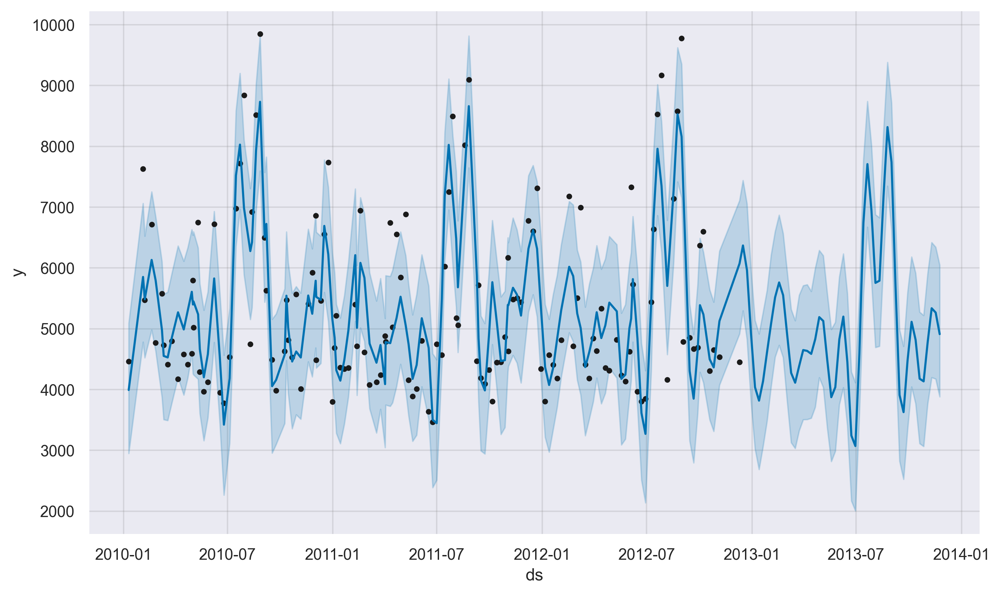

In [57]:
k = model.plot(forecast)

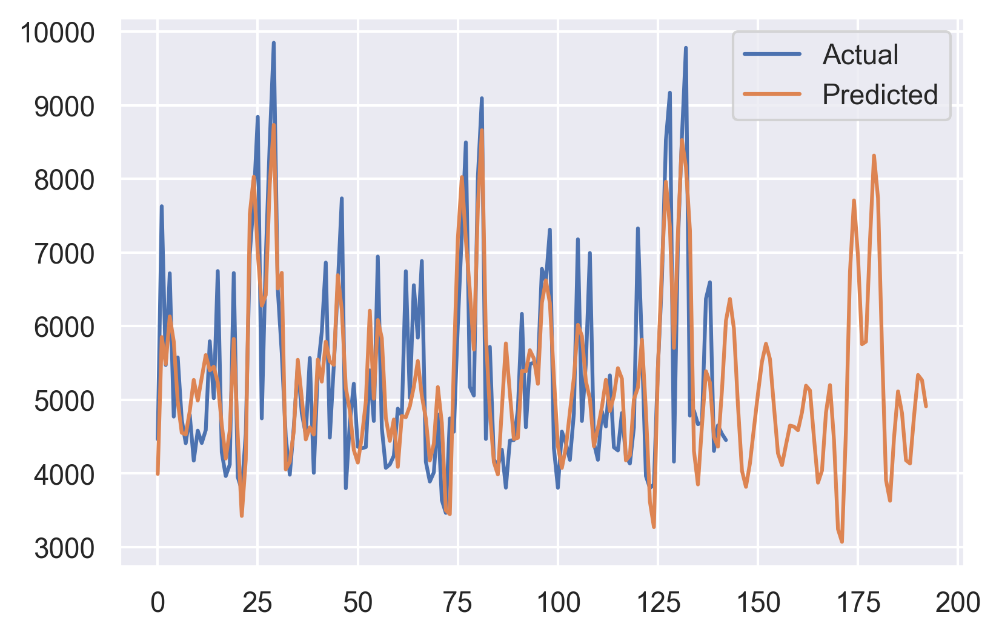

In [58]:
y_true = s1['y']
y_pred = forecast['yhat']

plt.plot(y_true, label='Actual')
plt.plot(y_pred, label='Predicted')
plt.legend()
plt.show()

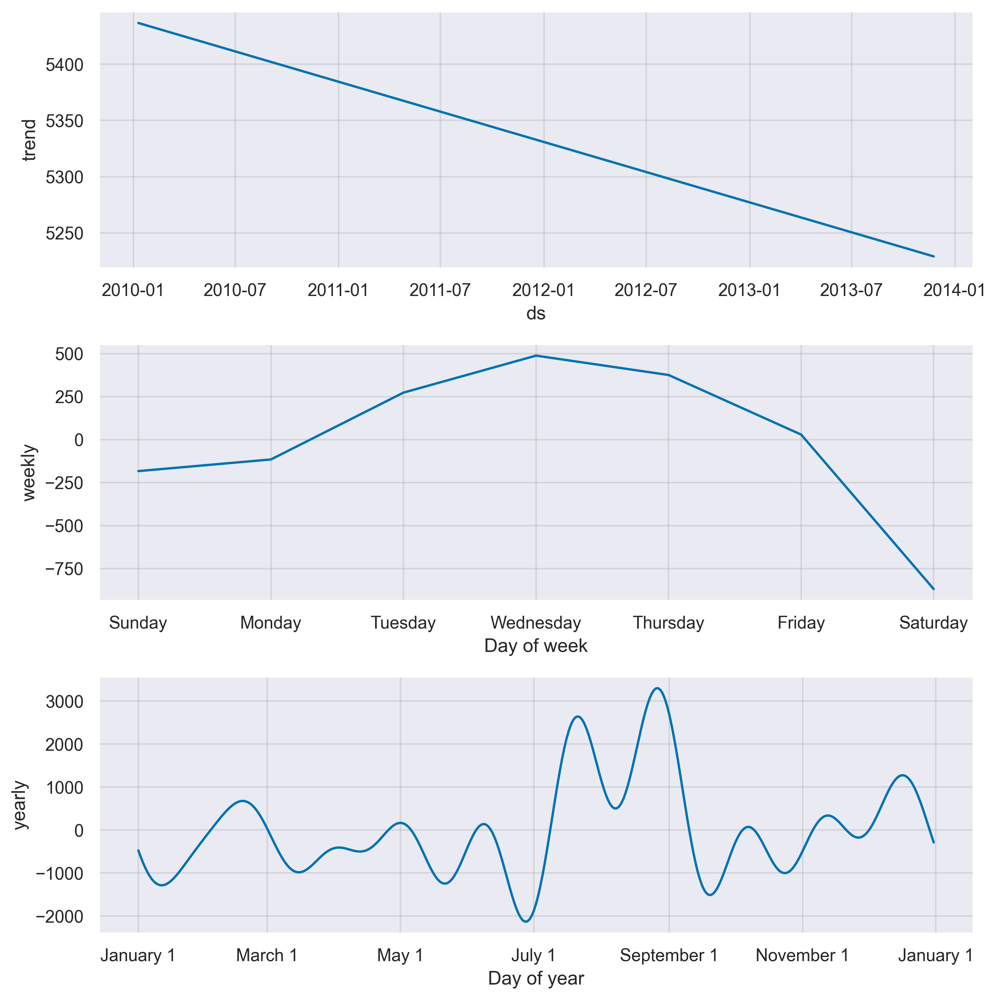

In [59]:
model.plot_components(forecast);

In [68]:
df_cv = cross_validation(model, initial='500 days', period='50 days', horizon = '100 days')
df_cv.head()

INFO:fbprophet:Making 10 forecasts with cutoffs between 2011-06-09 00:00:00 and 2012-09-01 00:00:00


  0%|          | 0/10 [00:00<?, ?it/s]

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2011-06-17,5031.279240,4097.635609,5940.017336,3636.83,2011-06-09
1,2011-06-24,3644.339924,2770.792689,4504.873600,3464.91,2011-06-09
2,2011-07-01,3225.575220,2285.873660,4175.241781,4748.28,2011-06-09
3,2011-07-10,5370.685761,4487.748549,6250.273567,4566.90,2011-06-09
4,2011-07-15,7038.395902,6211.139162,7936.575775,6024.35,2011-06-09


In [69]:
df_p = performance_metrics(df_cv)
df_p.head()

,horizon,mse,rmse,mae,mape,mdape,coverage
0,9 days,2.723946e+06,1650.438149,1219.247321,0.243139,0.163932,0.461538
1,10 days,2.741635e+06,1655.788346,1239.255978,0.247077,0.163932,0.461538
2,11 days,2.065161e+06,1437.066684,1120.842311,0.214292,0.158421,0.461538
3,12 days,1.902906e+06,1379.458521,1009.192831,0.198745,0.155338,0.538462
4,13 days,1.851638e+06,1360.749049,992.005772,0.194465,0.133484,0.615385


C:\Users\Anuj\anaconda3\lib\site-packages\fbprophet\plot.py:526: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt = df_none['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])
C:\Users\Anuj\anaconda3\lib\site-packages\fbprophet\plot.py:527: FutureWarning: casting timedelta64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.
  x_plt_h = df_h['horizon'].astype('timedelta64[ns]').astype(np.int64) / float(dt_conversions[i])


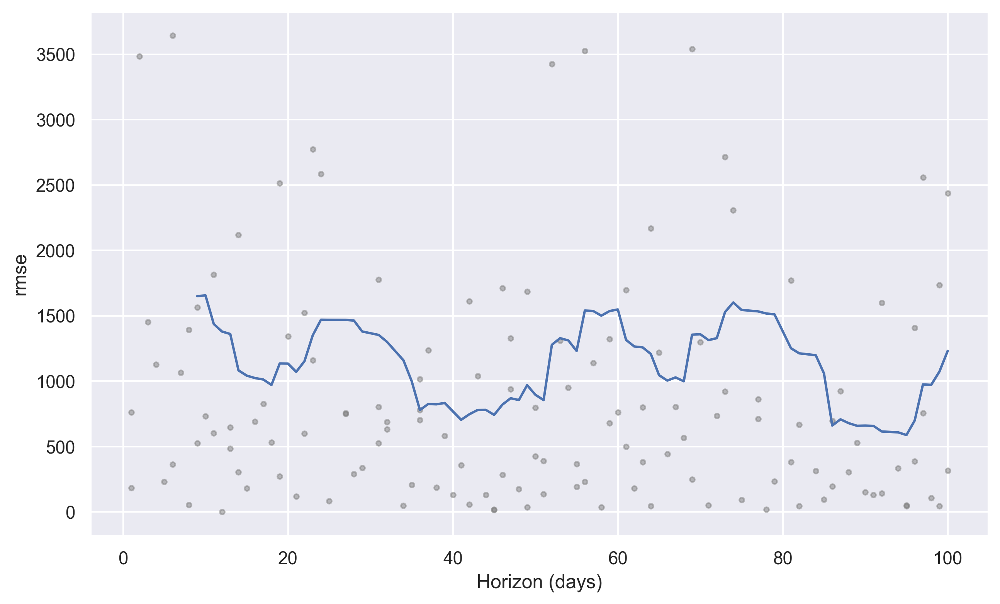

In [70]:
from fbprophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(df_cv, metric='rmse')

In [71]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 857.704851069226


#### Another code for RMSE

In [72]:
import math
y_actual = s1["y"].values
y_predicted = forecast["yhat"][:143]
mse = mean_squared_error(y_actual, y_predicted)
rmse = math.sqrt(mse)
print(rmse)

857.704851069226


In [157]:
df1.columns

Index(['Product', 'Sales'], dtype='object')

## Store 2 Forecasting

In [94]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date     Sales
143      2 2010-01-10   6110.94
144      2 2010-02-04  10621.89
145      2 2010-02-07   8215.18
146      2 2010-02-19   9342.58
147      2 2010-02-26   6710.08
     Store       Date    Sales
281      2 2012-10-08  9480.25
282      2 2012-10-19  6241.65
283      2 2012-10-26  6465.45
284      2 2012-11-05  5873.83
285      2 2012-12-10  5897.03


,ds,y
143,2010-01-10,6110.94
144,2010-02-04,10621.89
145,2010-02-07,8215.18
146,2010-02-19,9342.58
147,2010-02-26,6710.08


In [174]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


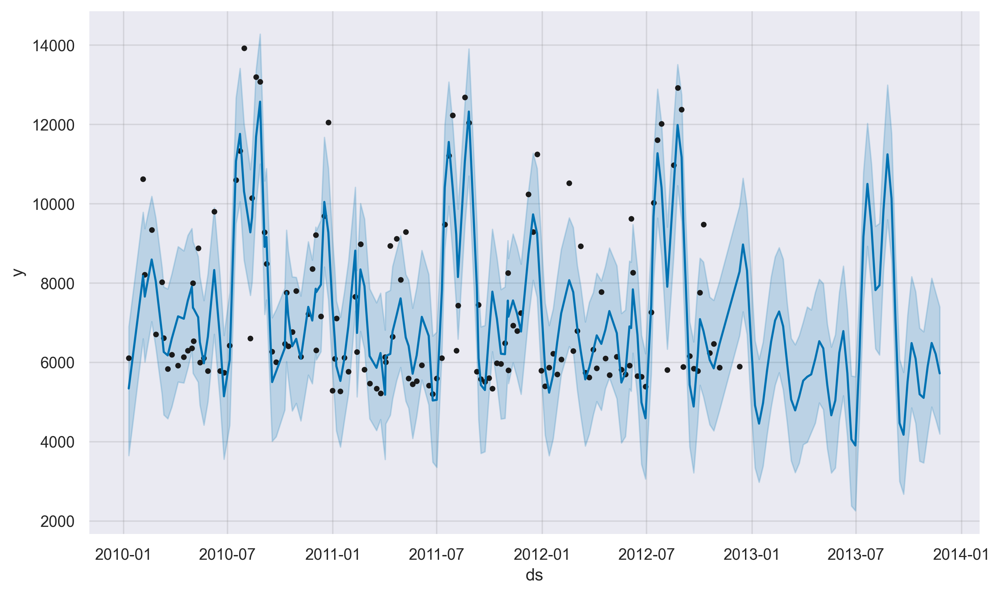

In [95]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

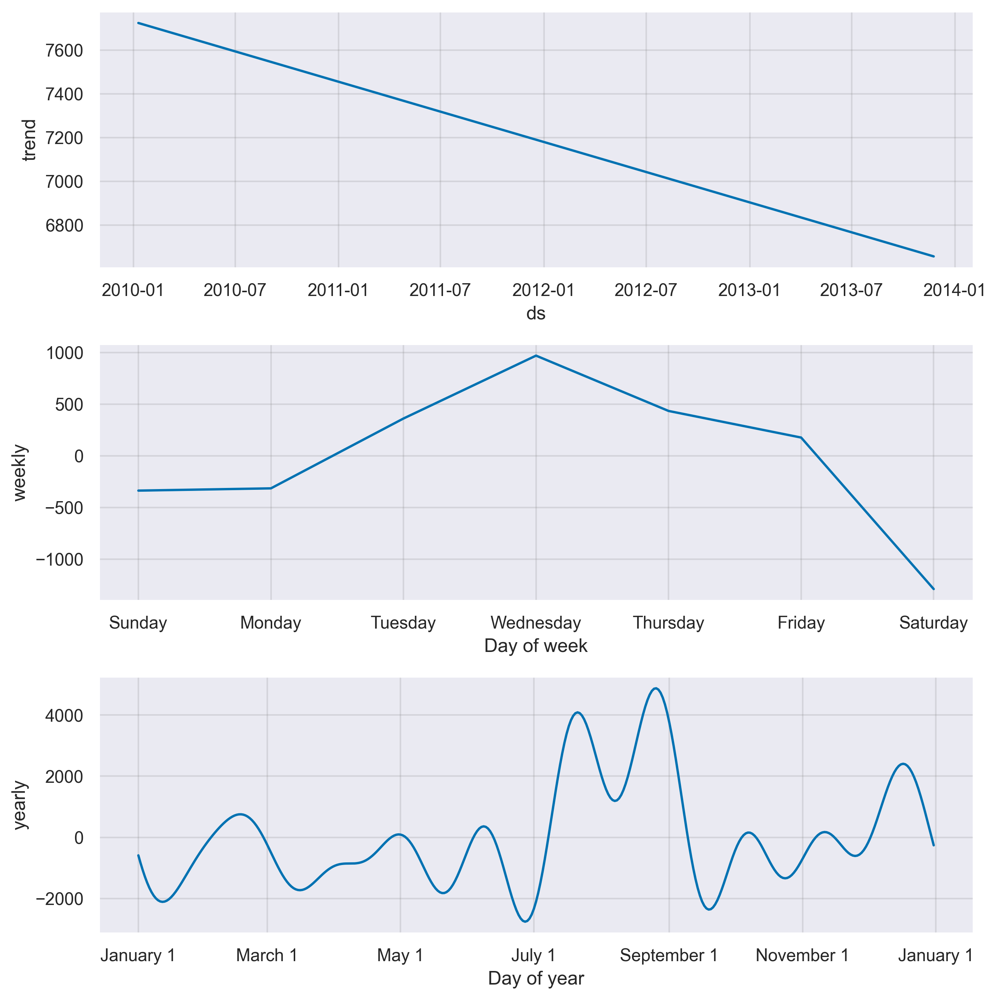

In [96]:
k = model.plot_components(forecast)

In [97]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 1262.1759528061157


## Store 3 Forecasting

In [98]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*2] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date    Sales
286      3 2010-01-10  1358.47
287      3 2010-02-04  2302.62
288      3 2010-02-07  1783.70
289      3 2010-02-19  1923.78
290      3 2010-02-26  1636.18
     Store       Date    Sales
424      3 2012-10-08  2940.68
425      3 2012-10-19  2113.95
426      3 2012-10-26  2061.00
427      3 2012-11-05  1869.34
428      3 2012-12-10  2055.04


,ds,y
286,2010-01-10,1358.47
287,2010-02-04,2302.62
288,2010-02-07,1783.70
289,2010-02-19,1923.78
290,2010-02-26,1636.18


In [178]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


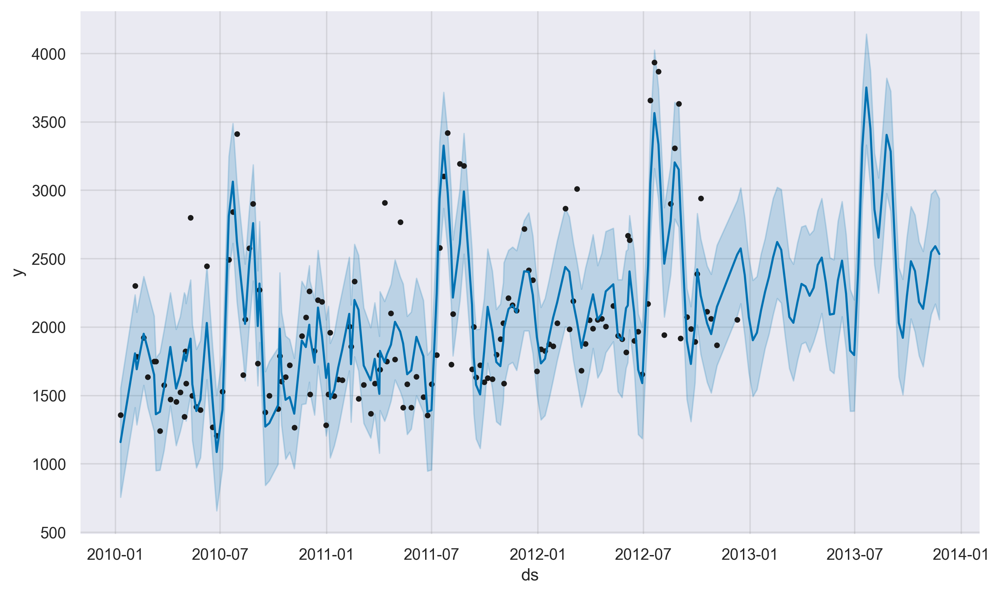

In [99]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

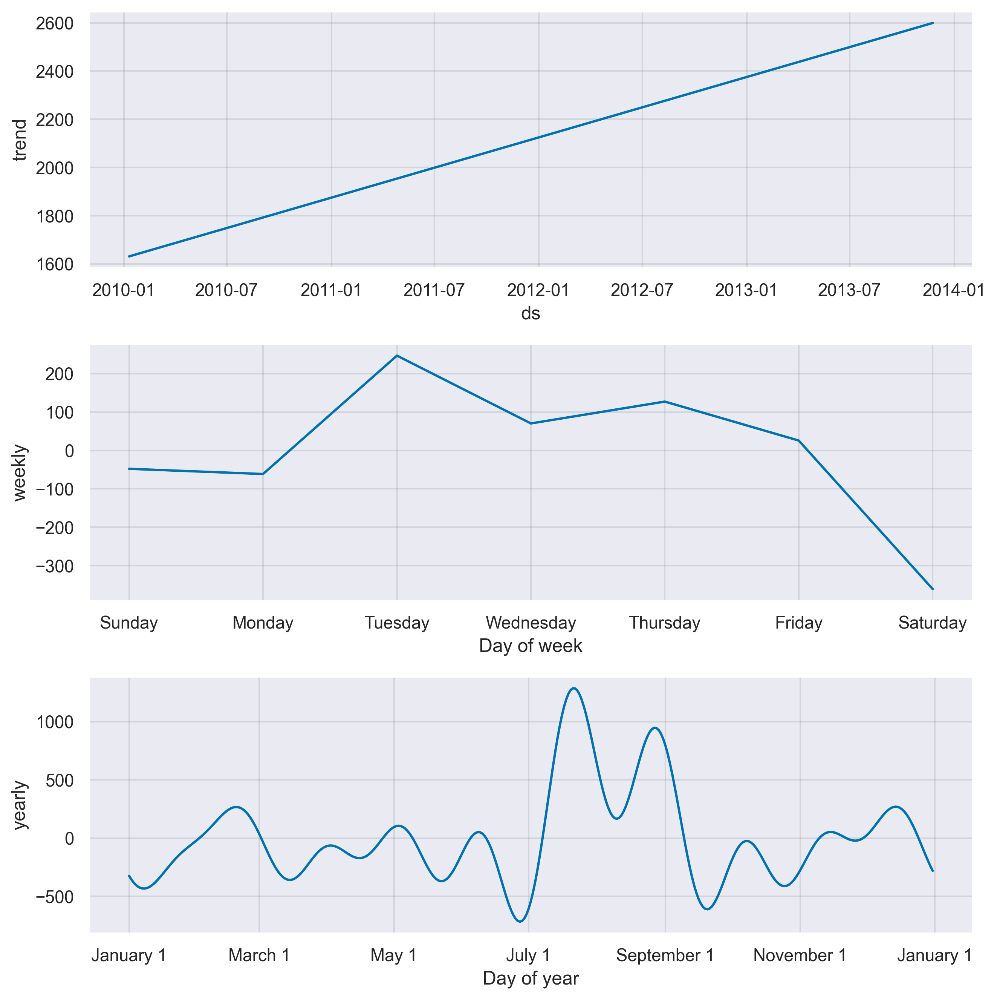

In [100]:
k = model.plot_components(forecast)

In [101]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 330.73600749354506


## Store 4 Forecasting

In [102]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*3] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date     Sales
429      4 2010-01-10   7620.84
430      4 2010-02-04  10654.40
431      4 2010-02-07   8658.73
432      4 2010-02-19   9398.31
433      4 2010-02-26   7676.44
     Store       Date     Sales
567      4 2012-10-08  15165.20
568      4 2012-10-19   8521.07
569      4 2012-10-26   8867.74
570      4 2012-11-05   7517.81
571      4 2012-12-10   8003.59


,ds,y
429,2010-01-10,7620.84
430,2010-02-04,10654.40
431,2010-02-07,8658.73
432,2010-02-19,9398.31
433,2010-02-26,7676.44


In [100]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


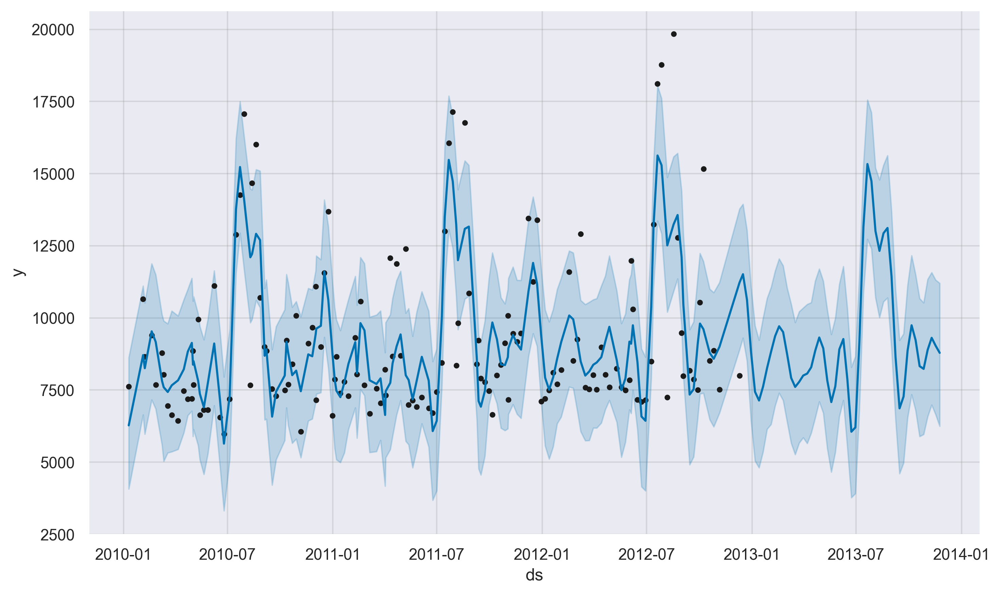

In [103]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

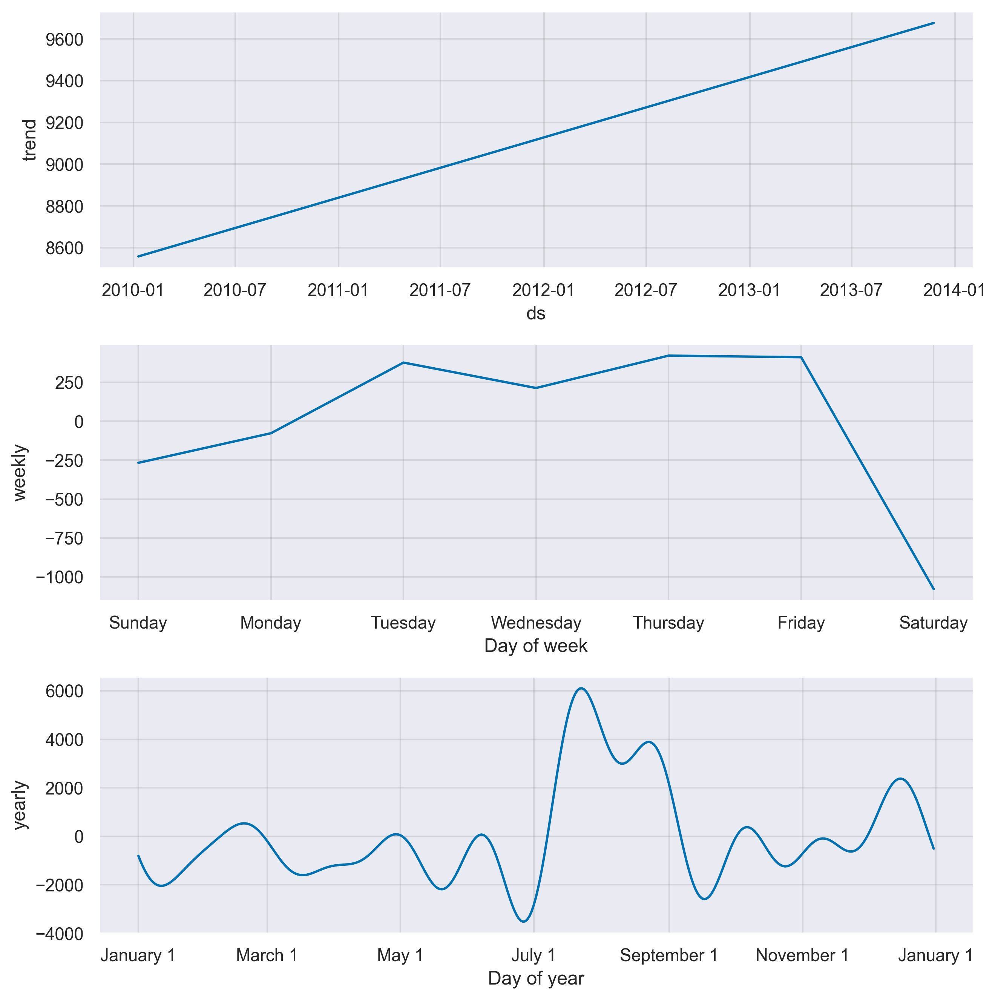

In [104]:
k = model.plot_components(forecast)

In [105]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 1828.1029711528731


## Store 5 Forecasting

In [106]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*4] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date    Sales
572      5 2010-01-10  1502.41
573      5 2010-02-04  2381.76
574      5 2010-02-07  1864.88
575      5 2010-02-19  1821.87
576      5 2010-02-26  1448.31
     Store       Date    Sales
710      5 2012-10-08  2091.28
711      5 2012-10-19  1597.49
712      5 2012-10-26  1713.40
713      5 2012-11-05  1560.98
714      5 2012-12-10  1610.47


,ds,y
572,2010-01-10,1502.41
573,2010-02-04,2381.76
574,2010-02-07,1864.88
575,2010-02-19,1821.87
576,2010-02-26,1448.31


In [105]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


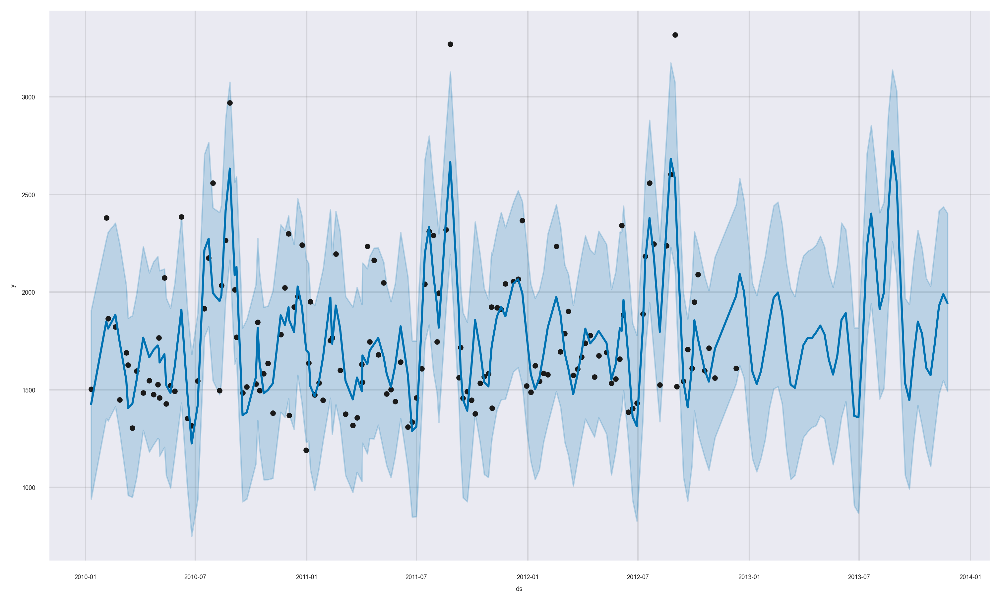

In [106]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

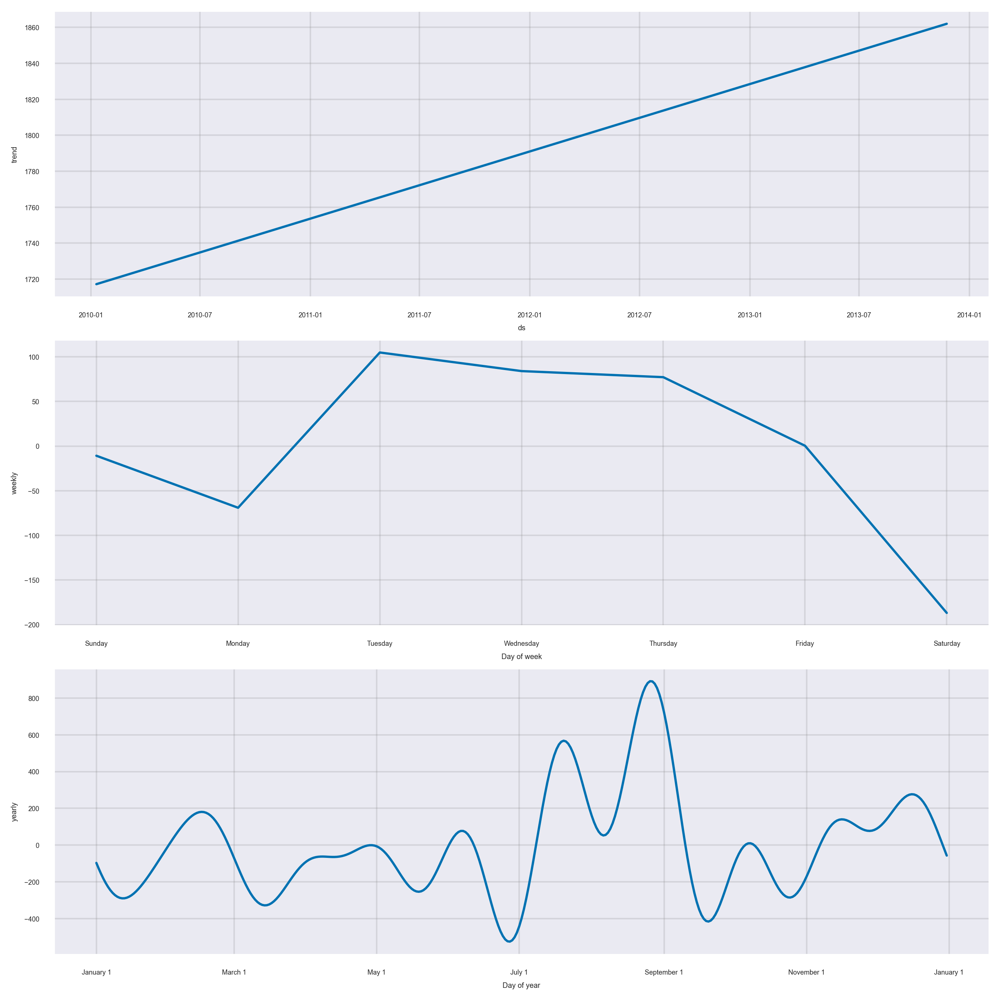

In [107]:
k = model.plot_components(forecast)

In [108]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 240.37075099104018


## Store 6 Forecasting

In [109]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*5] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date    Sales
715      6 2010-01-10  4403.11
716      6 2010-02-04  8427.25
717      6 2010-02-07  7659.48
718      6 2010-02-19  6386.51
719      6 2010-02-26  5056.15
     Store       Date    Sales
853      6 2012-10-08  8365.46
854      6 2012-10-19  5135.02
855      6 2012-10-26  5227.91
856      6 2012-11-05  4918.24
857      6 2012-12-10  4859.35


,ds,y
715,2010-01-10,4403.11
716,2010-02-04,8427.25
717,2010-02-07,7659.48
718,2010-02-19,6386.51
719,2010-02-26,5056.15


In [110]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


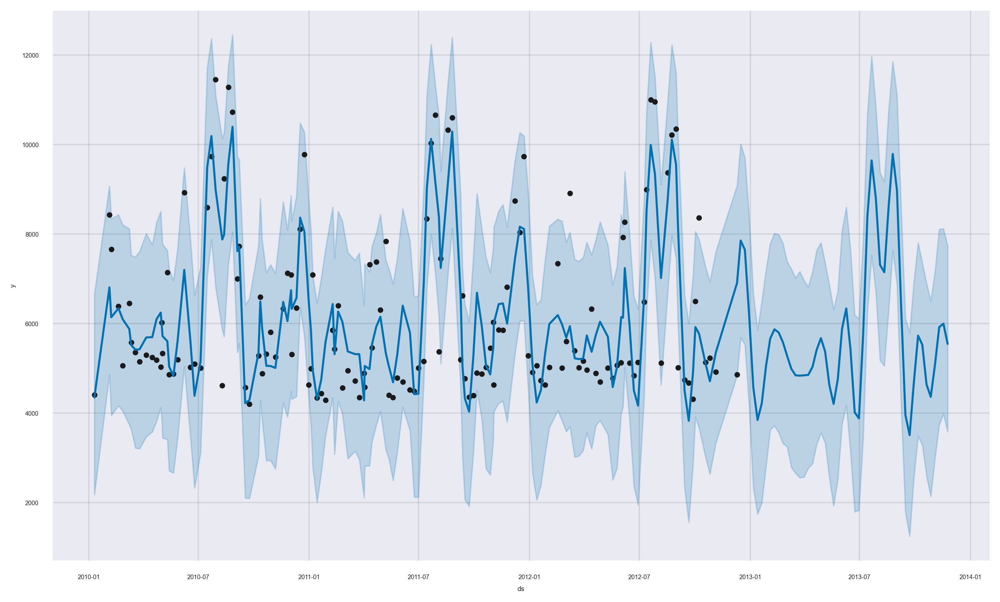

In [111]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

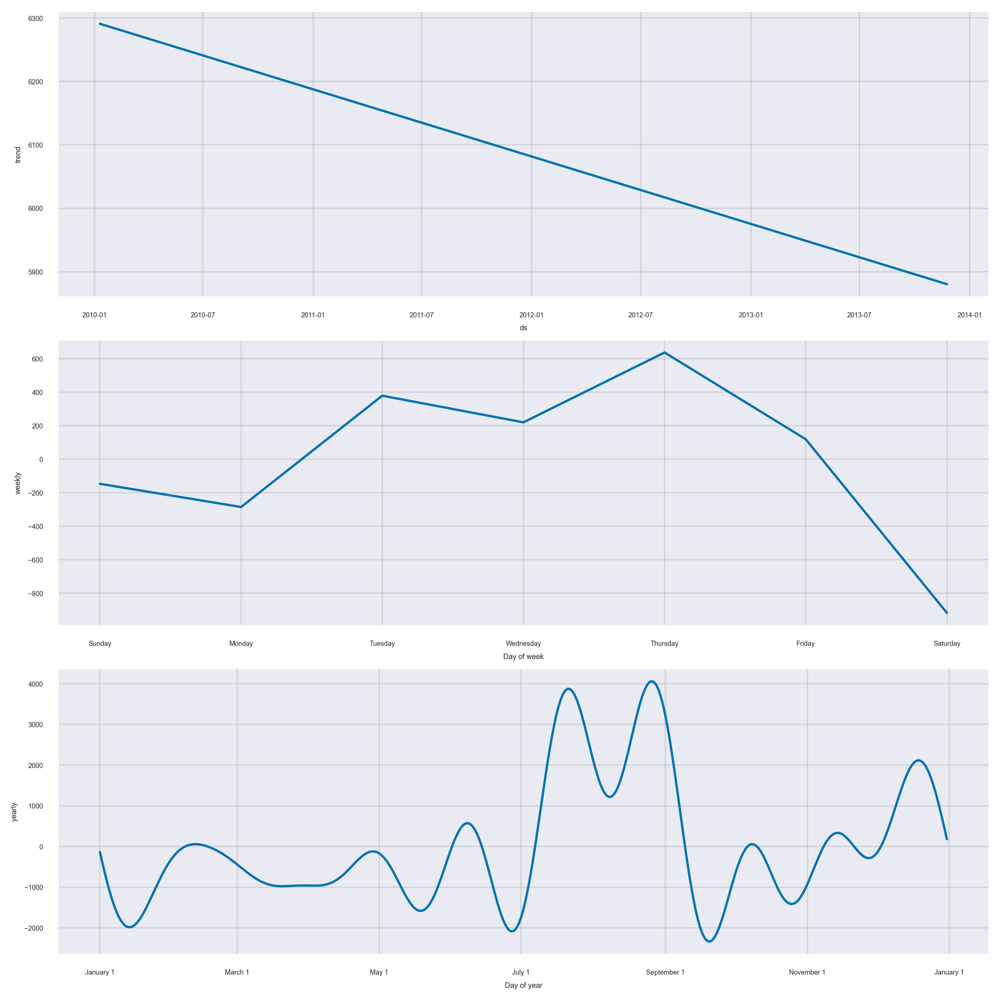

In [112]:
k = model.plot_components(forecast)

In [113]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 1103.0564876526098


## Store 7 Forecasting

In [114]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*6] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
     Store       Date    Sales
858      7 2010-01-10  2153.82
859      7 2010-02-04  3535.22
860      7 2010-02-07  3711.90
861      7 2010-02-19  2716.88
862      7 2010-02-26  2327.31
      Store       Date    Sales
996       7 2012-10-08  4144.70
997       7 2012-10-19  2167.95
998       7 2012-10-26  2373.82
999       7 2012-11-05  1901.11
1000      7 2012-12-10  2299.89


,ds,y
858,2010-01-10,2153.82
859,2010-02-04,3535.22
860,2010-02-07,3711.90
861,2010-02-19,2716.88
862,2010-02-26,2327.31


In [115]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


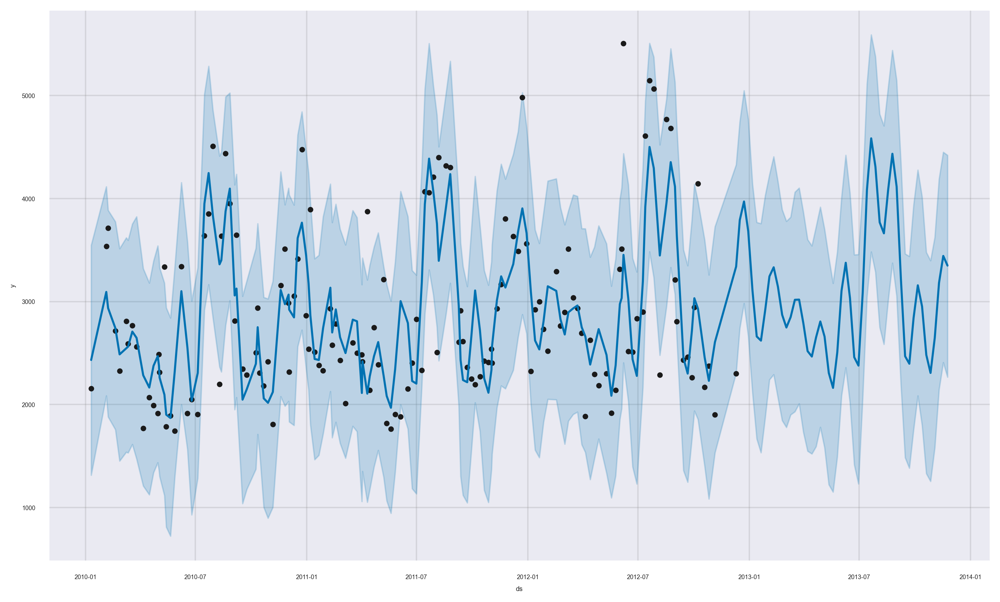

In [116]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

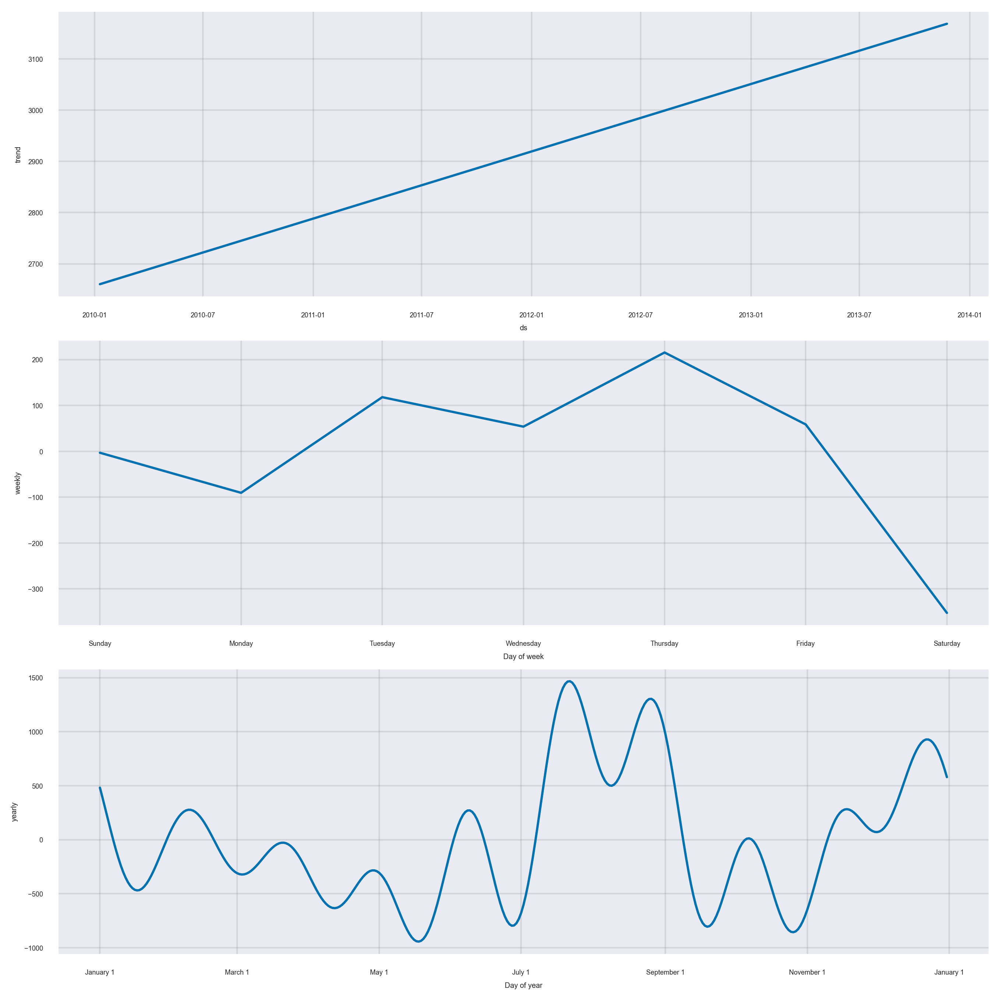

In [117]:
k = model.plot_components(forecast)

In [118]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 541.0310114118068


## Store 8 Forecasting

In [119]:
s1 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Store.value_counts())
s1.drop(s1.index[:143*7] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Store"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64
      Store       Date    Sales
1001      8 2010-01-10  3565.98
1002      8 2010-02-04  5271.29
1003      8 2010-02-07  3905.60
1004      8 2010-02-19  4242.77
1005      8 2010-02-26  3413.97
      Store       Date    Sales
1139      8 2012-10-08  5434.75
1140      8 2012-10-19  3337.59
1141      8 2012-10-26  3618.45
1142      8 2012-11-05  2945.41
1143      8 2012-12-10  3225.76


,ds,y
1001,2010-01-10,3565.98
1002,2010-02-04,5271.29
1003,2010-02-07,3905.60
1004,2010-02-19,4242.77
1005,2010-02-26,3413.97


In [120]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


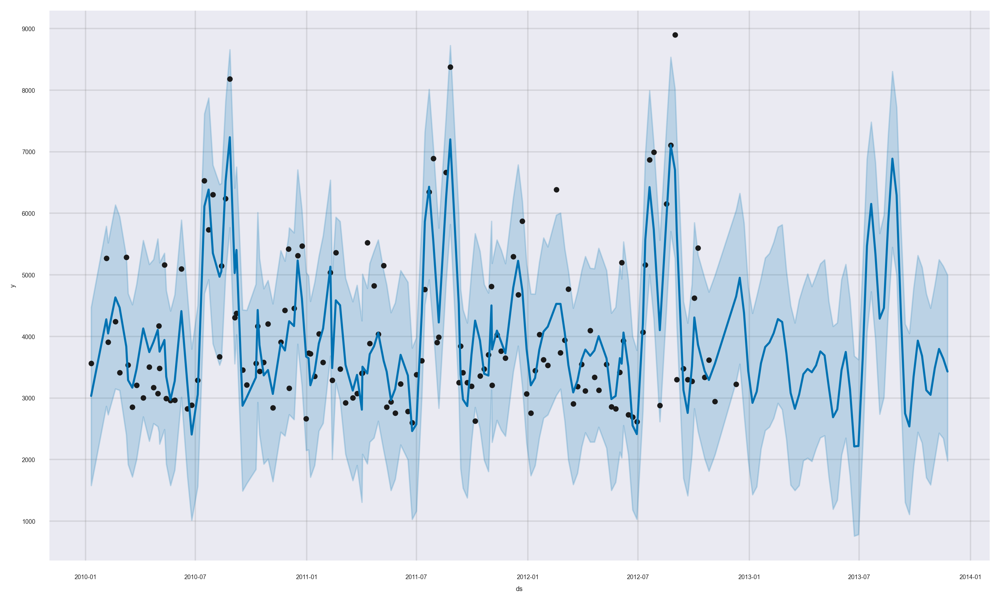

In [121]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

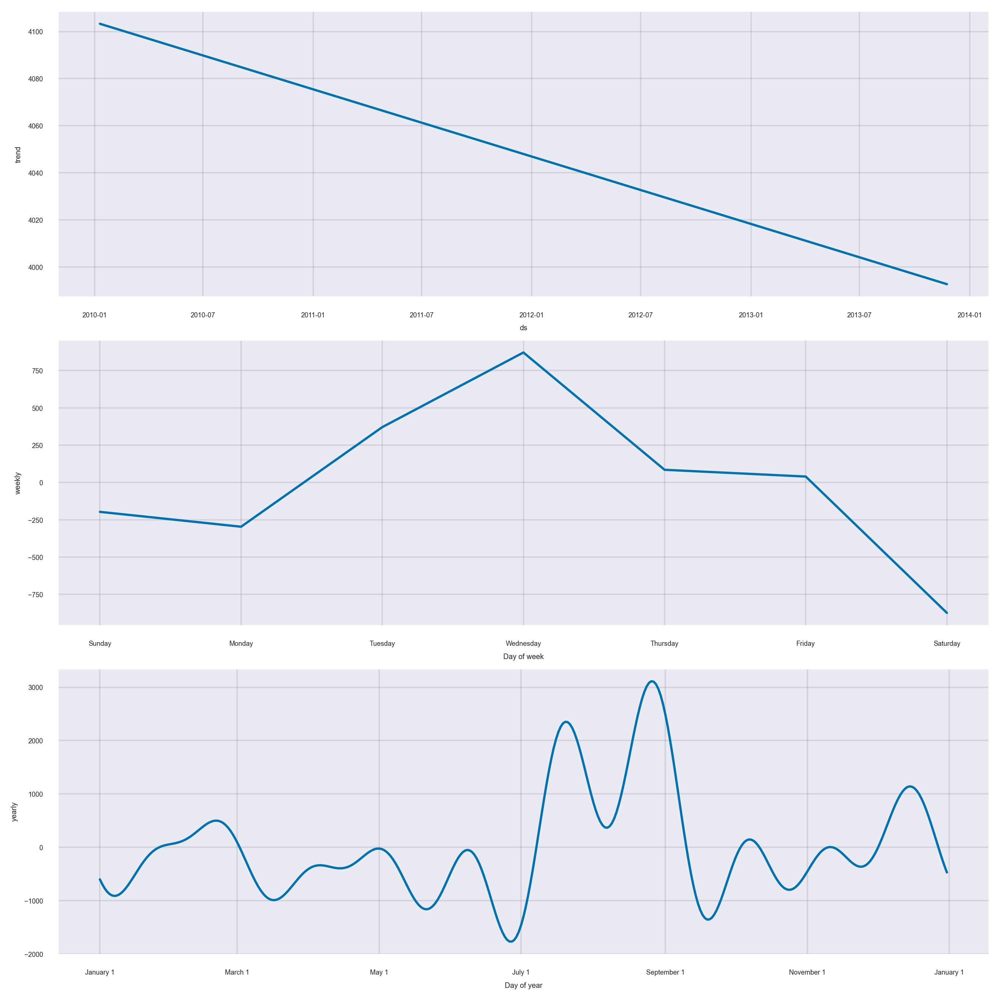

In [122]:
k = model.plot_components(forecast)

In [123]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 751.8577958872163


## Store 10 Forecasting

In [124]:
s10 = df.groupby(["Store", "Date"]).agg({"Sales":"sum"})
s10.reset_index(inplace=True)
print(s10.Store.value_counts())

s10.drop(s10.index[:-143] , axis=0, inplace=True)
s10.head()

1     143
2     143
3     143
4     143
5     143
6     143
7     143
8     143
10    143
Name: Store, dtype: int64


,Store,Date,Sales
1144,10,2010-01-10,9093.45
1145,10,2010-02-04,17630.06
1146,10,2010-02-07,12778.23
1147,10,2010-02-19,12291.25
1148,10,2010-02-26,11218.79


In [125]:
s10.drop(["Store"], axis=1, inplace=True)
s10.columns = ["ds", "y"]
s10.head()

,ds,y
1144,2010-01-10,9093.45
1145,2010-02-04,17630.06
1146,2010-02-07,12778.23
1147,2010-02-19,12291.25
1148,2010-02-26,11218.79


In [126]:
fig = px.line(s10, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


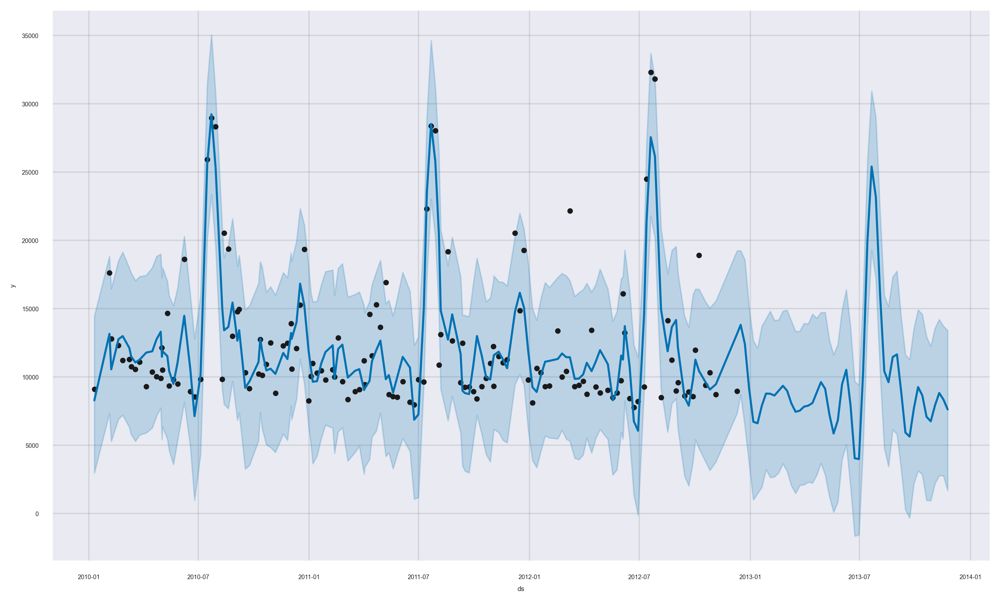

In [127]:
model = Prophet()
model.fit(s10) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

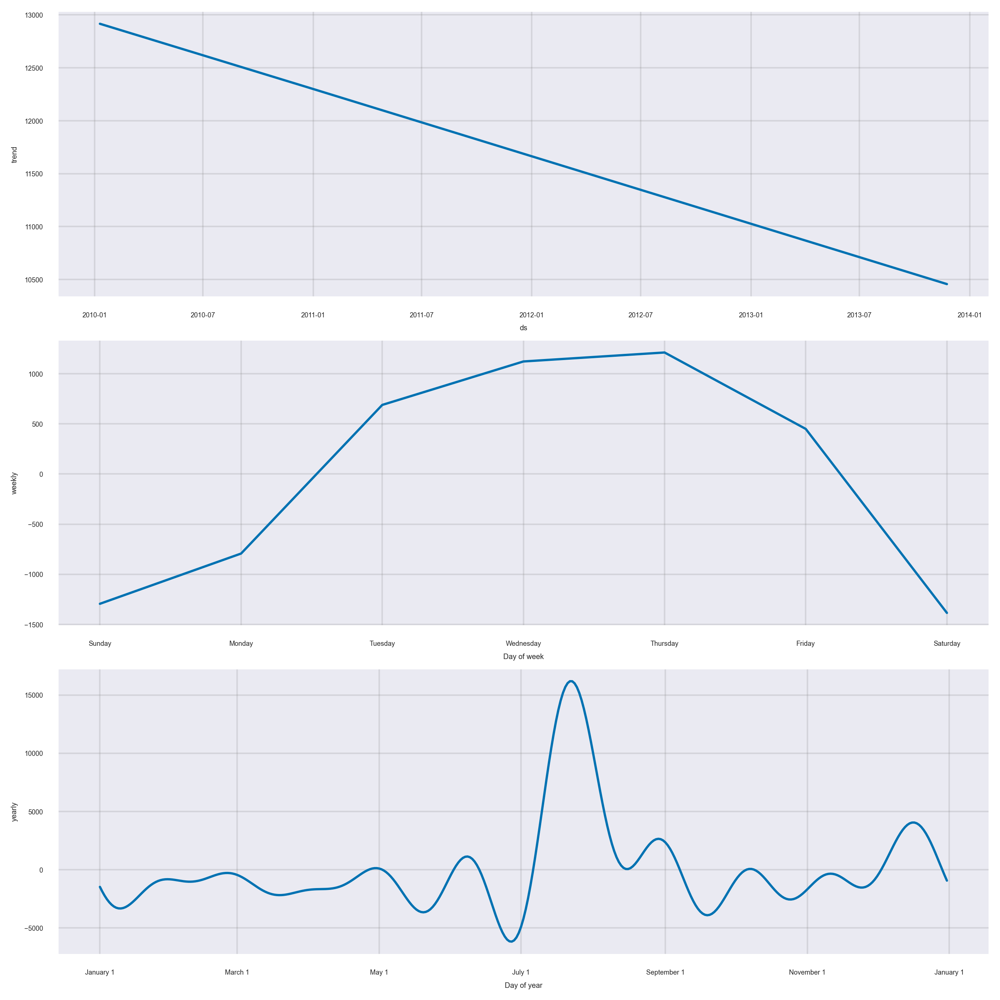

In [128]:
k = model.plot_components(forecast)

In [129]:
metric_df = forecast.set_index('ds')[['yhat']].join(s10.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 2880.7837442640625


## Product 1 Forecasting

In [130]:
s1 = df.groupby(["Product", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Product.value_counts())
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Product"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1    143
2    143
3    143
Name: Product, dtype: int64
   Product       Date     Sales
0        1 2010-01-10  11598.39
1        1 2010-02-04  33636.33
2        1 2010-02-07   9920.07
3        1 2010-02-19  22715.57
4        1 2010-02-26  12680.13
     Product       Date     Sales
138        1 2012-10-08   9165.66
139        1 2012-10-19  14671.65
140        1 2012-10-26  17243.31
141        1 2012-11-05  11365.47
142        1 2012-12-10  13506.71


,ds,y
0,2010-01-10,11598.39
1,2010-02-04,33636.33
2,2010-02-07,9920.07
3,2010-02-19,22715.57
4,2010-02-26,12680.13


In [131]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


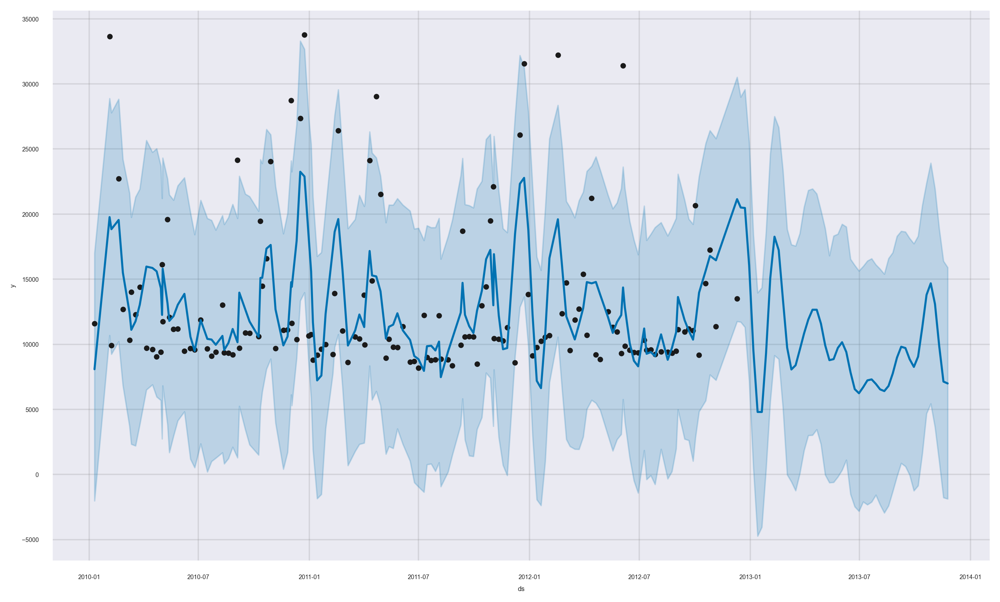

In [132]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

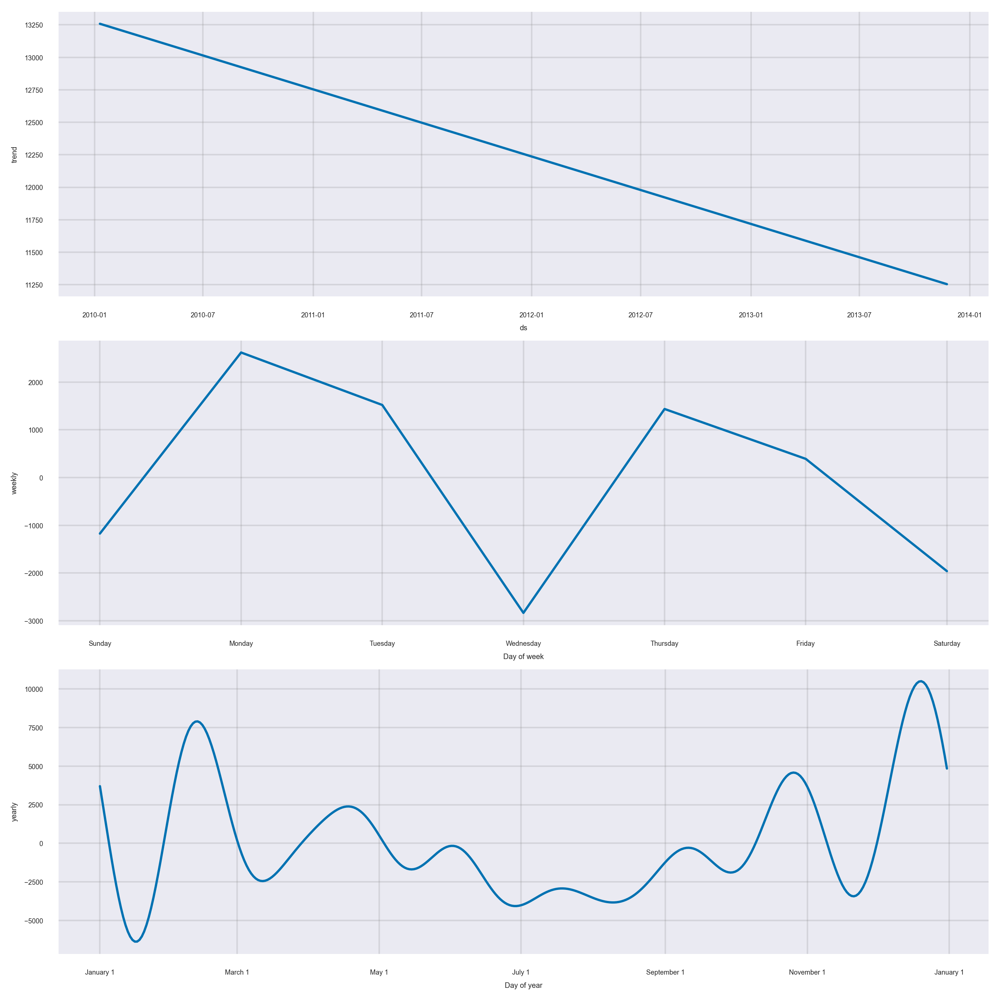

In [133]:
k = model.plot_components(forecast)

In [134]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 4701.5908273806435


## Product 2 Forecasting

In [135]:
s1 = df.groupby(["Product", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Product.value_counts())
s1.drop(s1.index[:143] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Product"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1    143
2    143
3    143
Name: Product, dtype: int64
     Product       Date     Sales
143        2 2010-01-10  17161.35
144        2 2010-02-04  22303.62
145        2 2010-02-07  22560.26
146        2 2010-02-19  18473.16
147        2 2010-02-26  17706.44
     Product       Date     Sales
281        2 2012-10-08  18167.01
282        2 2012-10-19  16831.92
283        2 2012-10-26  16545.33
284        2 2012-11-05  16755.03
285        2 2012-12-10  16188.84


,ds,y
143,2010-01-10,17161.35
144,2010-02-04,22303.62
145,2010-02-07,22560.26
146,2010-02-19,18473.16
147,2010-02-26,17706.44


In [136]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


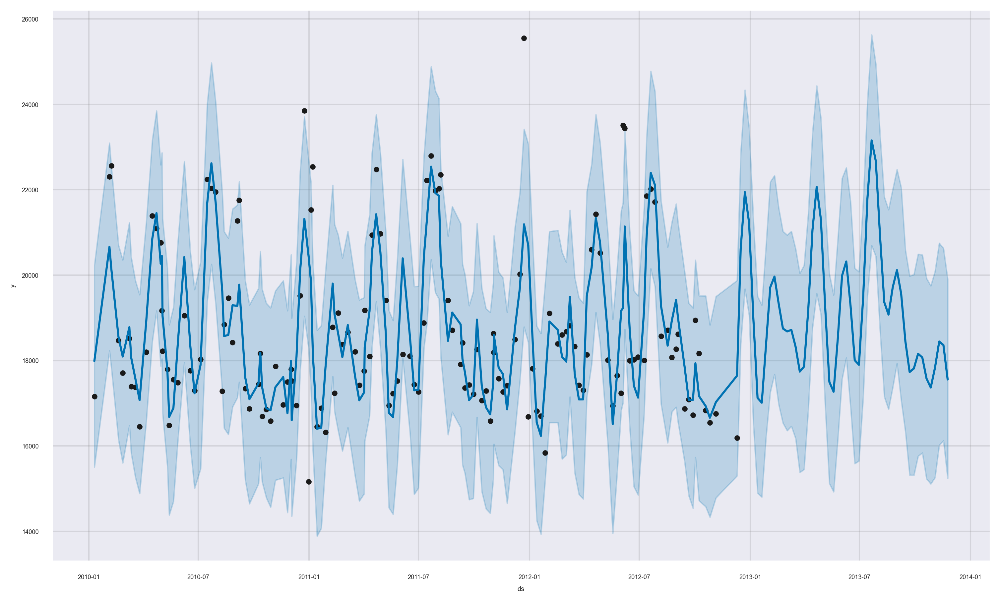

In [137]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

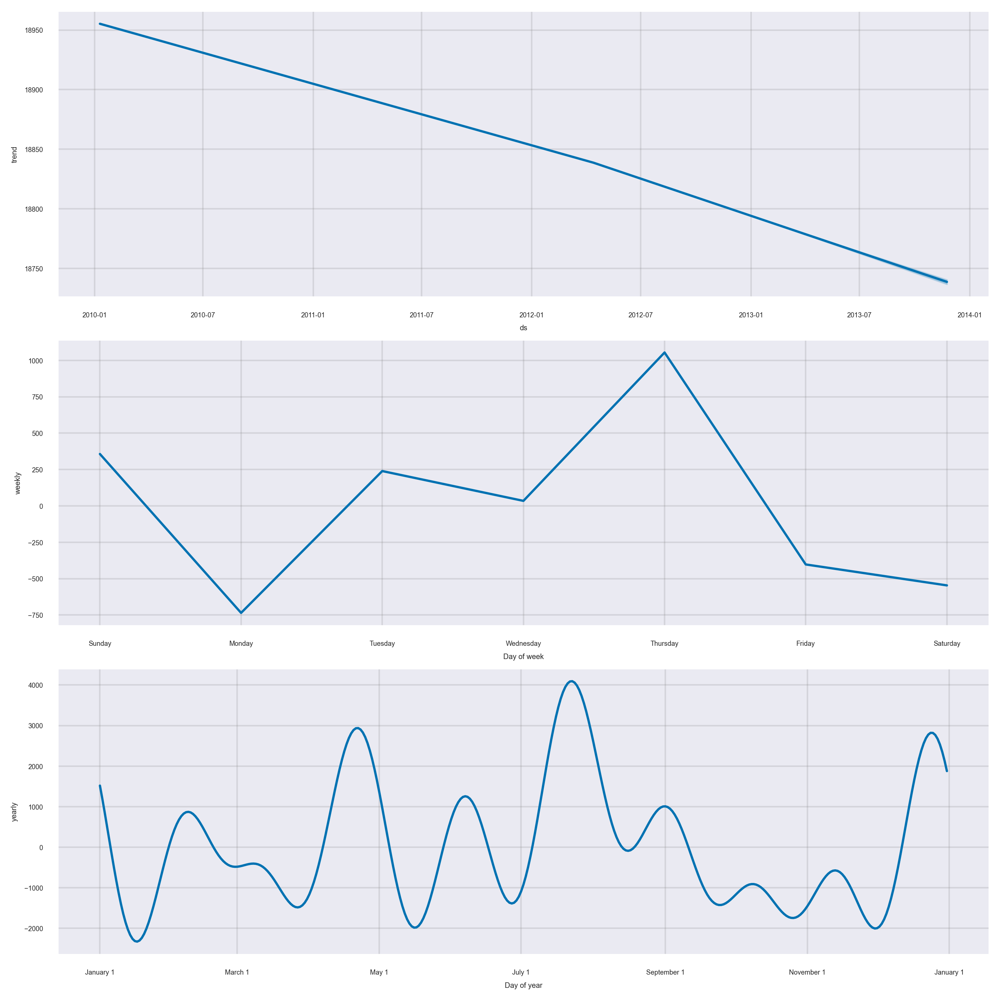

In [138]:
k = model.plot_components(forecast)

In [139]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 1203.8213009234773


## Product 3 Forecasting

In [140]:
s1 = df.groupby(["Product", "Date"]).agg({"Sales":"sum"})
s1.reset_index(inplace=True)
print(s1.Product.value_counts())
s1.drop(s1.index[:143*2] , axis=0, inplace=True)
s1.drop(s1.index[143:] , axis=0, inplace=True)
print(s1.head())
print(s1.tail())
s1.drop(["Product"], axis=1, inplace=True)
s1.columns = ["ds", "y"]
s1.head()

1    143
2    143
3    143
Name: Product, dtype: int64
     Product       Date     Sales
286        3 2010-01-10  11514.24
287        3 2010-02-04  12513.74
288        3 2010-02-07  21570.00
289        3 2010-02-19  13653.17
290        3 2010-02-26  13873.06
     Product       Date     Sales
424        3 2012-10-08  45797.09
425        3 2012-10-19  11314.34
426        3 2012-10-26  11514.24
427        3 2012-11-05  11714.14
428        3 2012-12-10  11654.17


,ds,y
286,2010-01-10,11514.24
287,2010-02-04,12513.74
288,2010-02-07,21570.00
289,2010-02-19,13653.17
290,2010-02-26,13873.06


In [141]:
fig = px.line(s1, x='ds', y='y')
fig.update_layout(title_text='Time Series of weekly sales')
fig.show()

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


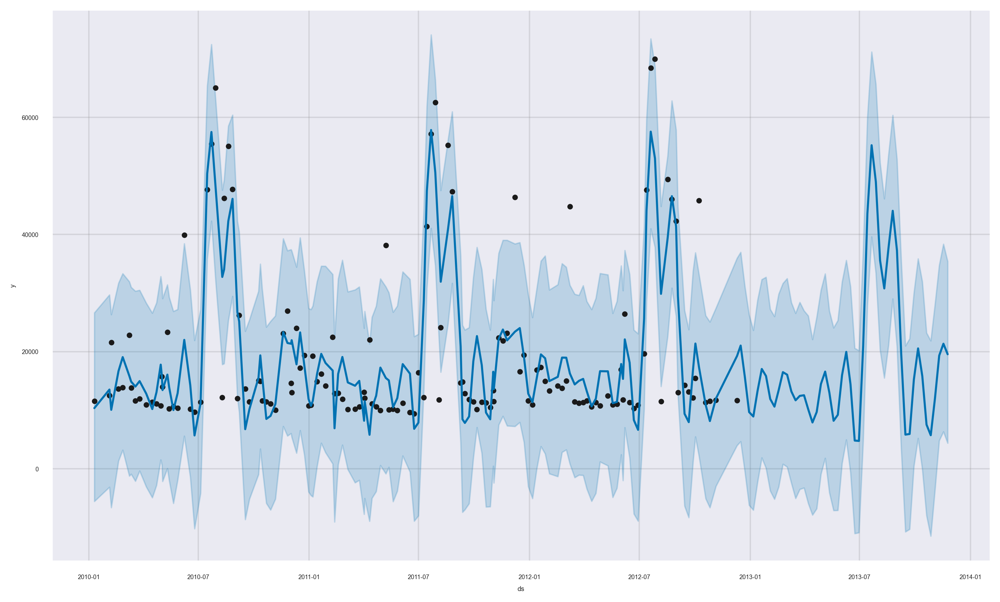

In [142]:
model = Prophet()
model.fit(s1) 
future_dates = model.make_future_dataframe(periods = 50, freq='W')
forecast = model.predict(future_dates)

k = model.plot(forecast)

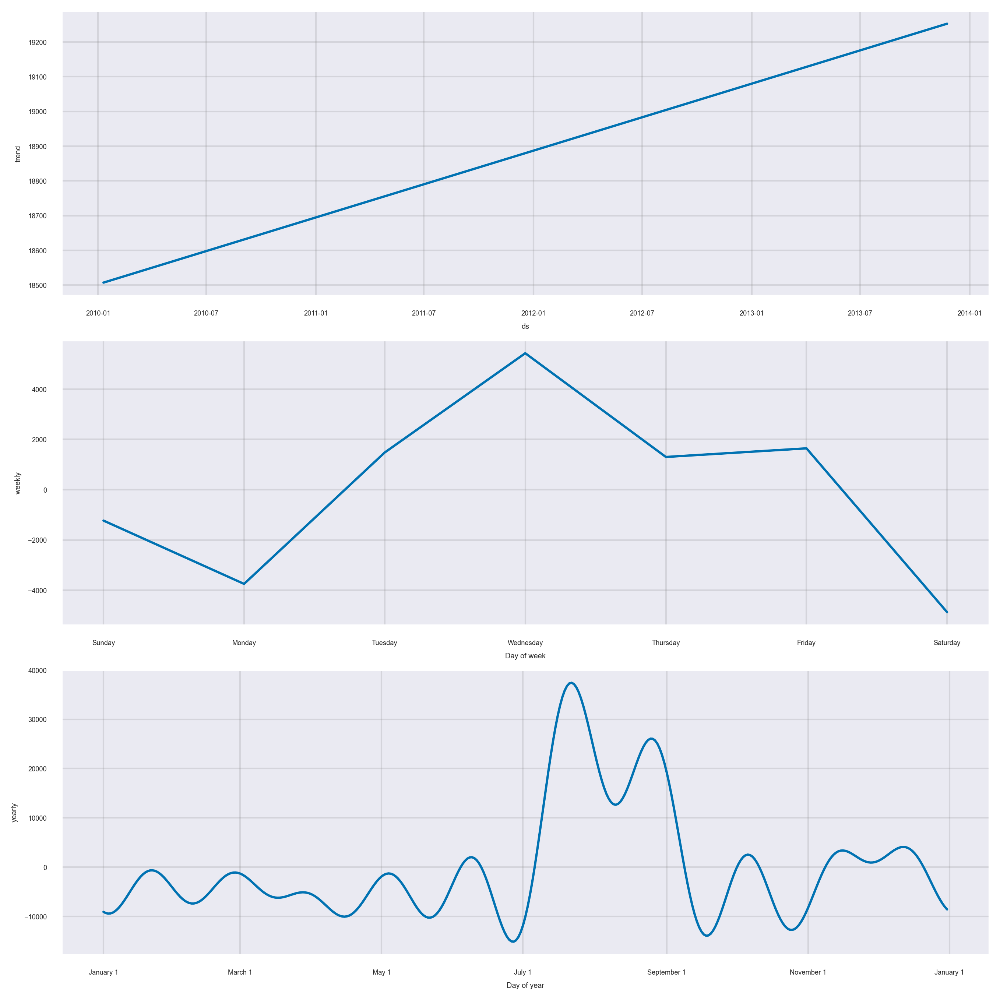

In [143]:
k = model.plot_components(forecast)

In [144]:
metric_df = forecast.set_index('ds')[['yhat']].join(s1.set_index('ds').y).reset_index()
metric_df.dropna(inplace=True)
error = mean_squared_error(metric_df.y, metric_df.yhat)
print('The RMSE is {}'. format(sqrt(error)))

The RMSE is 8062.840701427726


**Observations:**

• FbProphet model RMSE values is not so high and seems it's perfect model for this dataset.

# Why not SARIMAX?

In [76]:
df1 = df.groupby(['Product','Date']).agg({'Sales':'sum'})
df1.reset_index(inplace=True)
df1['Date'] = pd.to_datetime(df1['Date'])
df1.set_index('Date', inplace=True)
df1.Product.value_counts()

1    143
2    143
3    143
Name: Product, dtype: int64

## Product 1

In [83]:
### Testing For Stationarity

from statsmodels.tsa.stattools import adfuller

#Ho: It is non stationary
#H1: It is stationary

def adfuller_test(sales):
    result=adfuller(sales)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

In [84]:
adfuller_test(df1['Sales'].iloc[:143])

ADF Test Statistic : -10.394143201825276
p-value : 1.9853825081349474e-18
#Lags Used : 0
Number of Observations Used : 142
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


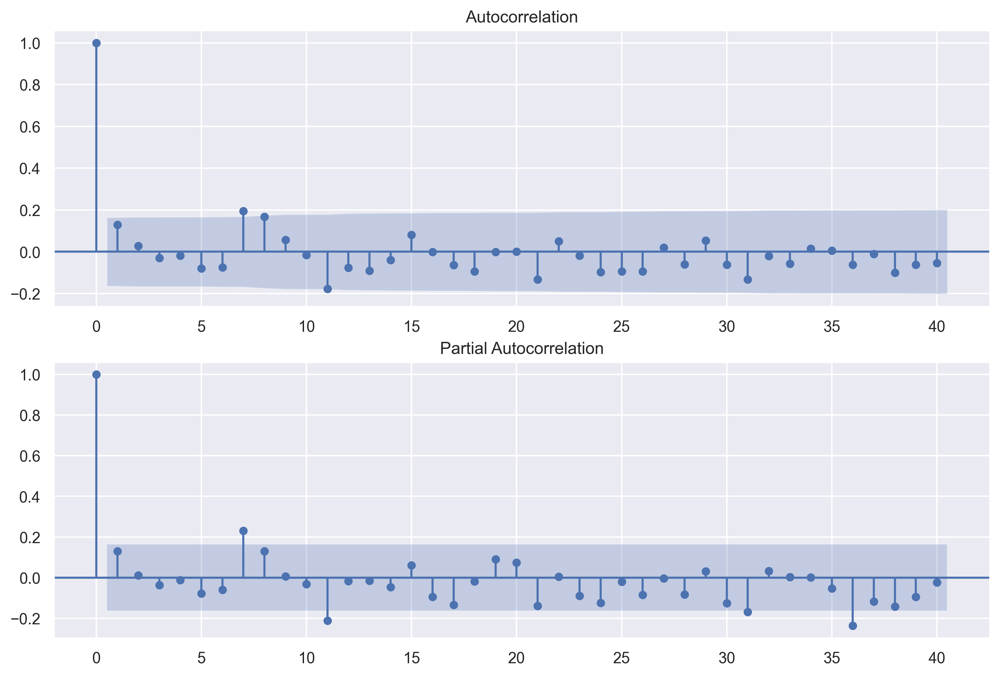

In [87]:

from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = plot_acf(df1['Sales'].iloc[:143],lags=40,ax=ax1)
ax2 = fig.add_subplot(212)
fig = plot_pacf(df1['Sales'].iloc[:143],lags=40,ax=ax2)

C:\Users\Anuj\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:581: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
C:\Users\Anuj\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:581: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
C:\Users\Anuj\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:376: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  warnings.warn('No supported index is available.'


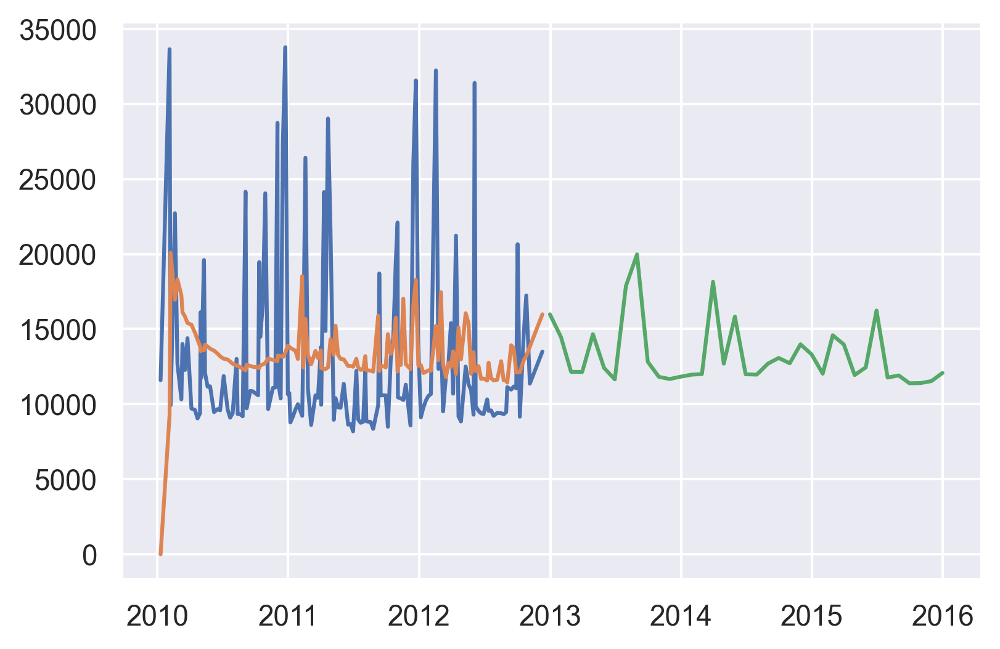

In [91]:
model = SARIMAX(df1.iloc[143*0:143*1].Sales, order = (1, 0, 1), seasonal_order =(1, 0, 1, 52))
result = model.fit()
pred = result.predict(start = 0, end = (len(df1.iloc[143*0:143*1])-1))
forecast =result.predict(start=len(df1.iloc[143*0:143*1])-1,end=len(df1.iloc[143*0:143*1])+35)
daterng=pd.date_range(start='2012-12-10',end='2016-01-10',freq='M')

plt.plot(df1.iloc[143*0:143*1].index, df1.iloc[143*0:143*1].Sales)
plt.plot(df1.iloc[143*0:143*1].index, pred)
plt.plot(daterng,forecast)

In [93]:
import math
y_actual = df1.iloc[143*0:143*1].Sales
y_predicted = pred
mse = mean_squared_error(y_actual, y_predicted)
rmse = math.sqrt(mse)
print(rmse)

6018.964420175865


**Observations:**

• RMSE is significantly high and hence SARIMAX is not perfect for our dataset.

• Hence FbProphet is best model for our dataset.